In [1]:
# Setup the library
import pyrogue as pr
import os, sys
import matplotlib.pyplot as plt
import time
import numpy as np
import math

top_level=f'{os.getcwd()}/../'
pr.addLibraryPath( f'{top_level}/scripts' )
import setupLibPaths
import epix_hr_single_10k
import ePixViewer.Cameras as cameras


In [2]:
# Create and start the root class
root = epix_hr_single_10k.RootLCLSIITiming(
    top_level   = top_level,
    sim         = False,
    dev         = '/dev/datadev_1',
    asicVersion = 3
)
root.start()

Start: Started zmqServer on ports 9099-9101
    To start a gui: python -m pyrogue gui --server='localhost:9099'
    To use a virtual client: client = pyrogue.interfaces.VirtualClient(addr='localhost', port=9099)


In [3]:
# Create useful pointers
AxiVersion = root.Core.AxiVersion
print ( '###################################################')
print ( '#             Firmware Version                    #')
print ( '###################################################')
AxiVersion.printStatus()
print ( '###################################################')

###################################################
#             Firmware Version                    #
###################################################
Path         = ePixHr10kT.Core.AxiVersion
FwVersion    = 0x3010000
UpTime       = 7 days, 23:10:28
GitHash      = 0x91b9a02f0d07162a78f04638906d35cf1ed23caf
XilinxDnaId  = 0x400200010139f5e11ce12205
FwTarget     = EpixHr10kTLclsIITiming
BuildEnv     = Vivado v2022.1
BuildServer  = rdsrv304 (Ubuntu 20.04.5 LTS)
BuildDate    = Fri 30 Sep 2022 01:25:56 PM PDT
Builder      = ddoering
###################################################


In [4]:
#Initialze the camera
#[routine, asic0, asic1, asic2, asic3]'
root.EpixHR.InitASIC([2,0,0,1,0])
#points to the ASIC device under test
ASIC = root.EpixHR.Hr10kTAsic2
root.EpixHR.BatcherEventBuilder0.Blowoff.set(True)
root.EpixHR.BatcherEventBuilder1.Blowoff.set(False)
root.EpixHR.BatcherEventBuilder2.Blowoff.set(True)

Rysync ASIC started
Init ASIC script started
Loading MMCM configuration
/u1/ddoering/localGitAtrdsrv304/epix-hr-single-10k/software/notebooks/..//yml/ePixHr10kT_MMCM_320MHz.yml
Completed
Loading supply configuration
/u1/ddoering/localGitAtrdsrv304/epix-hr-single-10k/software/notebooks/..//yml/ePixHr10kT_PowerSupply_Enable.yml
Loading register control (waveforms) configuration
/u1/ddoering/localGitAtrdsrv304/epix-hr-single-10k/software/notebooks/..//yml/ePixHr10kT_RegisterControl_150us_320MHz.yml
Loading packet registers
Disabling packet lanes for ASIC 0
Disabling packet lanes for ASIC 1
Disabling packet lanes for ASIC 3
/u1/ddoering/localGitAtrdsrv304/epix-hr-single-10k/software/notebooks/..//yml/ePixHr10kT_PacketRegisters.yml
Taking asic off of reset
Loading ASIC and timing configuration
Loading  /u1/ddoering/localGitAtrdsrv304/epix-hr-single-10k/software/notebooks/..//yml/ePixHr10kT_PLLBypass_248MHz_ASIC_2.yml
Command executed :  <class 'pyrogue._Command.BaseCommand'> - ePixHr10kT.Ep

In [5]:
def readPixelConfig(ASIC, x, y):
    ASIC.CmdPrepForRead() #0000
    ASIC.PrepareMultiConfig() #8000
    bankToWrite = int(y/48);
    if (bankToWrite == 0):
     colToWrite = 0x700 + y%48;
    elif (bankToWrite == 1):
     colToWrite = 0x680 + y%48;
    elif (bankToWrite == 2):
     colToWrite = 0x580 + y%48;
    elif (bankToWrite == 3):
     colToWrite = 0x380 + y%48;
    else:
     print('unexpected bank number')
    ASIC.RowCounter.set(x) #6011
    ASIC.ColCounter.set(colToWrite) #6013
    readBack = ASIC.WritePixelData.get() #5000
    ASIC.CmdPrepForRead() #0000
    return readBack

def writedPixelConfig(ASIC, x, y, value):
    ASIC.CmdPrepForRead() #0000
    ASIC.PrepareMultiConfig() #8000
    bankToWrite = int(y/48);
    if (bankToWrite == 0):
     colToWrite = 0x700 + y%48;
    elif (bankToWrite == 1):
     colToWrite = 0x680 + y%48;
    elif (bankToWrite == 2):
     colToWrite = 0x580 + y%48;
    elif (bankToWrite == 3):
     colToWrite = 0x380 + y%48;
    else:
     print('unexpected bank number')
    ASIC.RowCounter.set(x) #6011
    ASIC.ColCounter.set(colToWrite) #6013
    readBack = ASIC.WritePixelData.set(value) #5000
    ASIC.CmdPrepForRead() #0000
    return readBack

In [6]:
#Makes sure triggers are off
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.1)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(True)
time.sleep(10)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.1)


In [7]:
#use system with batcher and missing ASICs
root.EpixHR.SspLowSpeedDecoderReg.enable.set(True)
print ("Locked lanes: %x" % root.EpixHR.SspLowSpeedDecoderReg.Locked.get())
#Only ASIC 1 is available so disable the 6 lower lanes
root.EpixHR.PacketRegisters0.DisableLane.set(0x3FF)
root.EpixHR.PacketRegisters1.DisableLane.set(0xFC0)
#using internal triggers, so bypassing timing channel at the batcher 
root.EpixHR.BatcherEventBuilder0.Bypass.set(1)
root.EpixHR.BatcherEventBuilder1.Bypass.set(1)

Locked lanes: 3f000


# Helper functions

In [8]:
def run_asic_test():
    if os.path.isfile(f'{filename}'):   
        os.remove(f'{filename}')    
    print(filename)
    # Setup and open the file writer
    writer = root.dataWriter._writer
    writer.open(f'{filename}')

    # Wait for the file write to open the file
    while( writer.isOpen() is False):
        time.sleep(0.1)

    # Wait a little bit for the file to open up
    time.sleep(1.0)    

    #sets TriggerRegisters
    AcqCount = root.EpixHR.TriggerRegisters.AcqCount.get()
    print("Aquisition Counter " + str(AcqCount))
    root.EpixHR.TriggerRegisters.AutoTrigPeriod.set(100000) #in steps of 10ns
    root.EpixHR.TriggerRegisters.AutoRunEn.set(True)
    root.EpixHR.TriggerRegisters.RunTriggerEnable.set(True)
    #wait for the camera to get thermally stable
    time.sleep(5.0)    
    root.EpixHR.TriggerRegisters.AutoDaqEn.set(True)
    root.EpixHR.TriggerRegisters.DaqTriggerEnable.set(True)
    initialFrameCounter = writer.getFrameCount()
    # Wait for the file write noise data
    while(writer.getFrameCount() < initialFrameCounter + 4000):
        print( f'Number of frames received: {writer.getFrameCount()}' )
        time.sleep(1)

    # stops triggers
    root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
    time.sleep(0.1)

    # Print the status
    DeltaAcqCount = root.EpixHR.TriggerRegisters.AcqCount.get() - AcqCount
    #print( f'Delta Aquisition Counter: {DeltaAcqCount}')
    print( f'Number of frames received: {writer.getFrameCount()}' )

    # Close the file writer
    writer.close()

    # Wait for the file write to close the file
    while( writer.isOpen() is True):
        time.sleep(0.1)

    ########################################################################################################################3
    f = open(filename, mode = 'rb')
    imgDesc = []
    for i in range(1):
        print("Starting to get data set %d" % (i))
        allFrames = currentCam.getData(f,8)
        imgDesc2 = currentCam.getDescImaData(allFrames)
        if i == 0:
            headers = allFrames[:,0:6]
            imgDesc = imgDesc2
        if i == 1: #skips the first dataset
            headers = allFrames[:,0:6]
            imgDesc = imgDesc2
        else:
            headers = np.concatenate((headers, allFrames[:,0:6]),0)
            imgDesc = np.concatenate((imgDesc, imgDesc2),0)
        if allFrames.shape[0] != MAX_NUMBER_OF_FRAMES_PER_BATCH:
            break


    numberOfFrames = allFrames.shape[0]
    print(allFrames.shape)
    ###########################################################################################################################
    return imgDesc


In [15]:
def noise_print(offset = 0):
    print(imgDesc[100].shape)
    imgDescLoc = imgDesc[:,:,offset:offset+192]
    hg_n  = imgDescLoc.astype('float64')
    hg_n -= np.median(hg_n, axis=0, keepdims=True)
    cc_track = np.median(hg_n, axis=(1,2), keepdims=True)
    hg_n -= np.median(hg_n, axis=(1,2), keepdims=True)
    hg_n -= np.median(hg_n, axis=2, keepdims=True) # rows (cols)
    hg_n -= np.median(hg_n, axis=1, keepdims=True) # cols (rows)
    imgDescCMC = hg_n
    
    darkAvg  = np.mean(imgDescLoc,0)
    noiseMap = np.std(imgDescLoc,0)
    medianNoise = np.median(noiseMap)
    noiseMap[noiseMap>medianNoise*4]=0
    
    darkAvgCMC  = np.mean(imgDescCMC,0)
    noiseMapCMC = np.std(imgDescCMC,0)
    medianNoiseCMC = np.median(noiseMapCMC)
    noiseMapCMC[noiseMapCMC>medianNoiseCMC*5]=0
    
    noiseLimit = 14
    numberOfPixels = noiseMapCMC.shape[0] * noiseMapCMC.shape[1]
    pixelsAboveNoiseTh = noiseMapCMC > noiseLimit
    numPixelsAboveNoiseTh = np.sum(pixelsAboveNoiseTh)
    
    plt.figure(1,figsize=(12,8),dpi=150)
    plt.imshow(noiseMap, cmap='gray', vmin=0, vmax=100)
    plt.colorbar(location='right', anchor=(0, 0.3), shrink=0.7)
    
    plt.figure(2,figsize=(12,8),dpi=150)
    plt.imshow(pixelsAboveNoiseTh, cmap='gray', vmin=0, vmax=2)
    plt.colorbar(location='right', anchor=(0, 0.3), shrink=0.7)

    plt.figure(3,figsize=(12,8),dpi=150)
    dataset = noiseMap
    plt.hist(dataset.reshape(-1), bins=100, label=f'\nNoise Map distribution AHL, Avg. Dark level %d, Mediam Noise %d' % (np.mean(np.mean(darkAvg)), medianNoise)) 
    dataset = noiseMapCMC
    plt.hist(dataset.reshape(-1), bins=100, label=f'\nNoise Map distribution AHL, Avg. Dark level %d, Mediam Noise %d. %d out of %d are noisy pixels' % (np.mean(np.mean(darkAvgCMC)), medianNoiseCMC, numPixelsAboveNoiseTh, numberOfPixels)) 
    plt.yscale('log')
    plt.title("histogram") 
    plt.legend()
    plt.show()
          
    plt.figure(4,figsize=(12,8),dpi=150)
    print(imgDesc.shape)
    dataset = imgDesc[:,:,offset:offset+192]
    print(dataset.shape)
    plt.title('Raw data traces, row 10 all columns')
    plt.plot(dataset[:,10,:]) 
    #plt.legend()
    
    plt.figure(5,figsize=(12,8),dpi=150)
    print(imgDesc.shape)
    dataset = imgDesc[:,:,offset:offset+192]
    print(dataset.shape)
    plt.title('Raw data traces, single pixel')
    plt.plot(dataset[:,10,86])
    #plt.legend()
    
    plt.figure(6,figsize=(12,8),dpi=150)
    plt.title('Common mode track')
    print('cc track shape',cc_track.shape)
    dataset = cc_track
    print(dataset.shape)
    plt.plot(dataset[:,0,0])
    
    return noiseMap, darkAvg

# Pixel Optimizaion

In [10]:
def setPixel (Preamp = 4, Vld1_b = 1, Pixel_CB = 4, Filter_DAC = 38, VRef_DAC = 53):
    ASIC.Preamp.set(Preamp)
    ASIC.Vld1_b.set(Vld1_b)
    ASIC.Pixel_CB.set(Pixel_CB)
    ASIC.Filter_DAC.set(Filter_DAC)
    ASIC.VRef_DAC.set(VRef_DAC)


    print('Preamp', ASIC.Preamp.get())
    print('Vld1_b',ASIC.Vld1_b.get())
    print('Pixel_CB',ASIC.Pixel_CB.get())
    print('Filter_DAC',ASIC.Filter_DAC.get())
    print('VRef_DAC',ASIC.VRef_DAC.get())

In [11]:
MAX_NUMBER_OF_FRAMES_PER_BATCH  = 1000
cameraType            = 'ePixHr10kTBatcher'
bitMask               = 0xffff
currentCam = cameras.Camera(cameraType = cameraType)
currentCam.bitMask = bitMask

Camera  ePixHr10kTBatcher  selected.


Preamp 7
Vld1_b 1
Pixel_CB 7
Filter_DAC 17
VRef_DAC 58
/u2/ddoering/ASIC_V3_ASIC2_SB_SET_4/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_7_Vld1b_1_PixelCB_7_Filter_DAC_17_VRrefdac_58_DHg_0_run1.dat
Aquisition Counter 3105532
Number of frames received: 5003
Number of frames received: 6005
Number of frames received: 7005
Number of frames received: 8006
Number of frames received: 9008
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56088)
(144, 384)


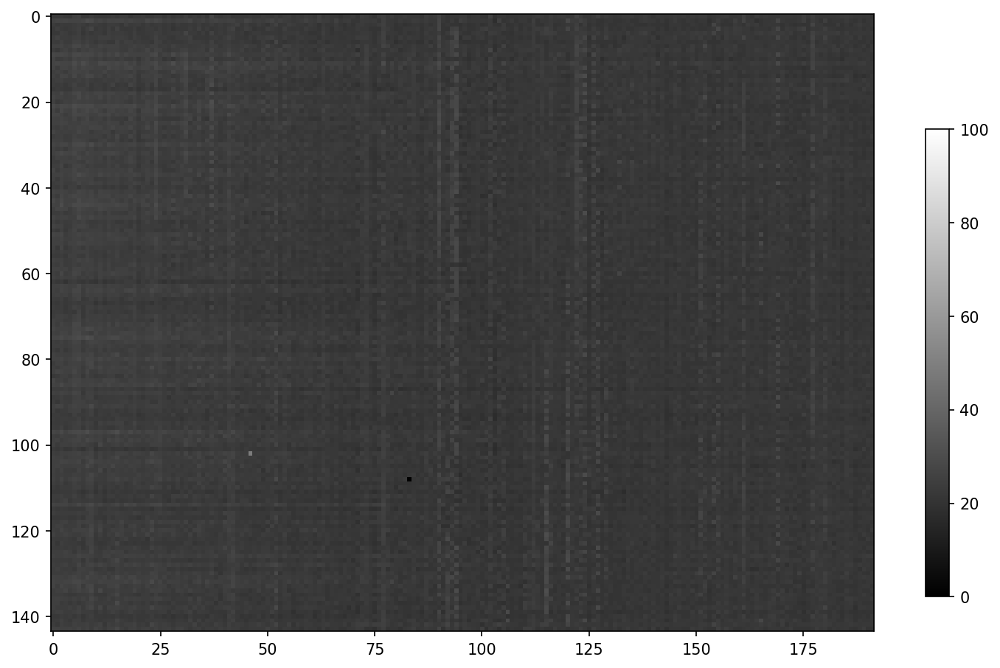

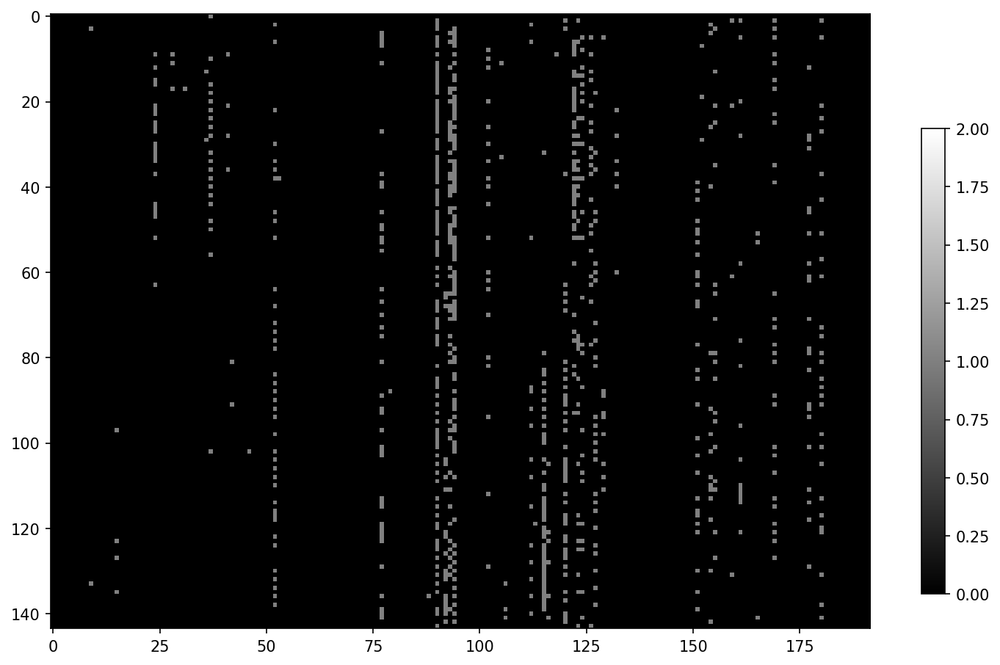

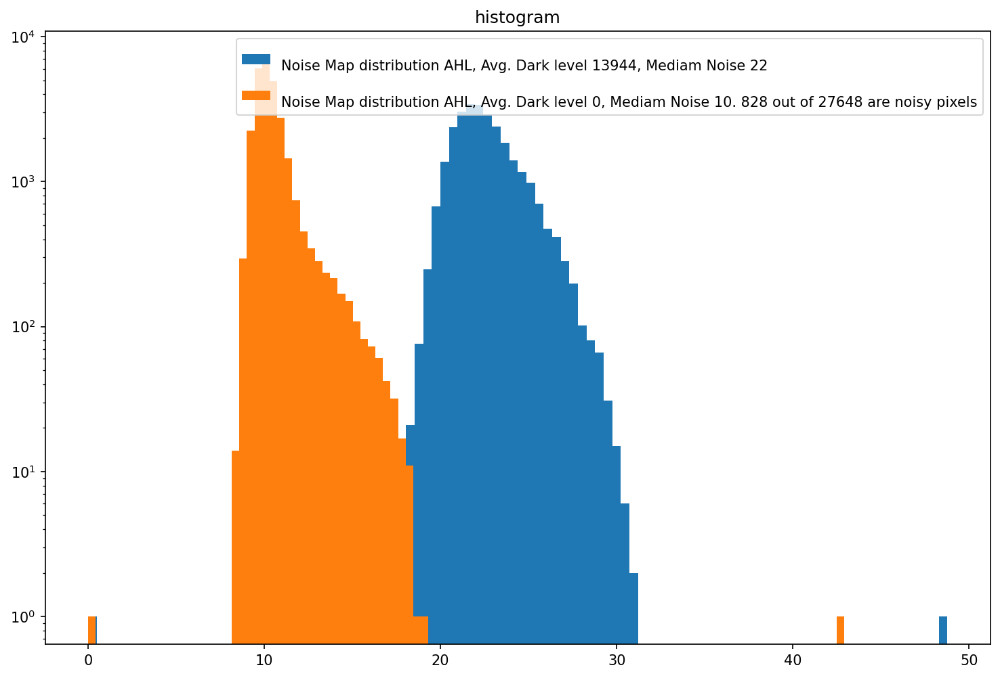

(2000, 144, 384)
(2000, 144, 192)
(2000, 144, 384)
(2000, 144, 192)
cc track shape (2000, 1, 1)
(2000, 1, 1)
Preamp 6
Vld1_b 1
Pixel_CB 7
Filter_DAC 17
VRef_DAC 58
/u2/ddoering/ASIC_V3_ASIC2_SB_SET_4/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_6_Vld1b_1_PixelCB_7_Filter_DAC_17_VRrefdac_58_DHg_0_run1.dat
Aquisition Counter 3114540
Number of frames received: 5003
Number of frames received: 6005
Number of frames received: 7006
Number of frames received: 8007
Number of frames received: 9008
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56088)
(144, 384)


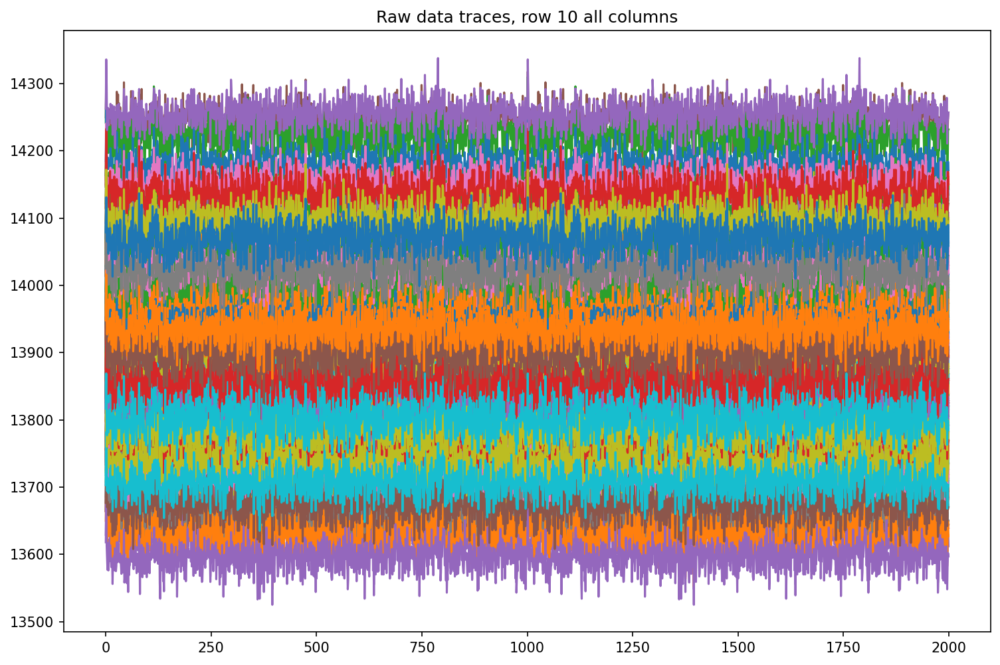

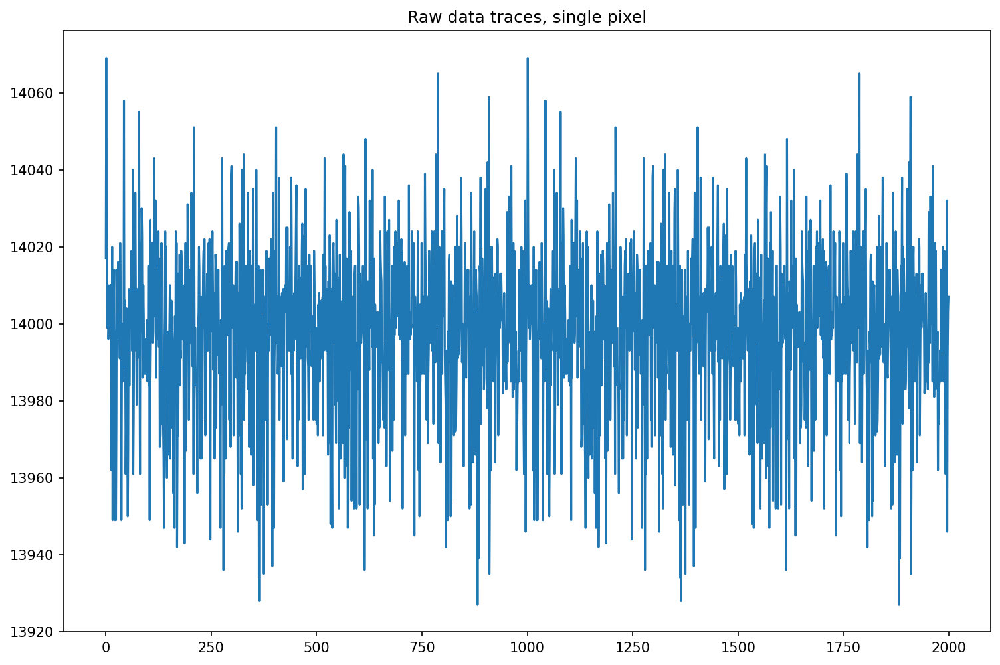

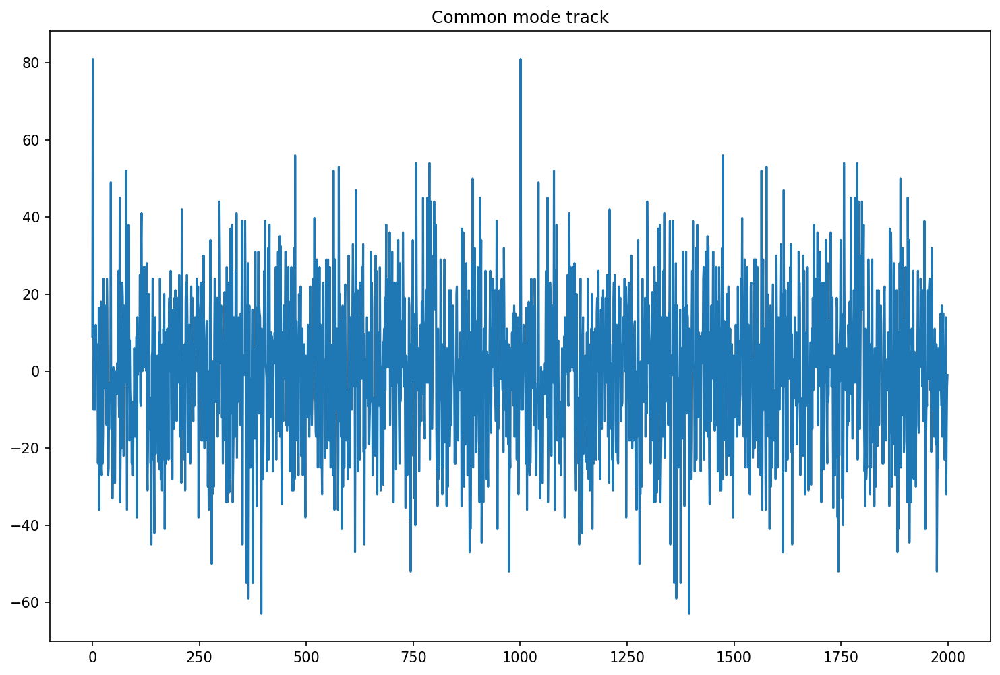

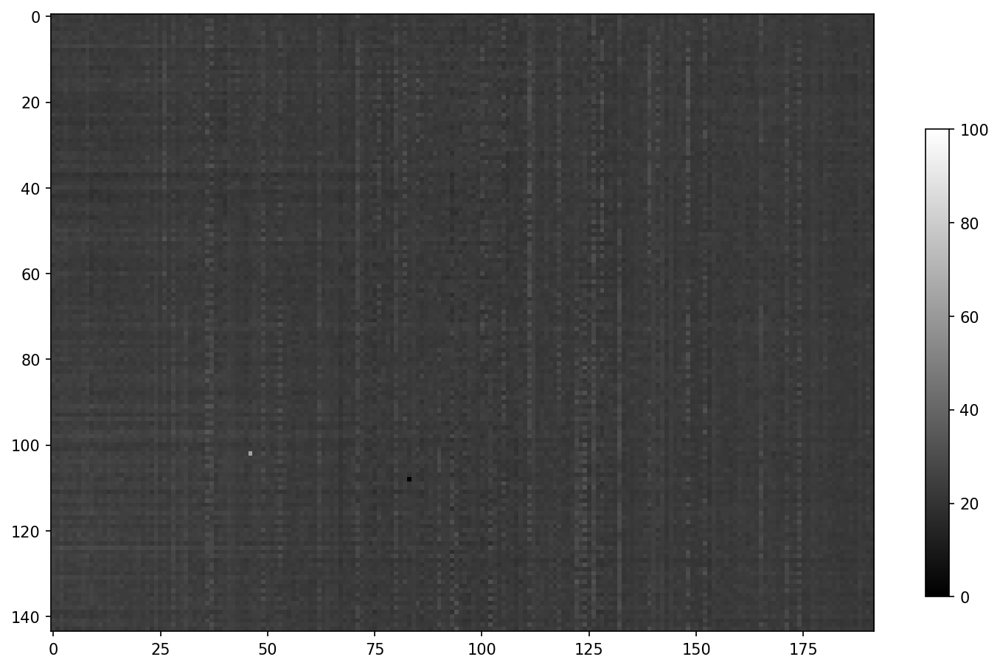

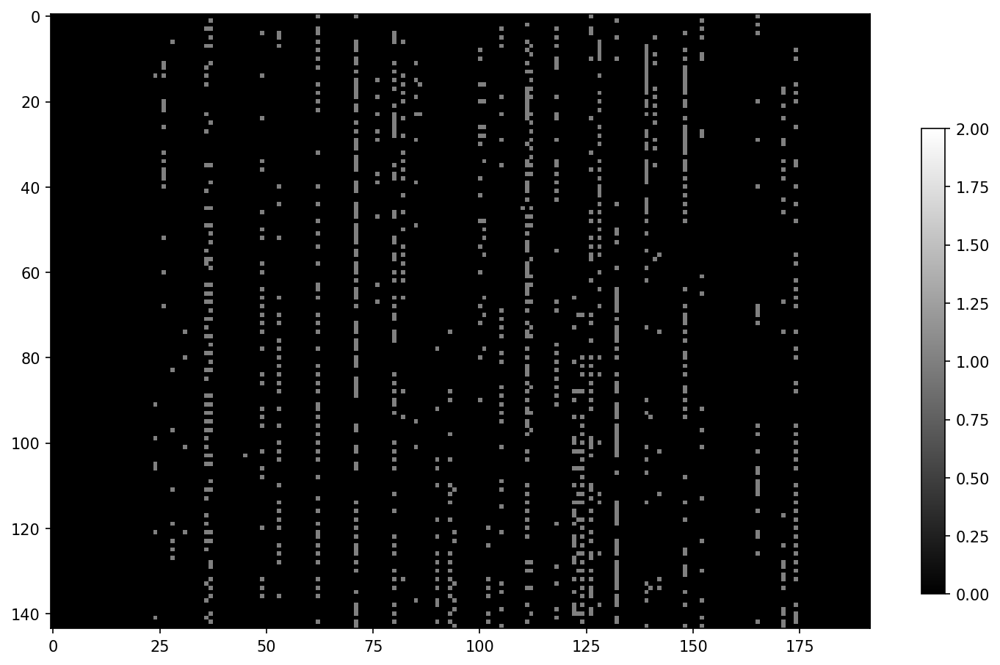

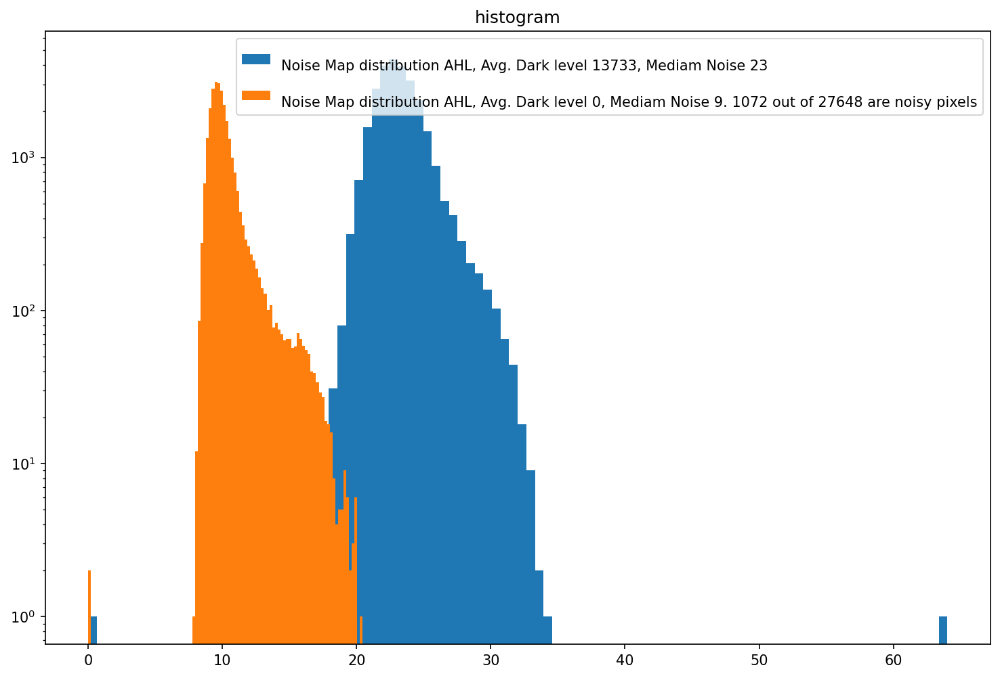

(2000, 144, 384)
(2000, 144, 192)
(2000, 144, 384)
(2000, 144, 192)
cc track shape (2000, 1, 1)
(2000, 1, 1)
Preamp 5
Vld1_b 1
Pixel_CB 7
Filter_DAC 17
VRef_DAC 58
/u2/ddoering/ASIC_V3_ASIC2_SB_SET_4/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_5_Vld1b_1_PixelCB_7_Filter_DAC_17_VRrefdac_58_DHg_0_run1.dat
Aquisition Counter 3123548
Number of frames received: 5004
Number of frames received: 6005
Number of frames received: 7006
Number of frames received: 8007
Number of frames received: 9008
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56088)
(144, 384)


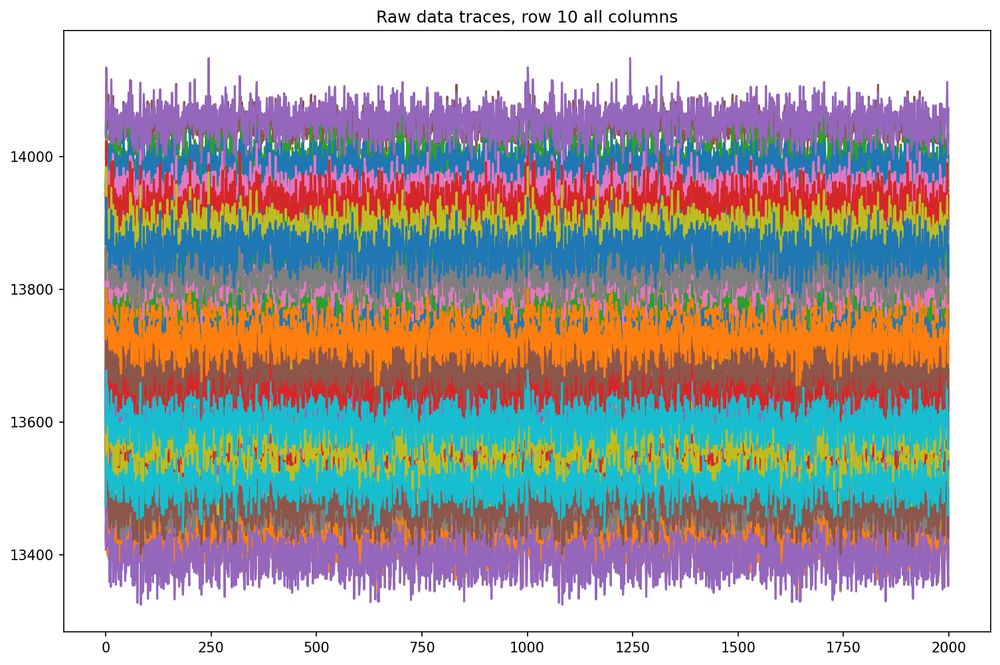

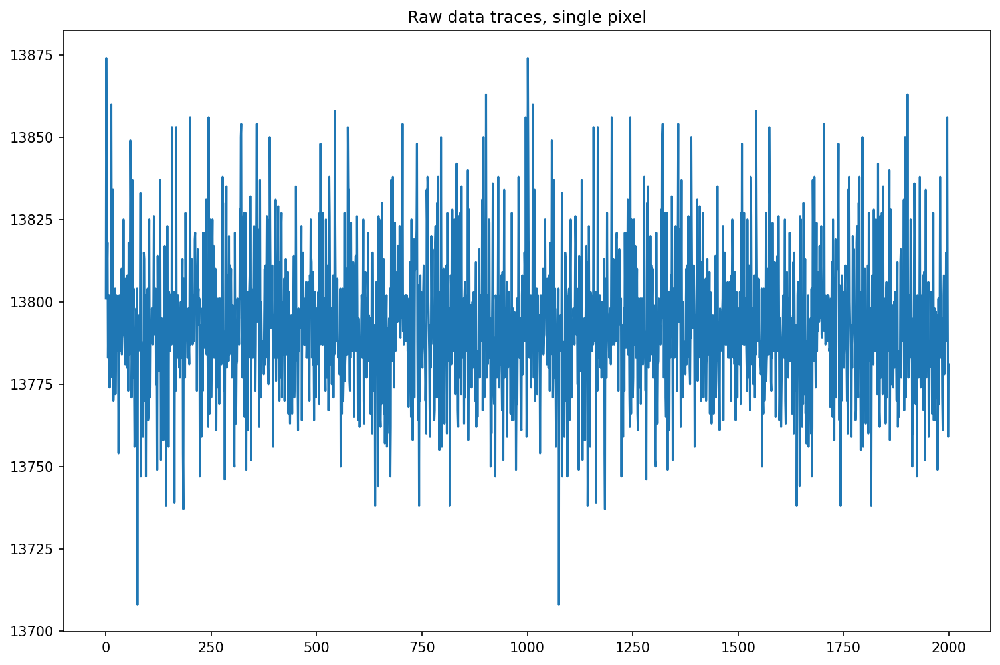

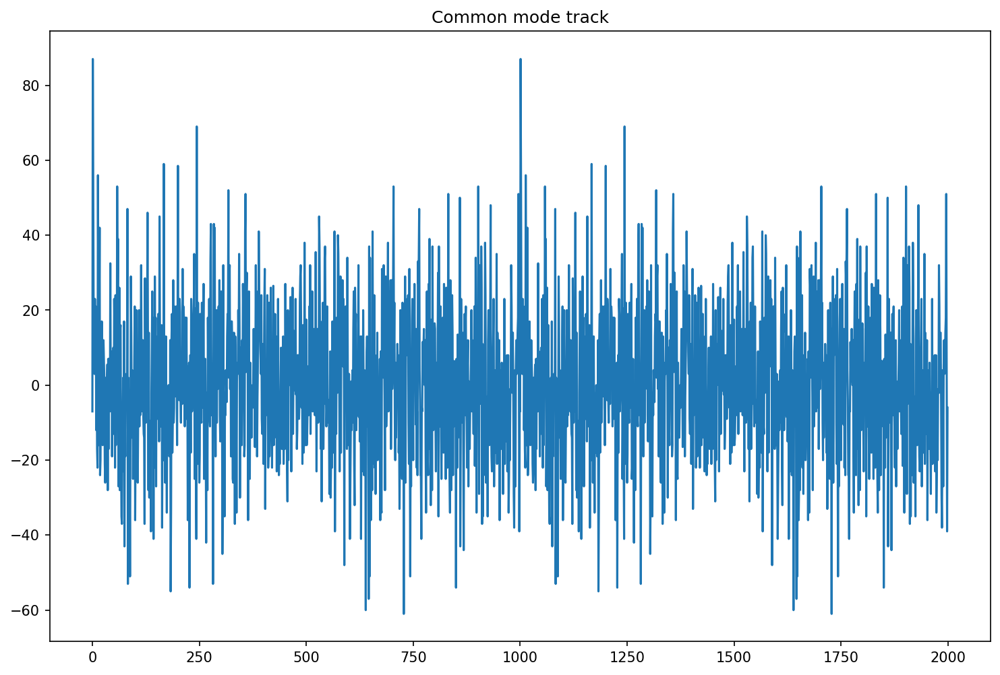

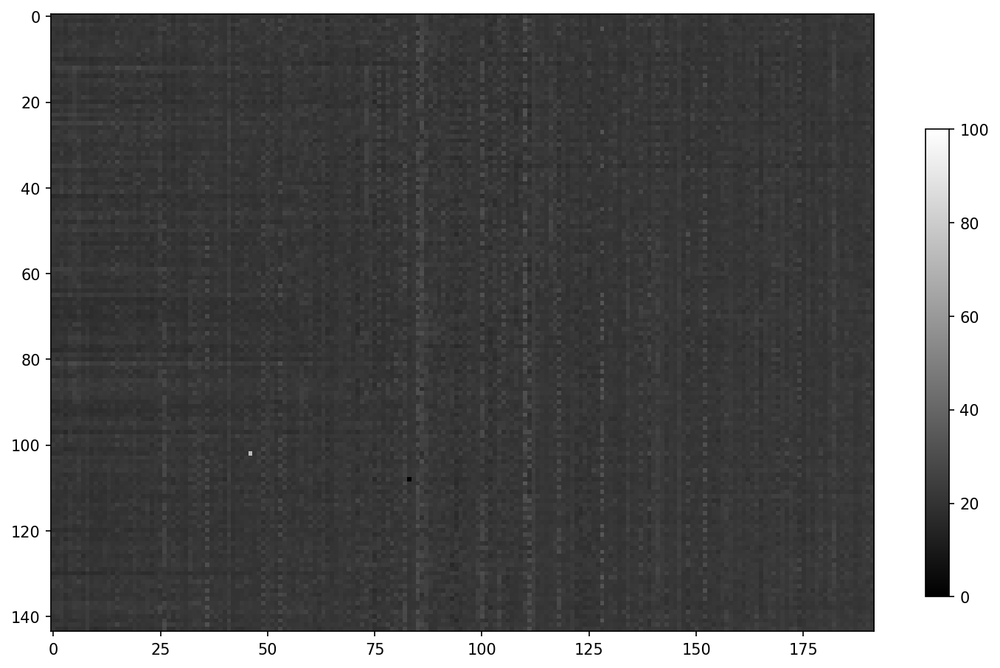

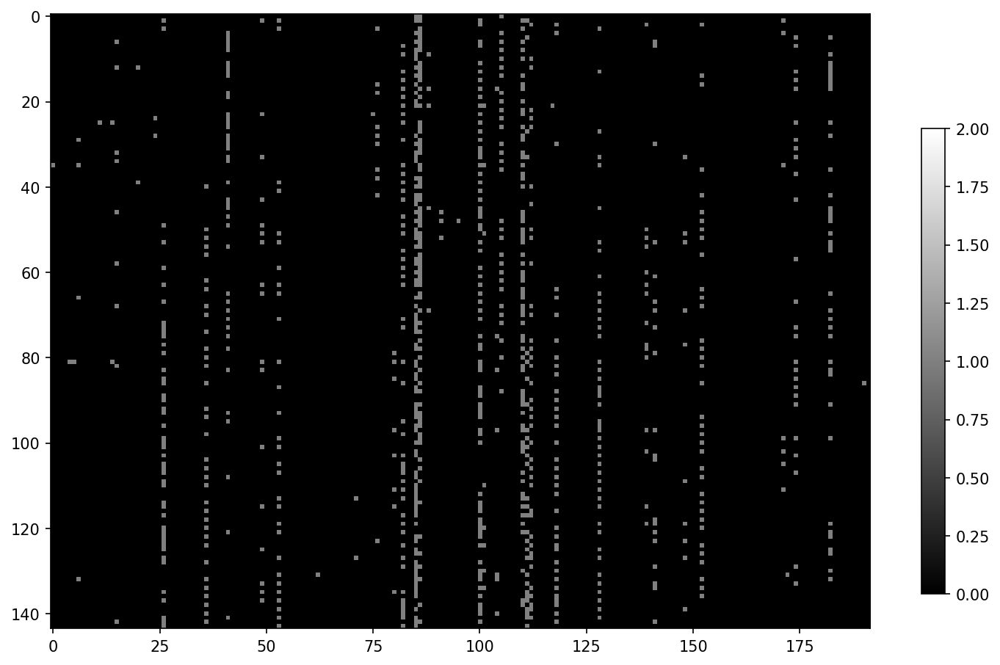

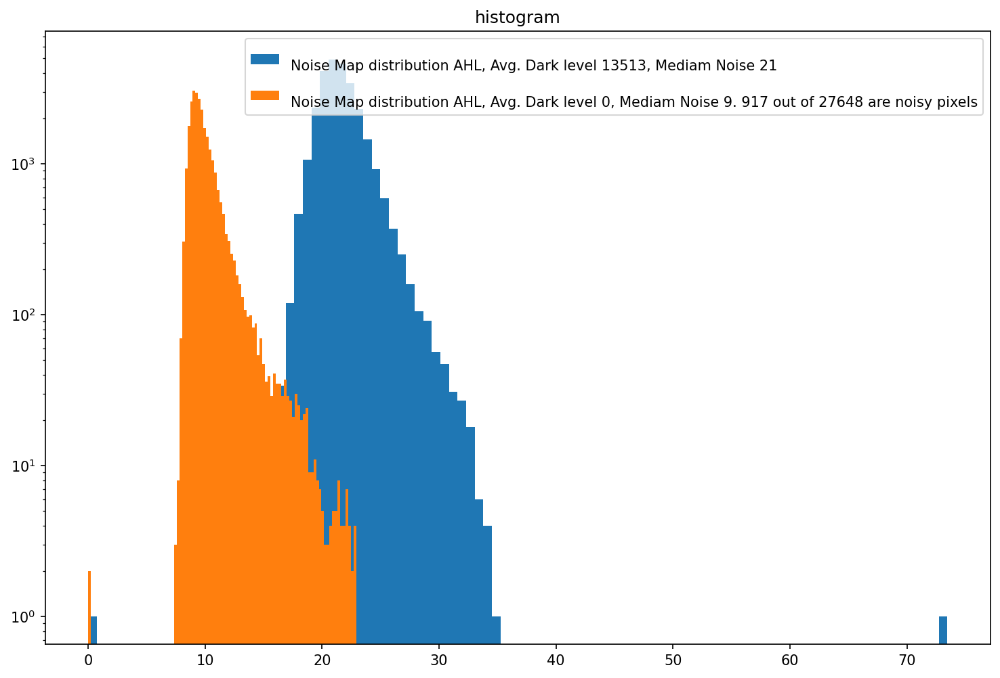

(2000, 144, 384)
(2000, 144, 192)
(2000, 144, 384)
(2000, 144, 192)
cc track shape (2000, 1, 1)
(2000, 1, 1)
Preamp 4
Vld1_b 1
Pixel_CB 7
Filter_DAC 17
VRef_DAC 58
/u2/ddoering/ASIC_V3_ASIC2_SB_SET_4/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_4_Vld1b_1_PixelCB_7_Filter_DAC_17_VRrefdac_58_DHg_0_run1.dat
Aquisition Counter 3132556
Number of frames received: 5002
Number of frames received: 6003
Number of frames received: 7004
Number of frames received: 8005
Number of frames received: 9007
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56088)
(144, 384)


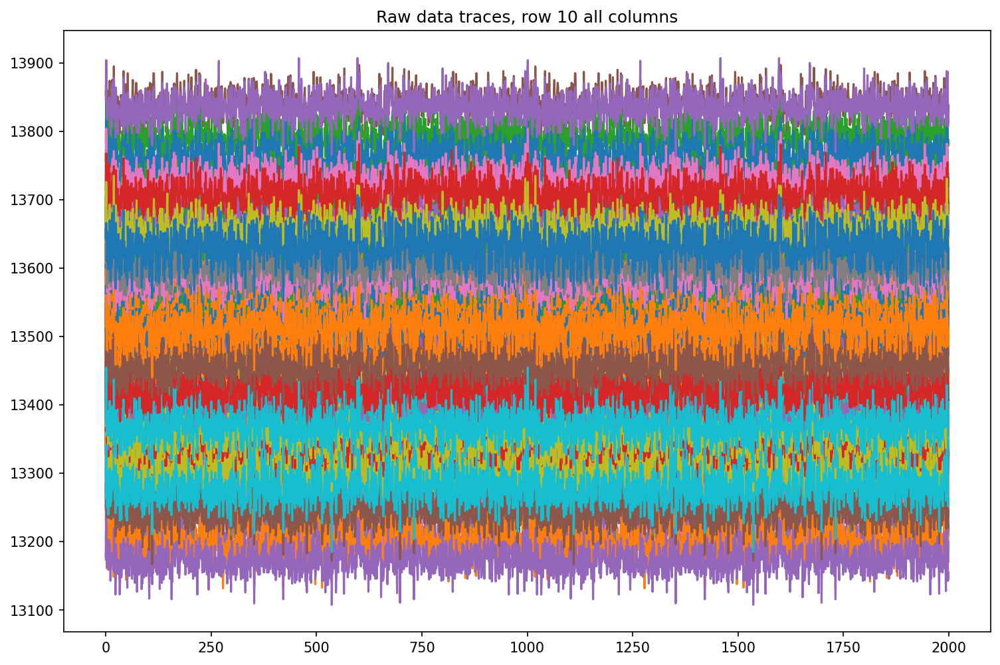

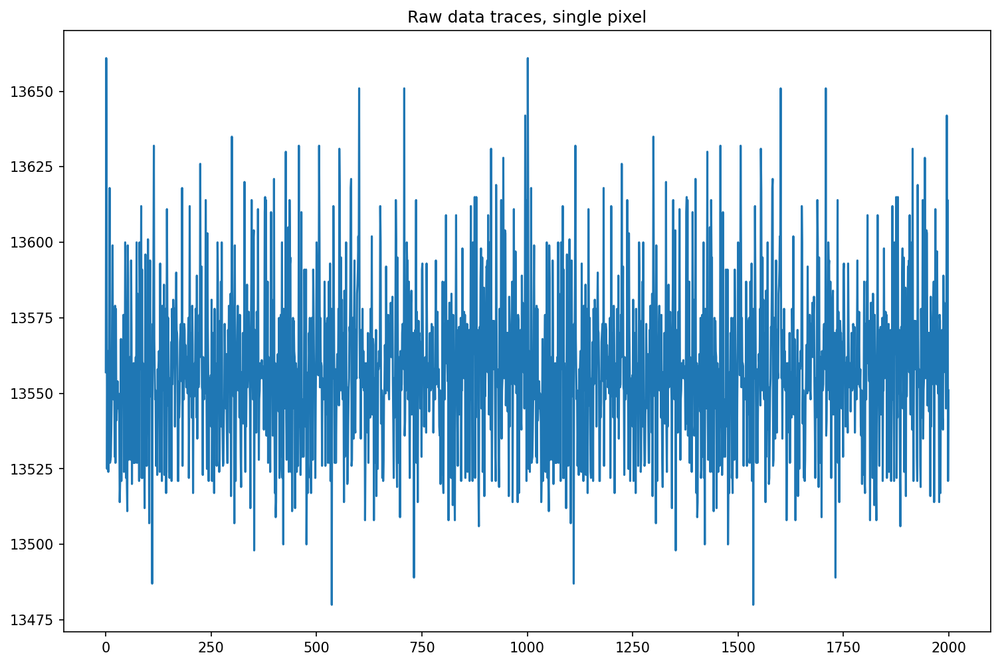

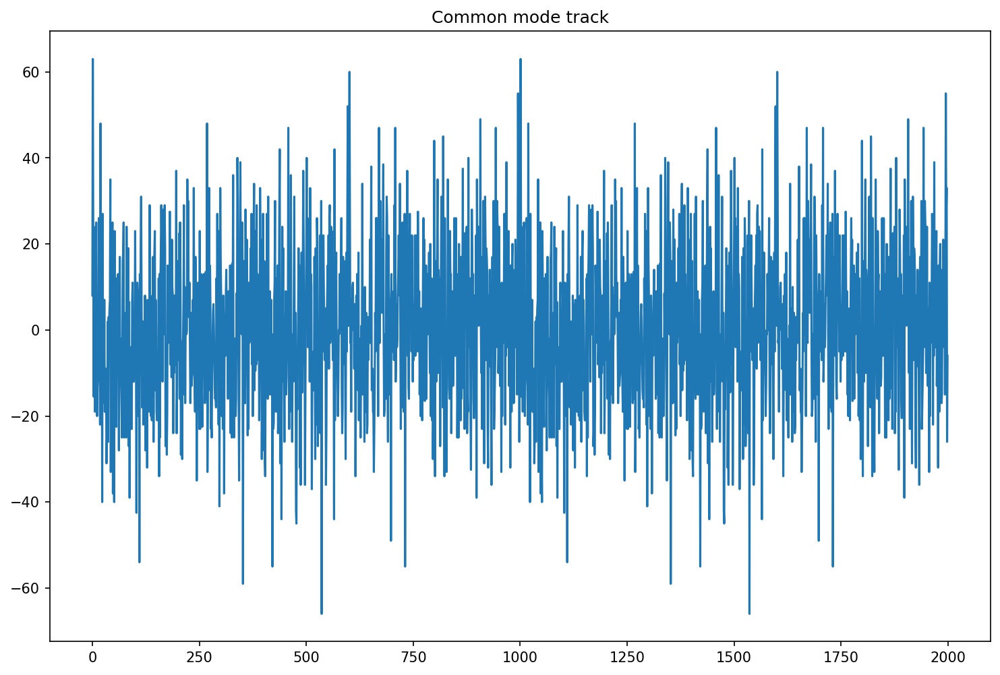

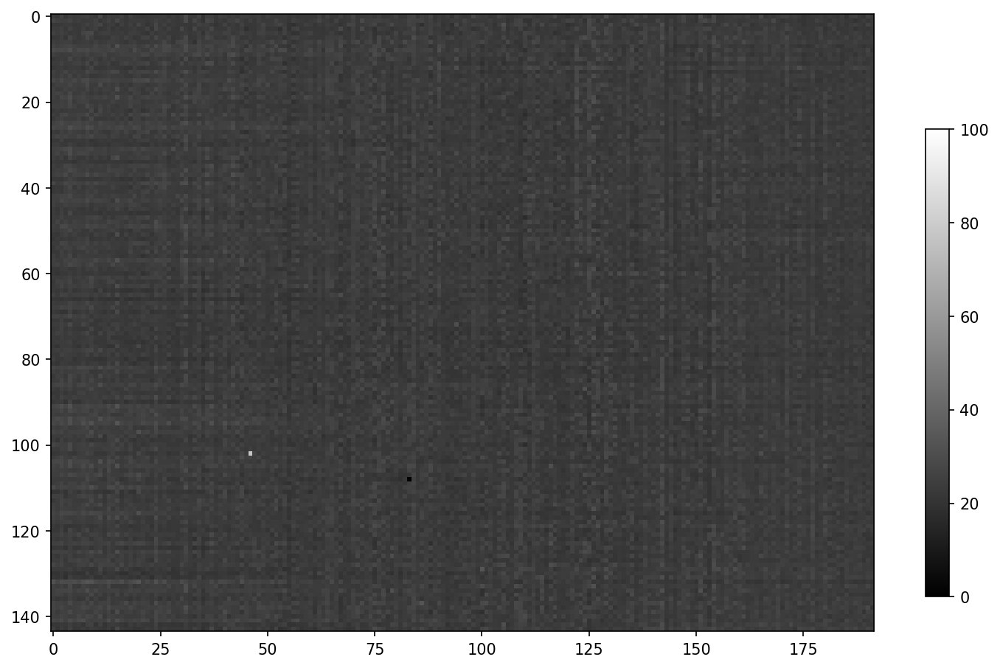

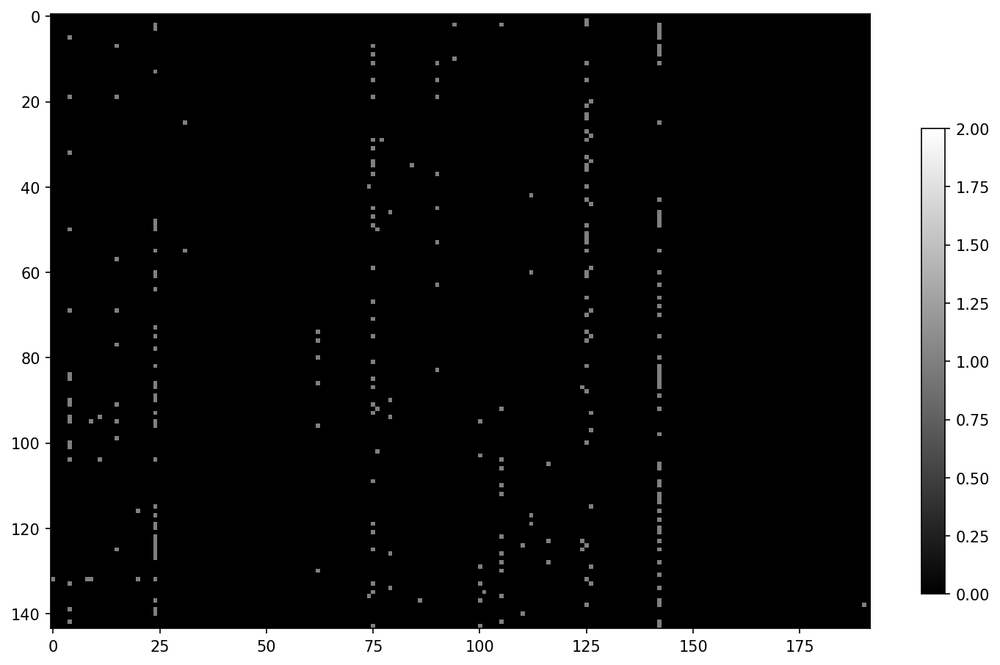

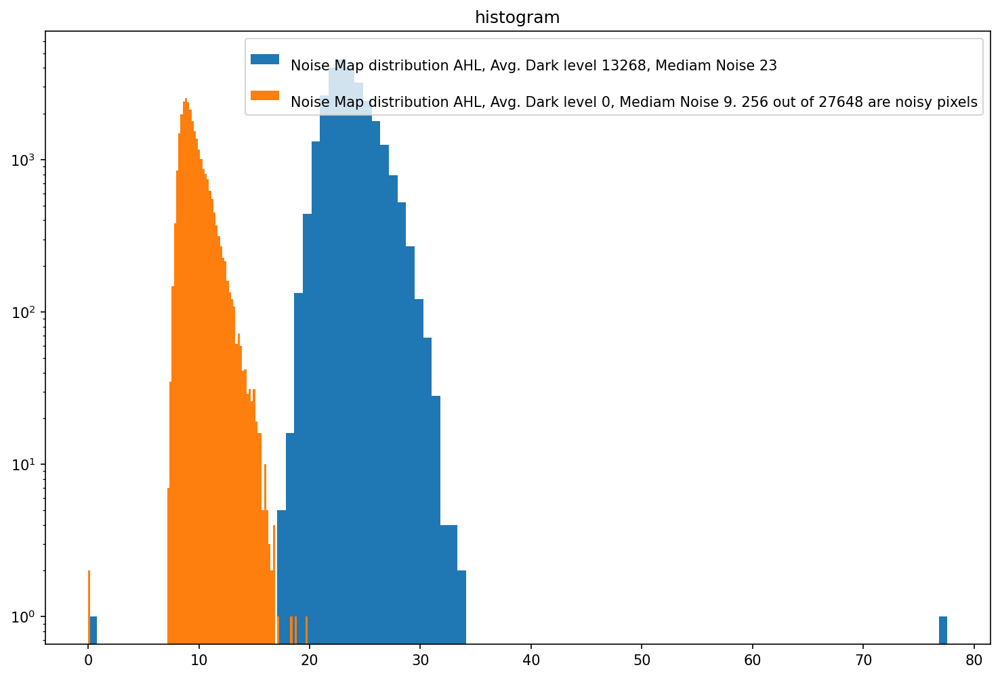

(2000, 144, 384)
(2000, 144, 192)
(2000, 144, 384)
(2000, 144, 192)
cc track shape (2000, 1, 1)
(2000, 1, 1)
Preamp 3
Vld1_b 1
Pixel_CB 7
Filter_DAC 17
VRef_DAC 58
/u2/ddoering/ASIC_V3_ASIC2_SB_SET_4/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_3_Vld1b_1_PixelCB_7_Filter_DAC_17_VRrefdac_58_DHg_0_run1.dat
Aquisition Counter 3141563
Number of frames received: 5003
Number of frames received: 5833
Number of frames received: 5833
Number of frames received: 5833
Number of frames received: 5833
Number of frames received: 5833
Number of frames received: 5833
Number of frames received: 5833
Number of frames received: 5833
Number of frames received: 5833
Number of frames received: 5833
Number of frames received: 5833
Number of frames received: 5833
Number of frames received: 5833
Number of frames received: 5833
Number of frames received: 6639
Number of frames received: 7640
Number of frames received: 8641
Number of frames received: 9643
Starting to get data set 0
Read 1000 frames
numb

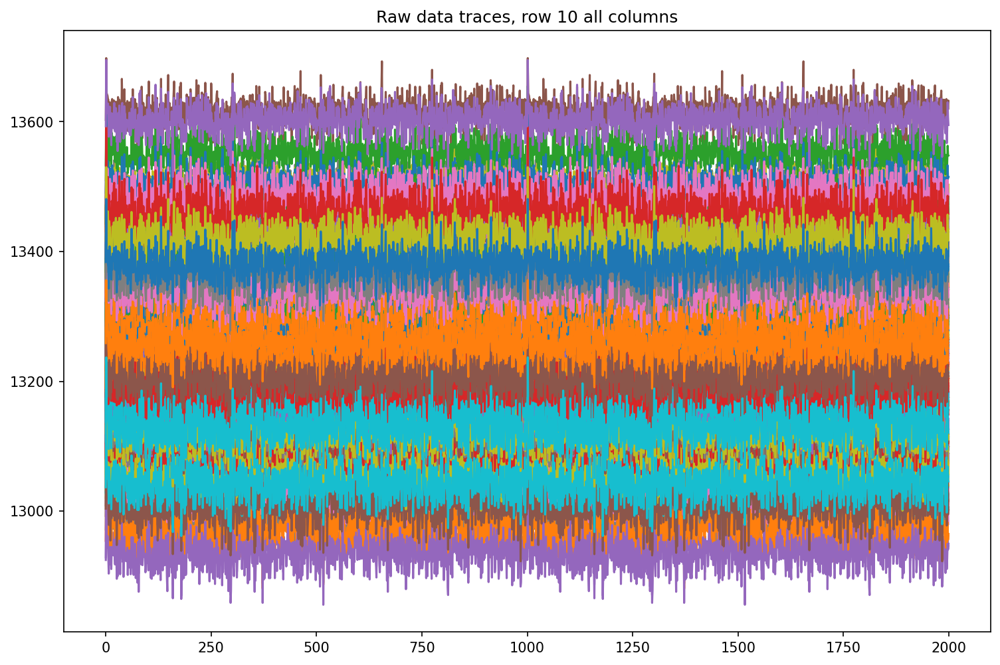

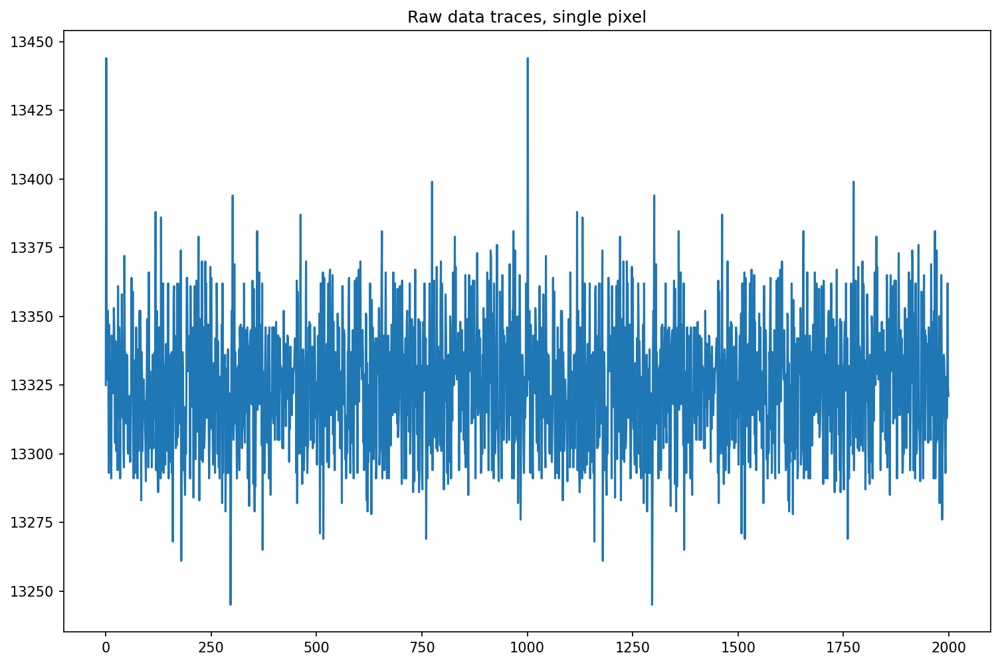

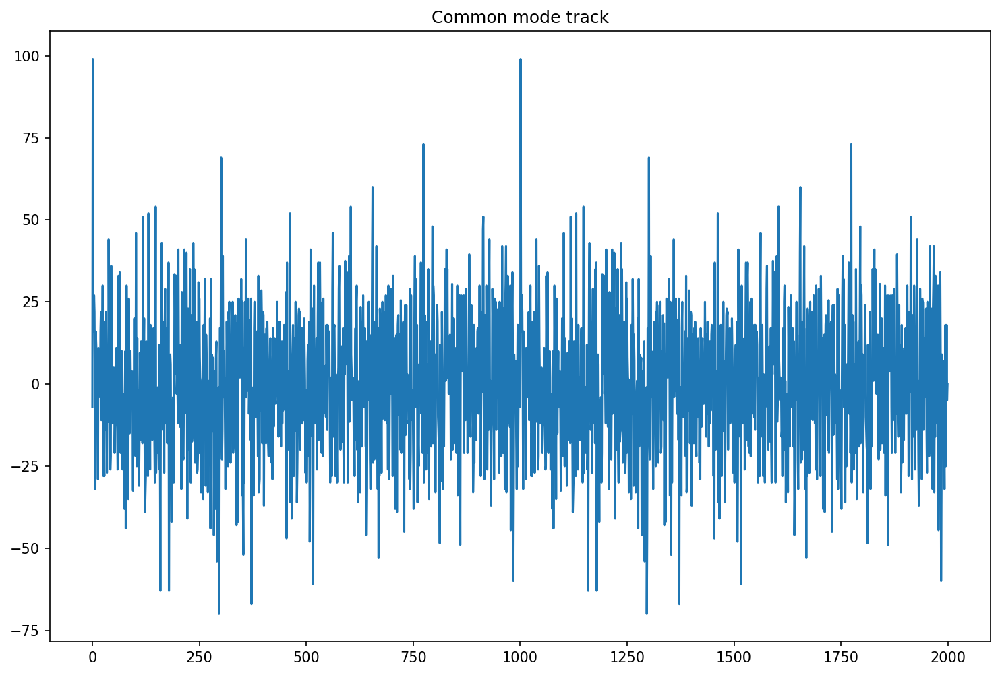

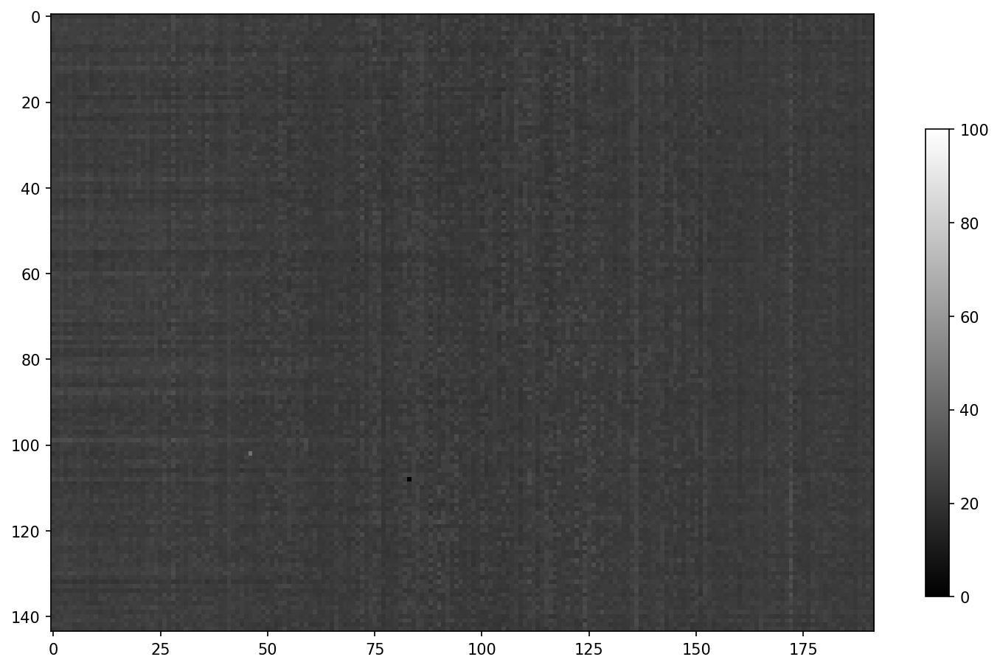

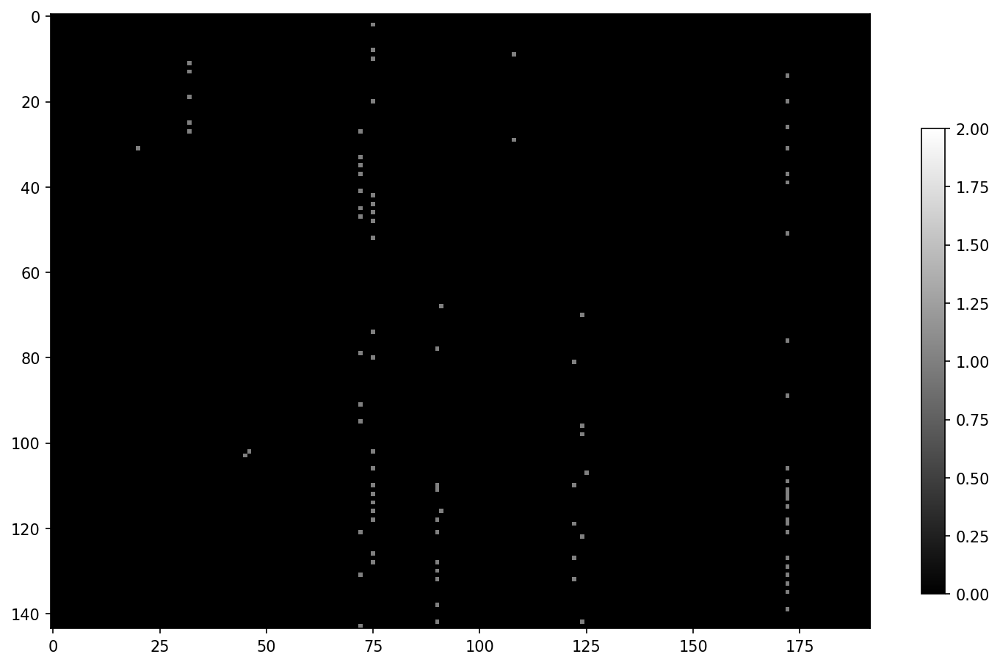

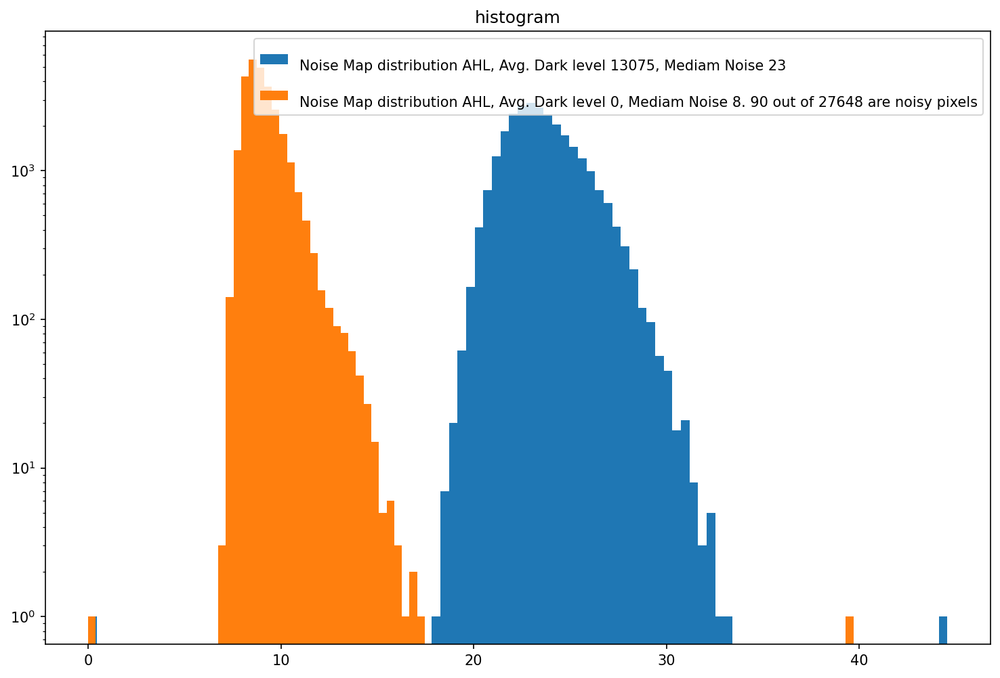

(2000, 144, 384)
(2000, 144, 192)
(2000, 144, 384)
(2000, 144, 192)
cc track shape (2000, 1, 1)
(2000, 1, 1)
Preamp 2
Vld1_b 1
Pixel_CB 7
Filter_DAC 17
VRef_DAC 58
/u2/ddoering/ASIC_V3_ASIC2_SB_SET_4/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_2_Vld1b_1_PixelCB_7_Filter_DAC_17_VRrefdac_58_DHg_0_run1.dat
Aquisition Counter 3164583
Number of frames received: 5003
Number of frames received: 6004
Number of frames received: 7006
Number of frames received: 8006
Number of frames received: 9008
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56088)
(144, 384)


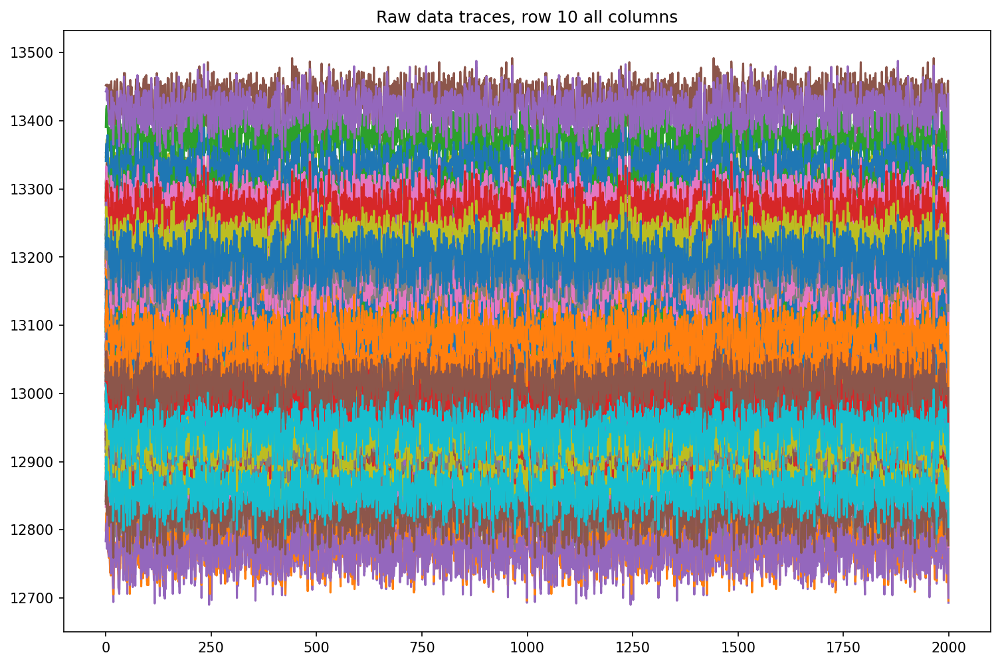

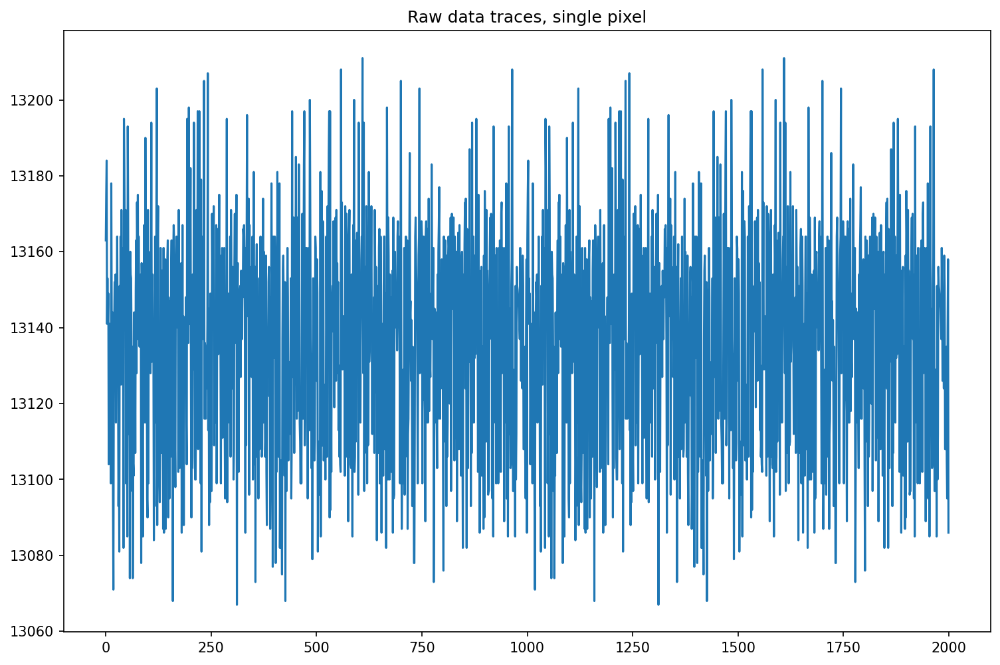

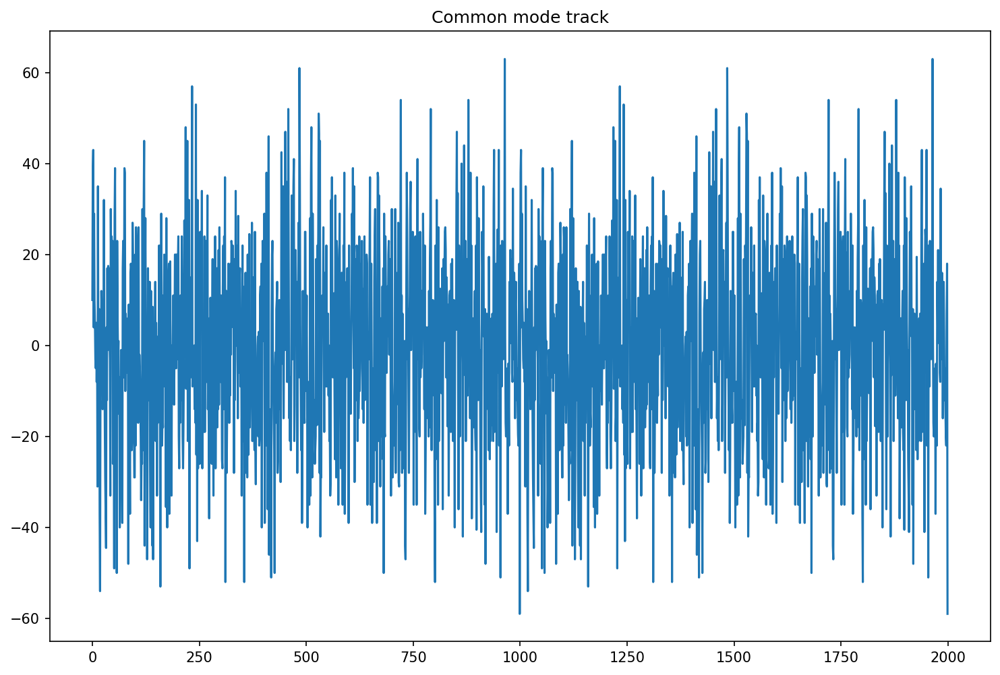

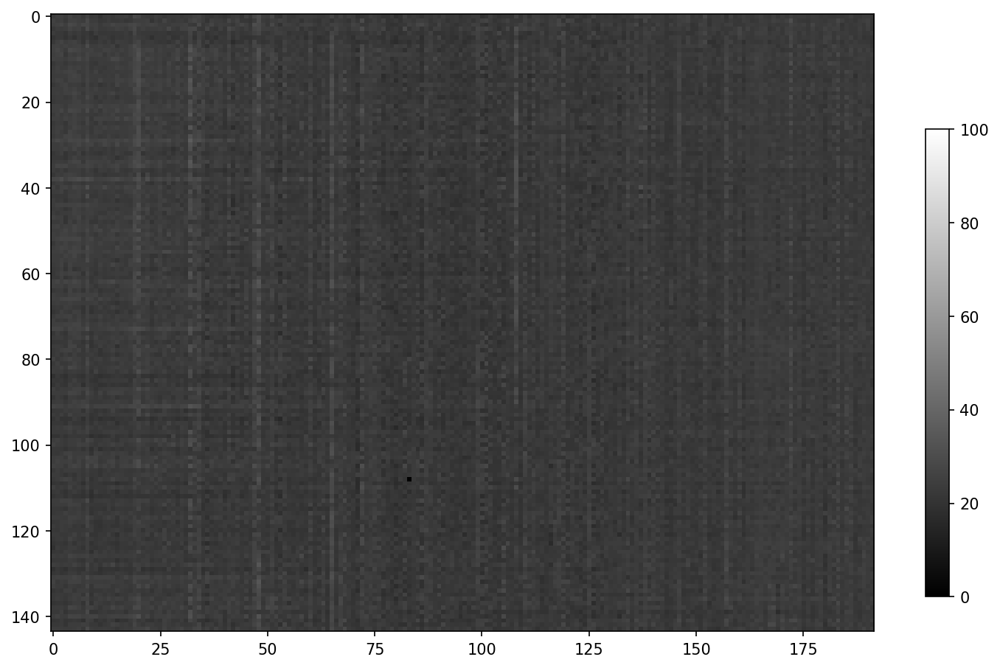

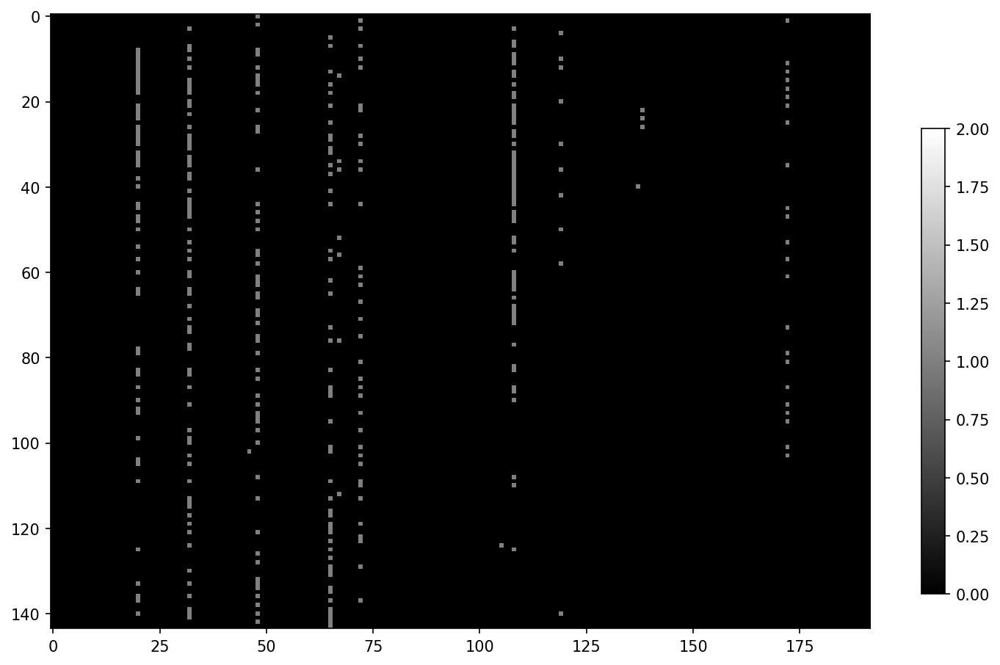

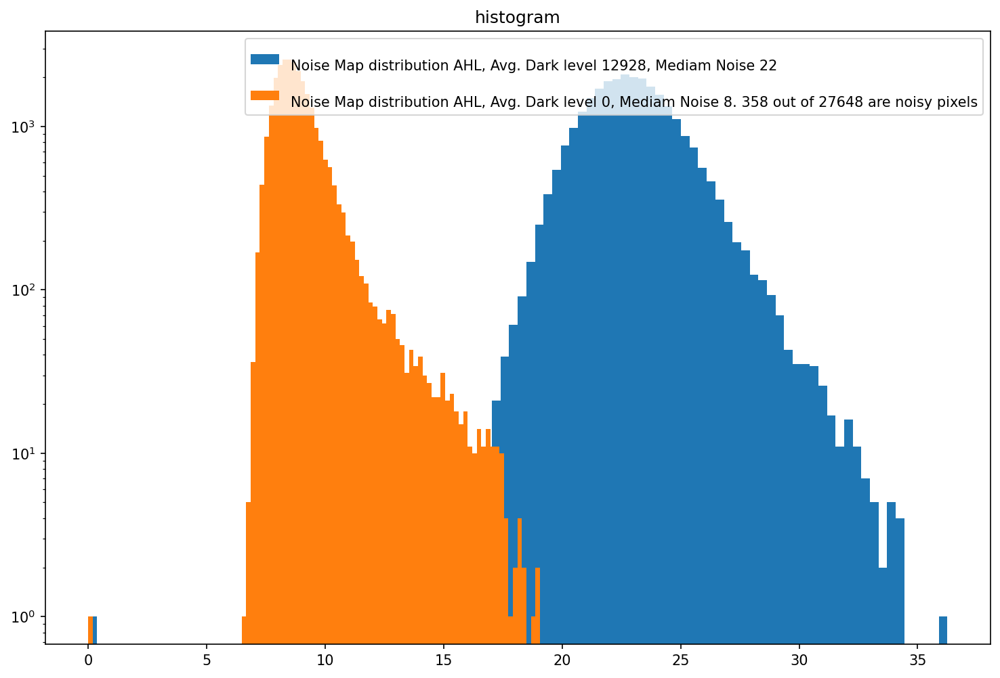

(2000, 144, 384)
(2000, 144, 192)
(2000, 144, 384)
(2000, 144, 192)
cc track shape (2000, 1, 1)
(2000, 1, 1)
Preamp 1
Vld1_b 1
Pixel_CB 7
Filter_DAC 17
VRef_DAC 58
/u2/ddoering/ASIC_V3_ASIC2_SB_SET_4/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_1_Vld1b_1_PixelCB_7_Filter_DAC_17_VRrefdac_58_DHg_0_run1.dat
Aquisition Counter 3173591
Number of frames received: 5003
Number of frames received: 6004
Number of frames received: 7005
Number of frames received: 8006
Number of frames received: 9008
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56088)
(144, 384)


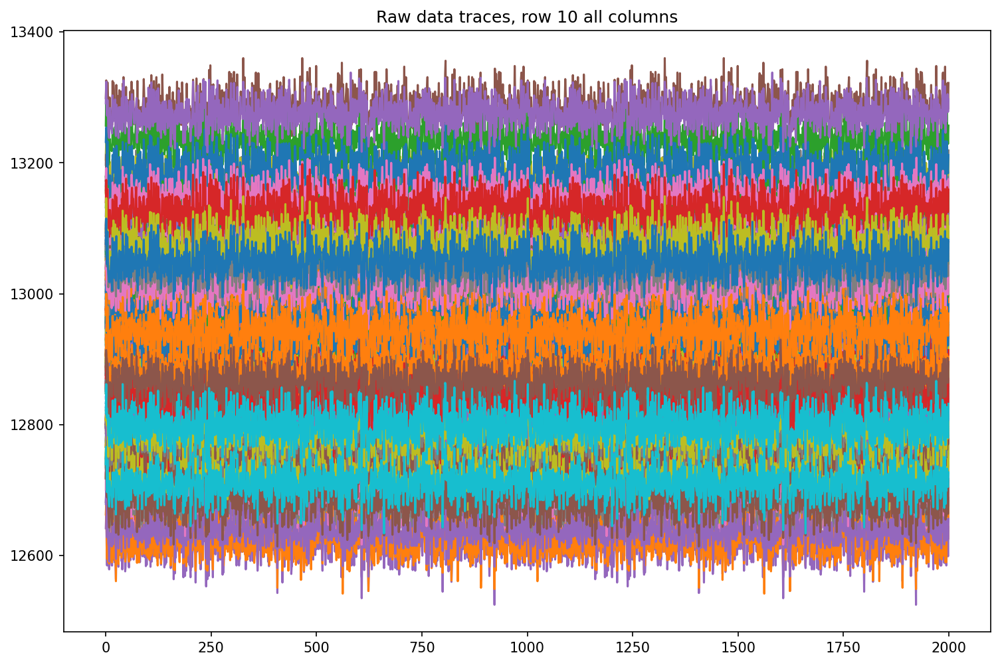

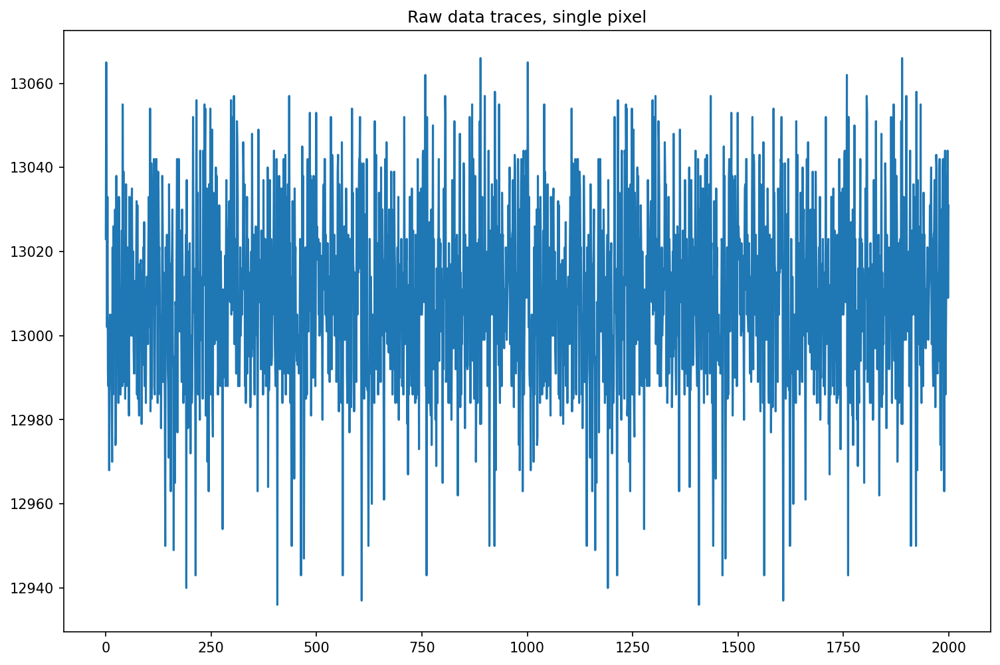

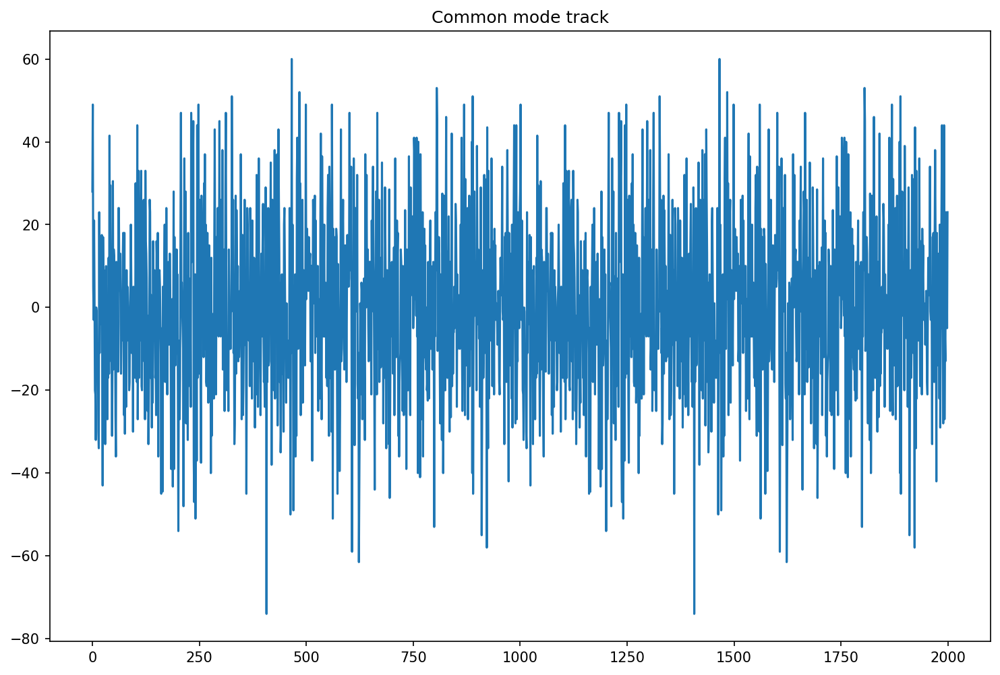

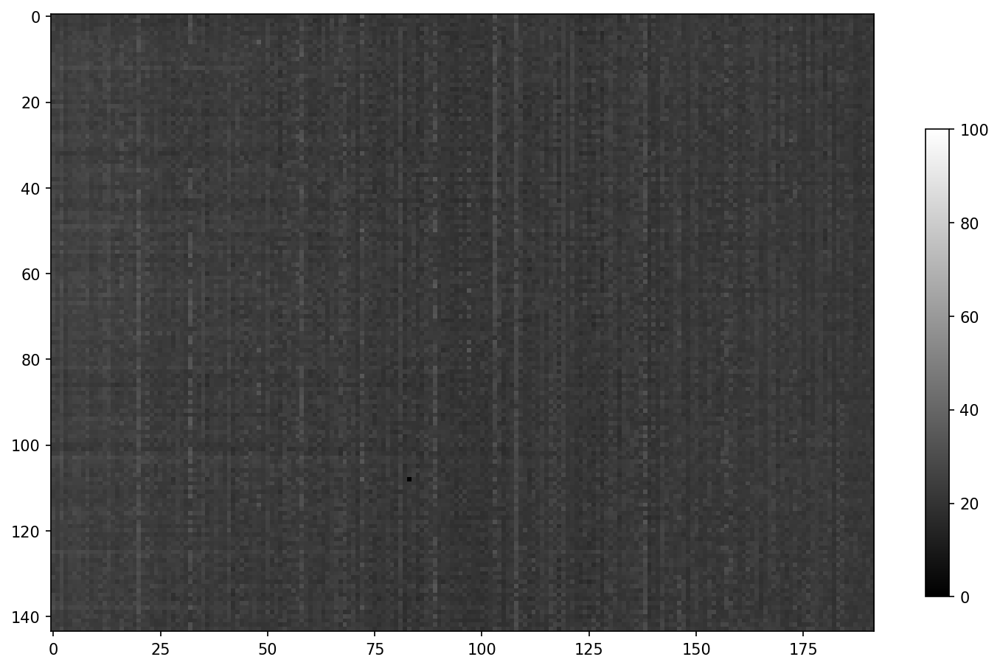

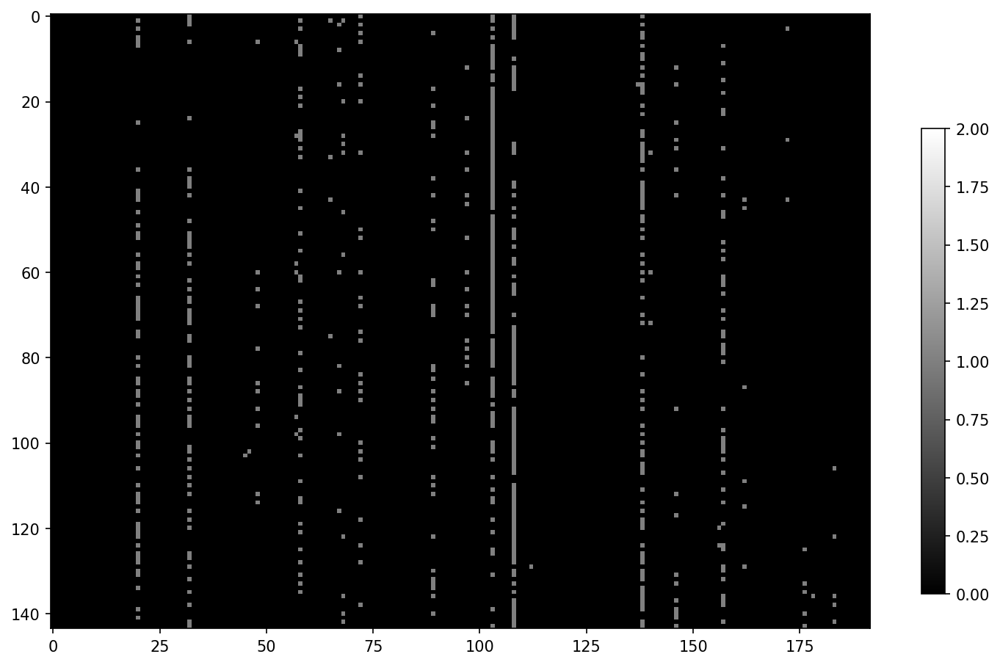

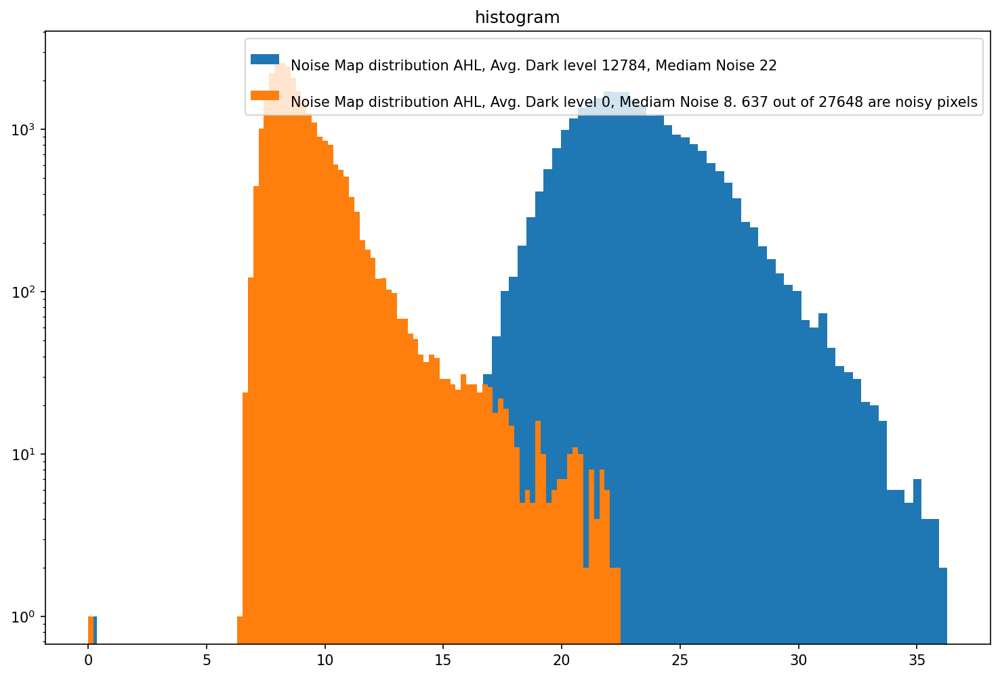

(2000, 144, 384)
(2000, 144, 192)
(2000, 144, 384)
(2000, 144, 192)
cc track shape (2000, 1, 1)
(2000, 1, 1)
Preamp 0
Vld1_b 1
Pixel_CB 7
Filter_DAC 17
VRef_DAC 58
/u2/ddoering/ASIC_V3_ASIC2_SB_SET_4/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_0_Vld1b_1_PixelCB_7_Filter_DAC_17_VRrefdac_58_DHg_0_run1.dat
Aquisition Counter 3182599
Number of frames received: 5001
Number of frames received: 6002
Number of frames received: 7003
Number of frames received: 8004
Number of frames received: 9005
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56088)
(144, 384)


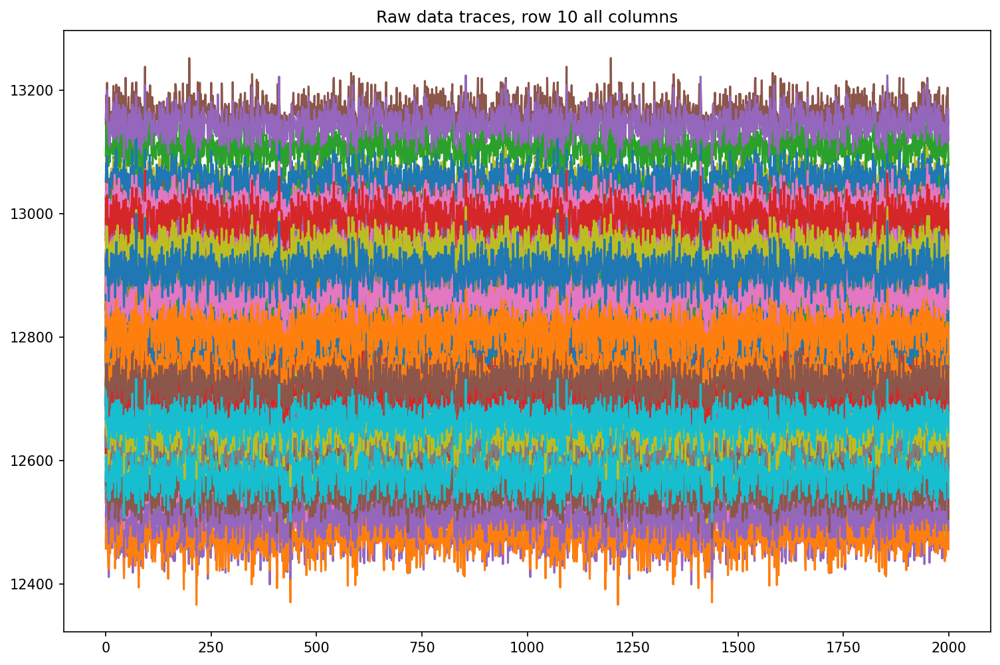

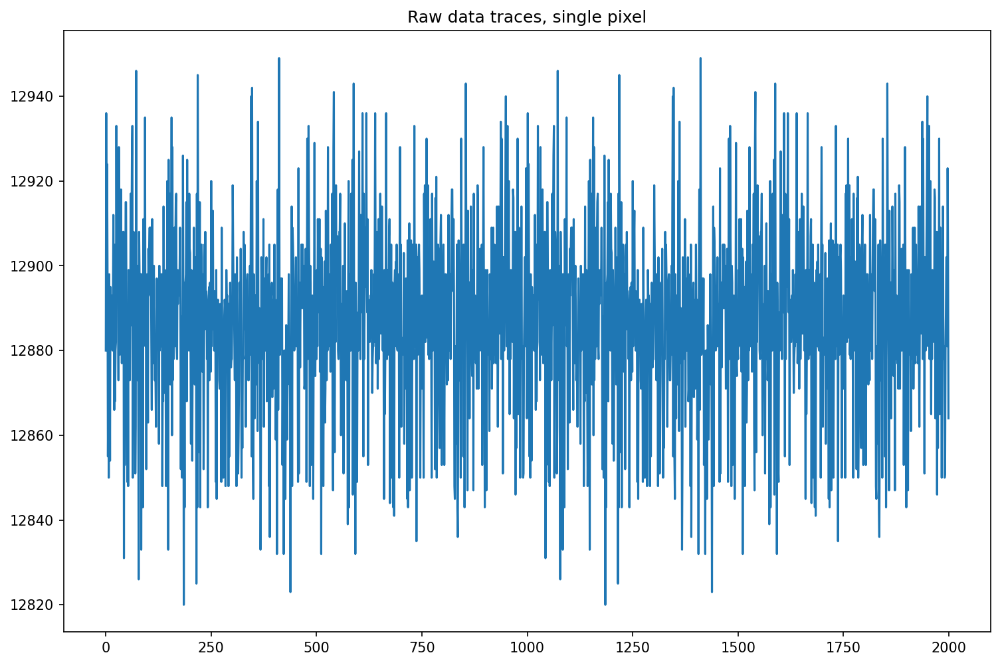

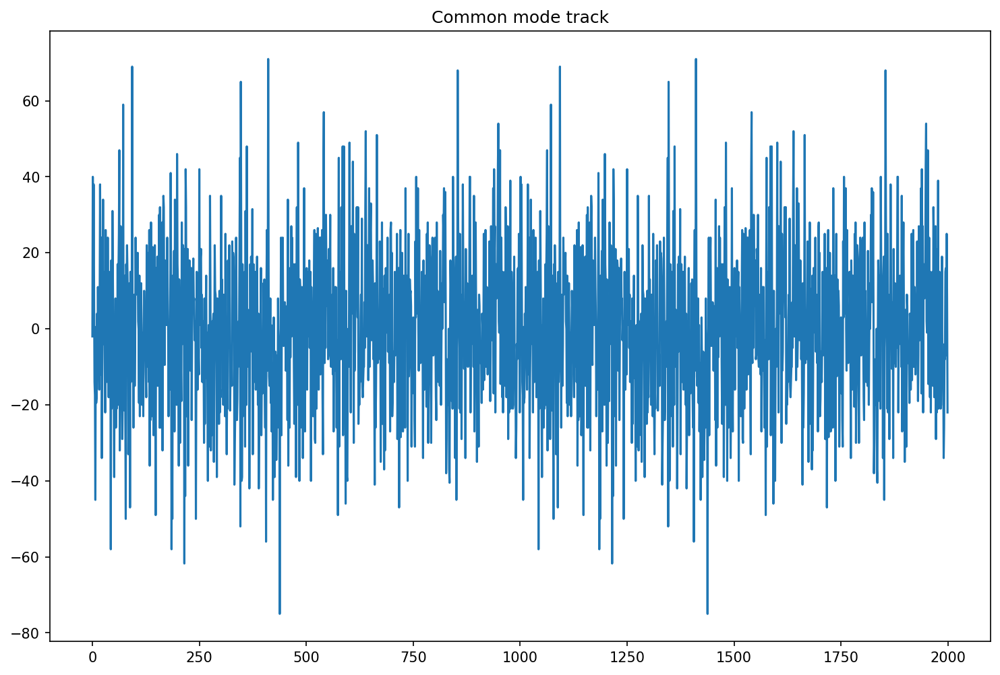

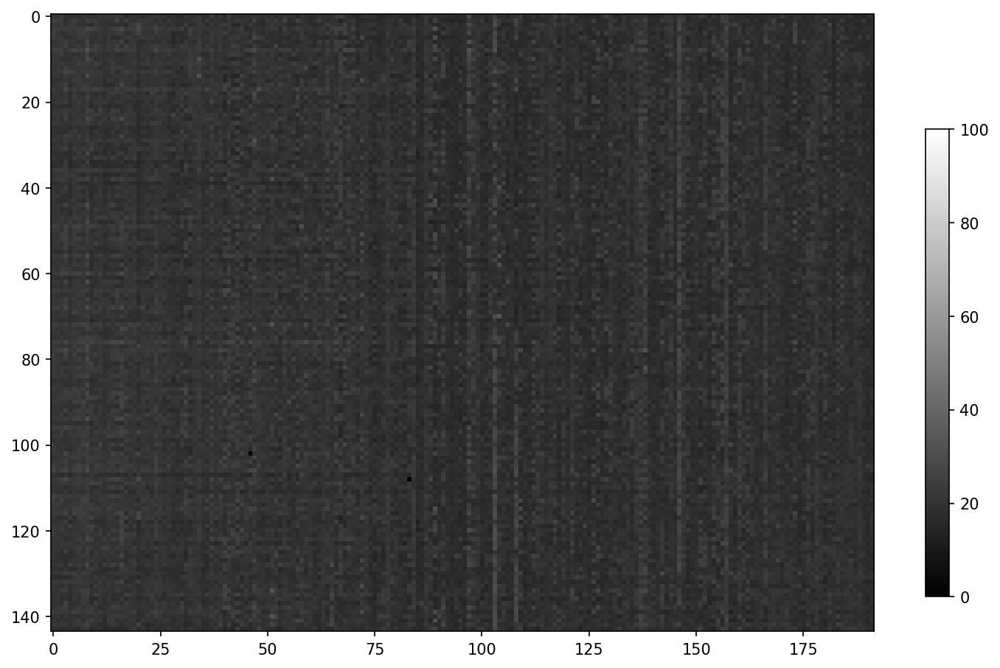

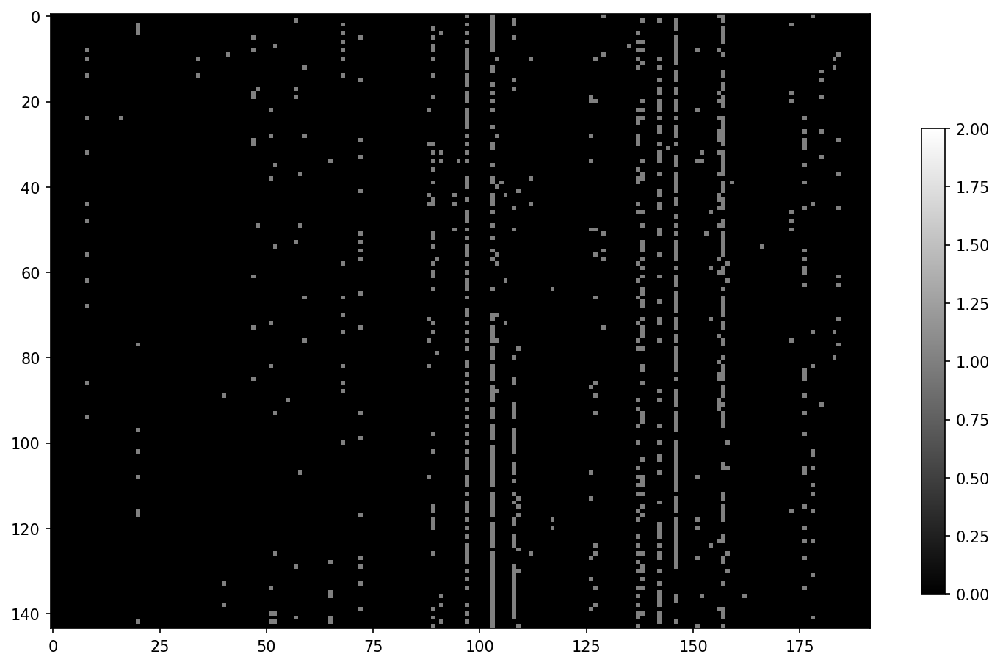

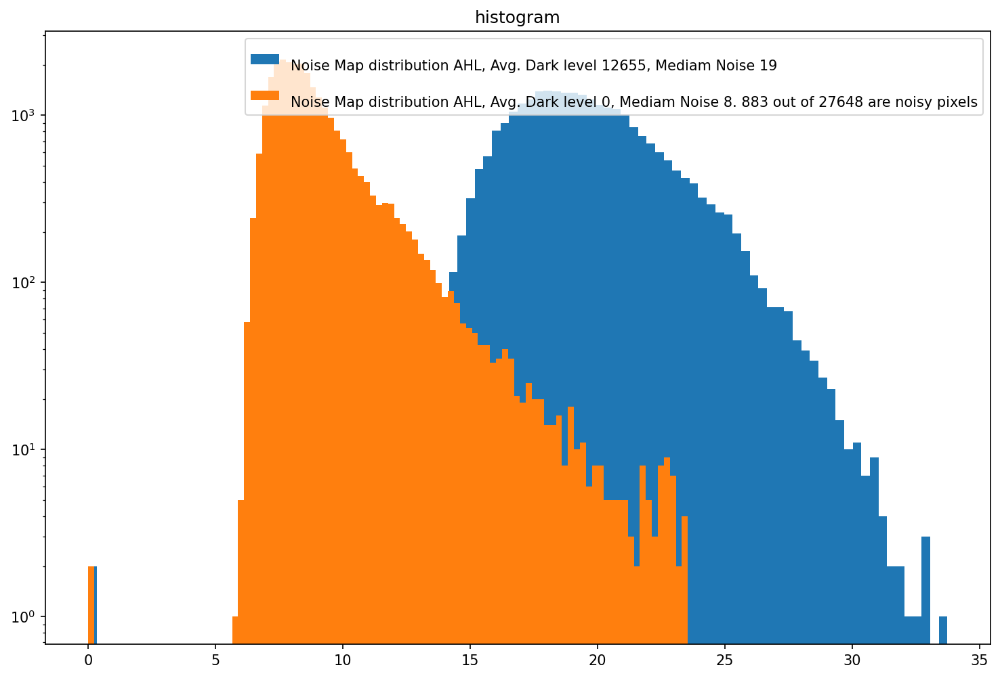

(2000, 144, 384)
(2000, 144, 192)
(2000, 144, 384)
(2000, 144, 192)
cc track shape (2000, 1, 1)
(2000, 1, 1)


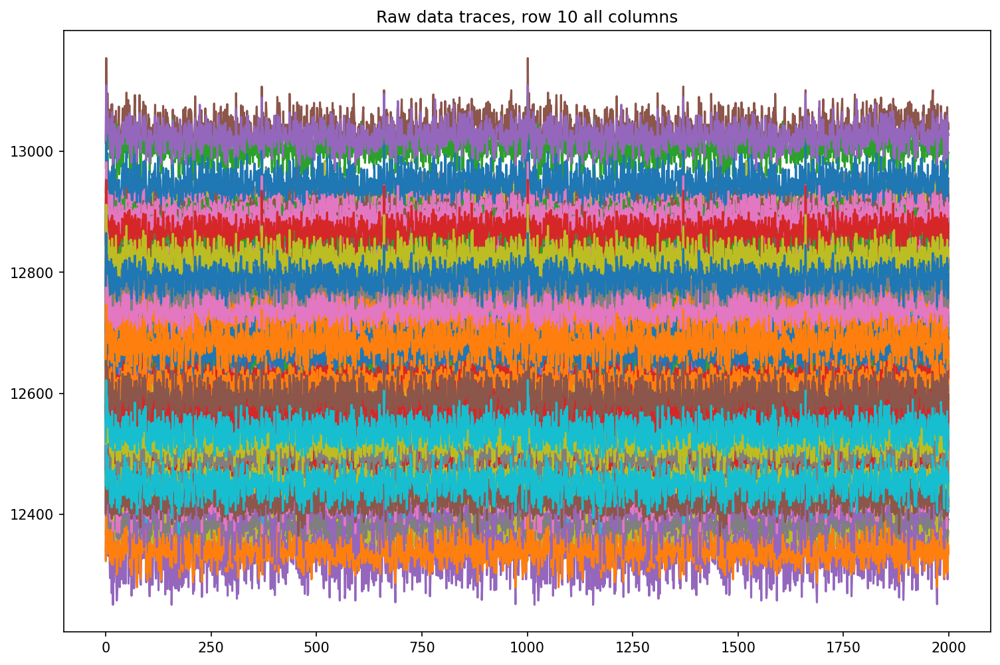

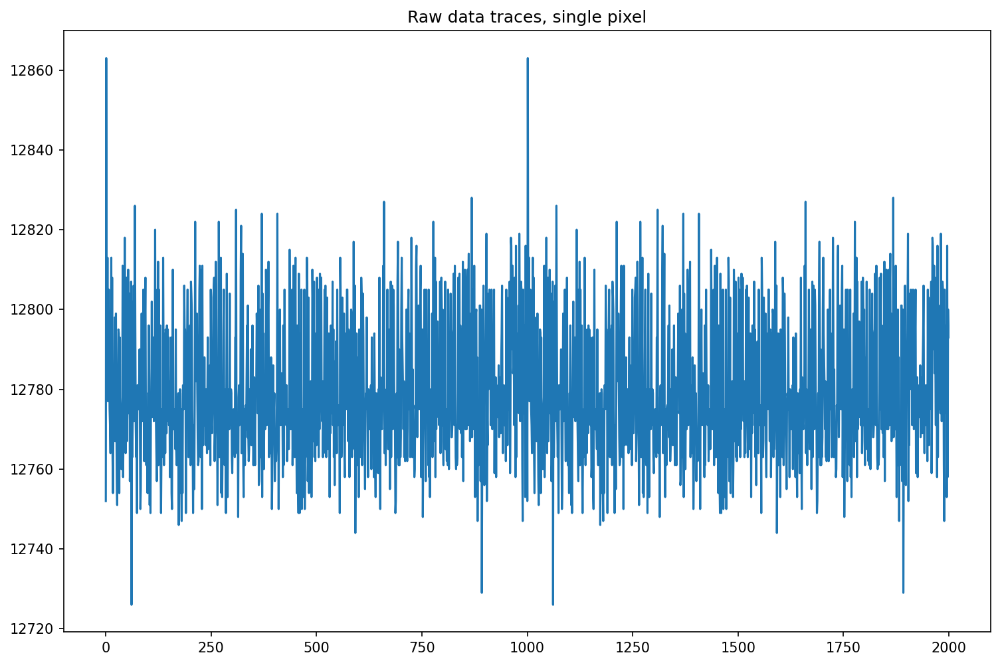

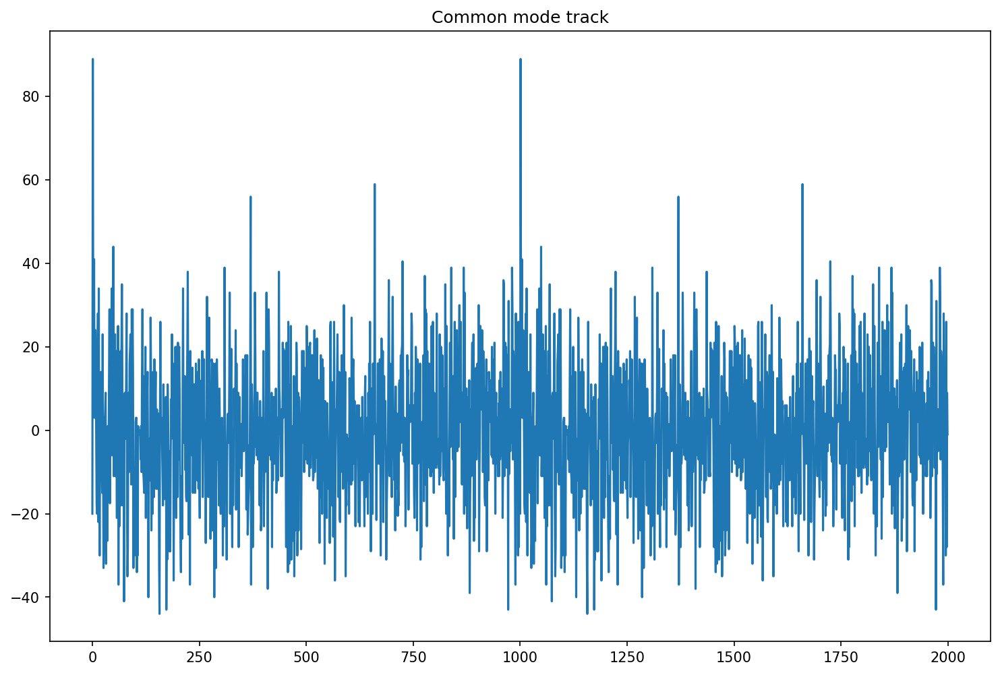

In [18]:
#Makes sure triggers are off
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.2)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(True)
time.sleep(0.2)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.2)

PreampList = [7,6,5,4,3,2,1,0]
Vld1_b = 1
Pixel_CB= 7
Filter_DAC= 17
VRef_DAC = 58
DHg = False
ASIC.DHg.set(DHg)

for Preamp in PreampList:
    setPixel (Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC)

    ######################################################################################################################
    # Remove previous dataset
    filename = (f'/u2/ddoering/ASIC_V3_ASIC2_SB_SET_4/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_%d_Vld1b_%d_PixelCB_%d_Filter_DAC_%d_VRrefdac_%d_DHg_%d_run1.dat' % (Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC, DHg))
    ########################################################################################################################
    imgDesc = run_asic_test()
    ########################################################################################################################
    [noiseMap, darkAvg] = noise_print()

Preamp 4
Vld1_b 1
Pixel_CB 4
Filter_DAC 38
VRef_DAC 53
/u2/ddoering/ASIC_V3_ASIC2_SB_SET_4/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_4_Vld1b_1_PixelCB_4_Filter_DAC_38_VRrefdac_53_DHg_0_run1.dat
Aquisition Counter 3096330
Number of frames received: 5002
Number of frames received: 6002
Number of frames received: 7003
Number of frames received: 8003
Number of frames received: 9003
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56088)
(144, 384)


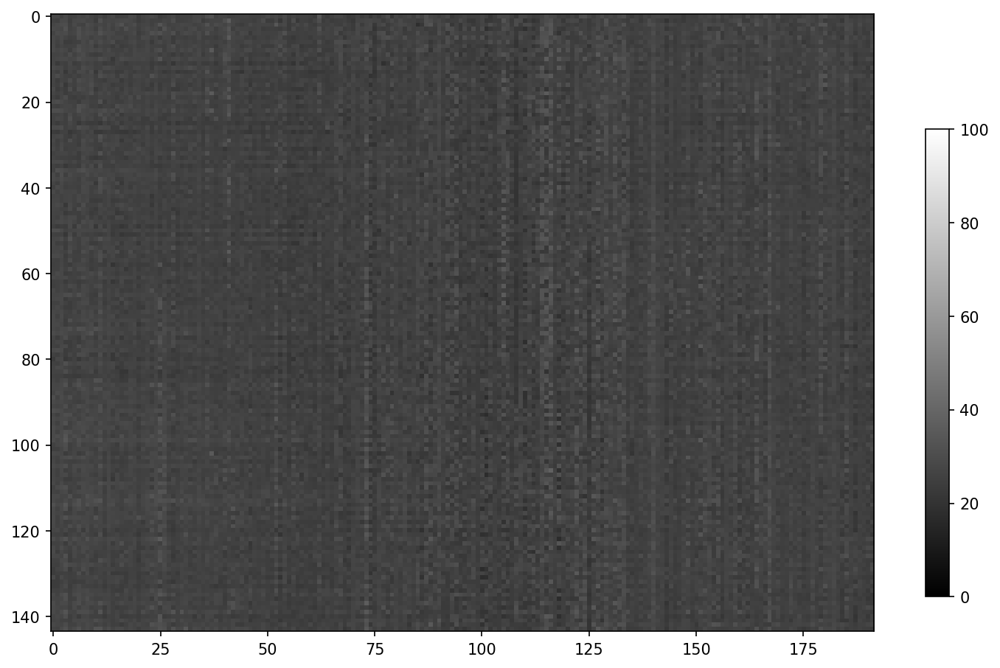

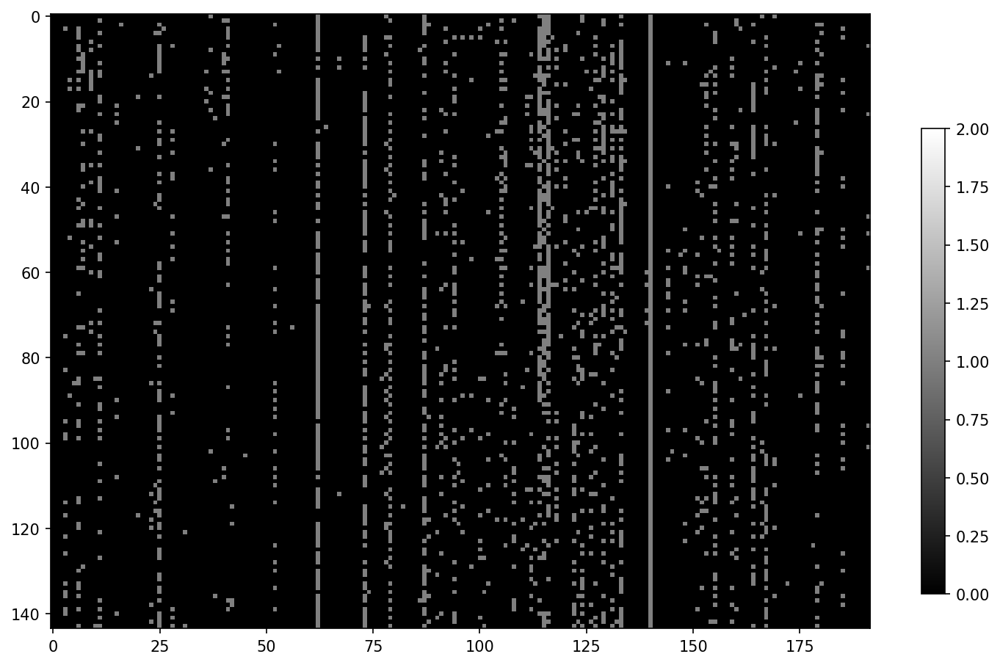

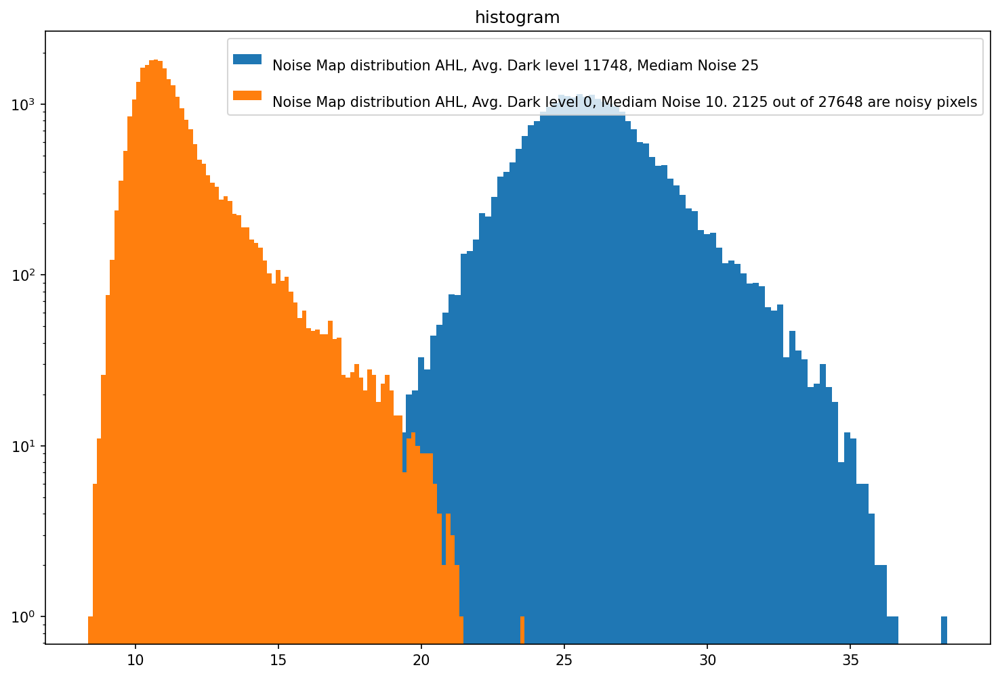

(2000, 144, 384)
(2000, 144, 192)
(2000, 144, 384)
(2000, 144, 192)
cc track shape (2000, 1, 1)
(2000, 1, 1)


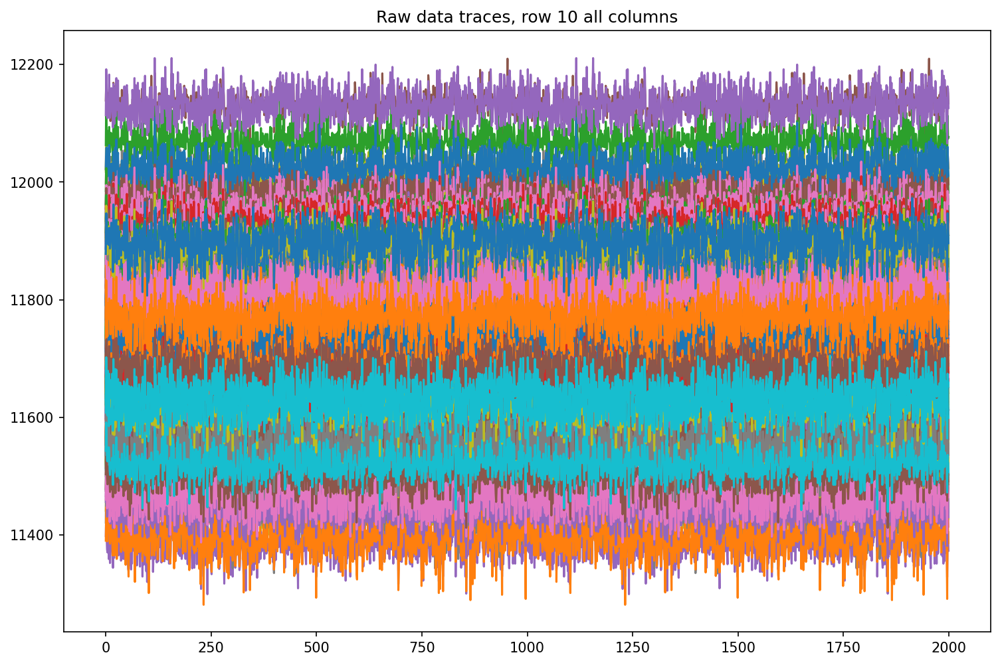

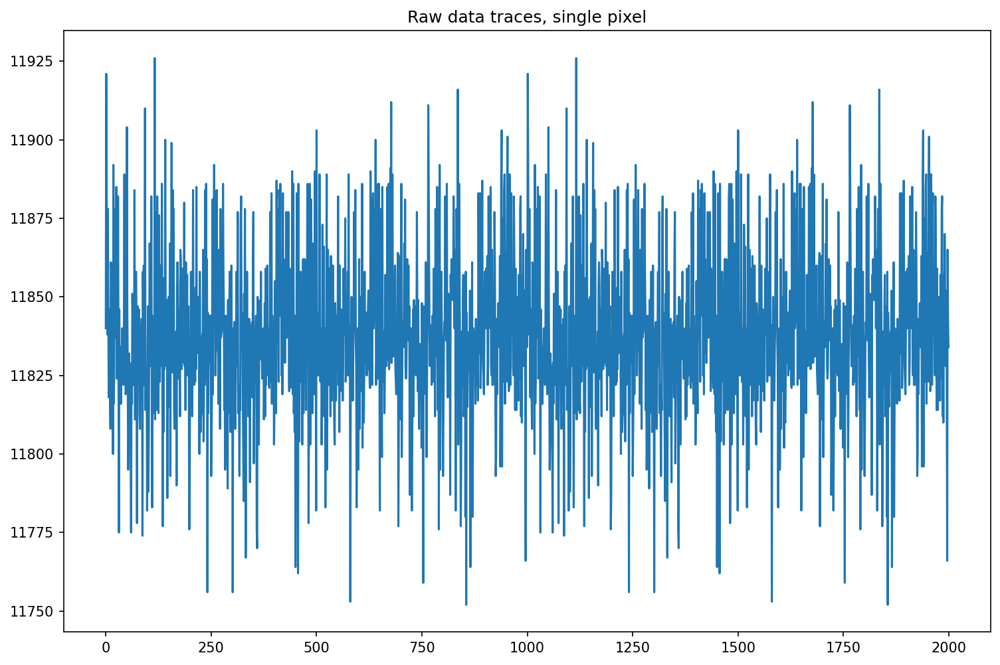

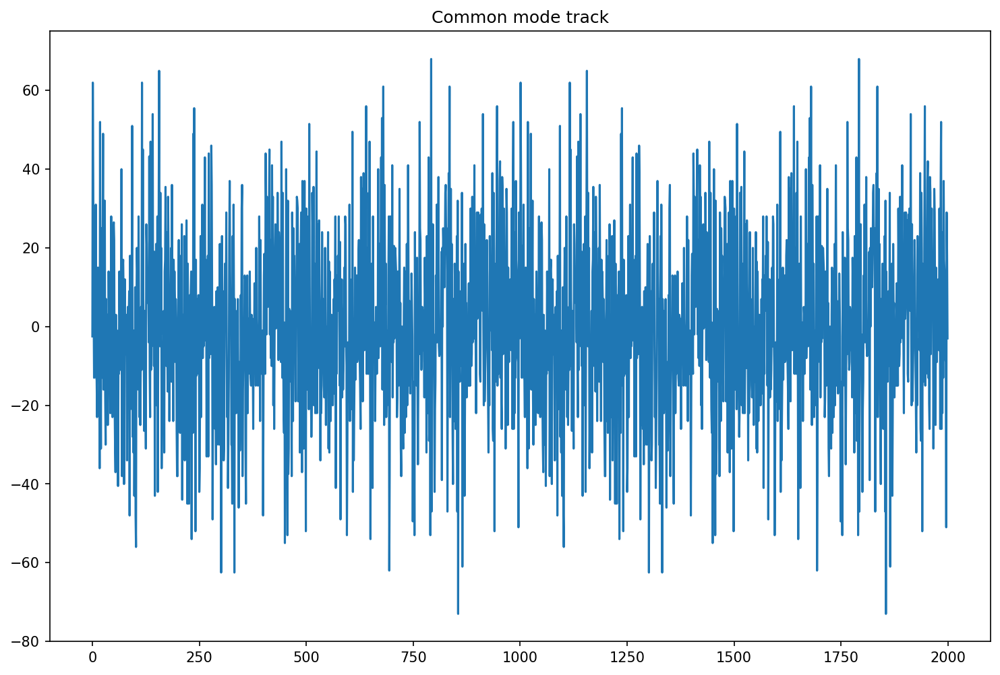

In [17]:
#Makes sure triggers are off
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.2)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(True)
time.sleep(0.2)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.2)

PreampList = [4]#,6,5,4,3,2,1,0]
Vld1_b = 1
Pixel_CB= 4
Filter_DAC= 38
VRef_DAC = 53
DHg = False
ASIC.DHg.set(DHg)

for Preamp in PreampList:
    setPixel (Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC)

    ######################################################################################################################
    # Remove previous dataset
    filename = (f'/u2/ddoering/ASIC_V3_ASIC2_SB_SET_4/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_%d_Vld1b_%d_PixelCB_%d_Filter_DAC_%d_VRrefdac_%d_DHg_%d_run1.dat' % (Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC, DHg))
    ########################################################################################################################
    imgDesc = run_asic_test()
    ########################################################################################################################
    [noiseMap, darkAvg] = noise_print()

Preamp 7
Vld1_b 1
Pixel_CB 7
Filter_DAC 17
VRef_DAC 58
/u2/ddoering/ASIC_V3_ASIC2_SB_SET_4/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_7_Vld1b_1_PixelCB_7_Filter_DAC_17_VRrefdac_58_run1.dat
Aquisition Counter 692472
Number of frames received: 5003
Number of frames received: 6004
Number of frames received: 7005
Number of frames received: 8006
Number of frames received: 9008
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56088)
(144, 384)


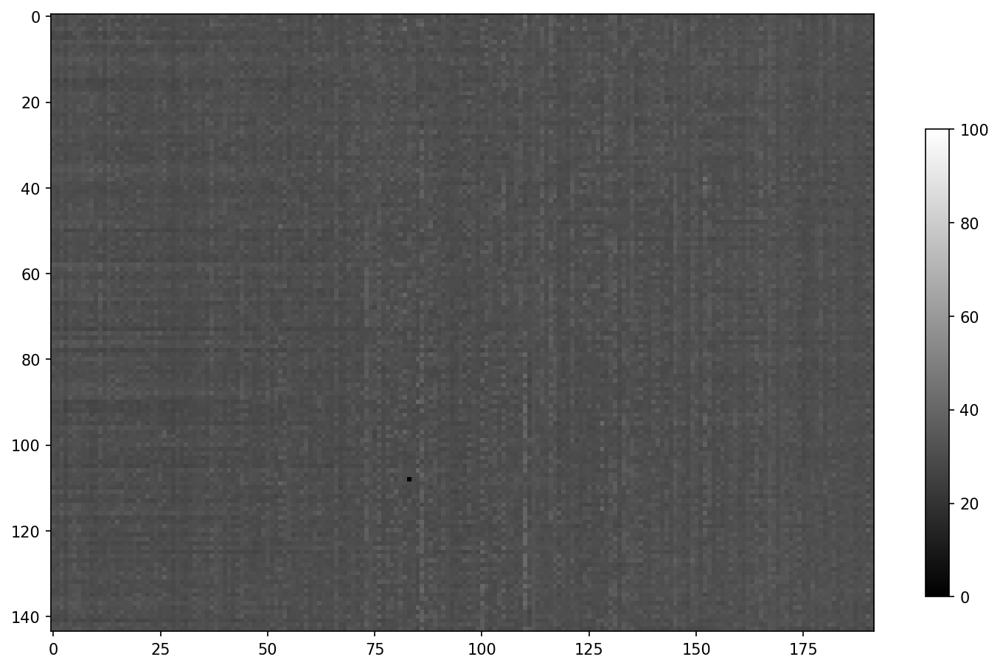

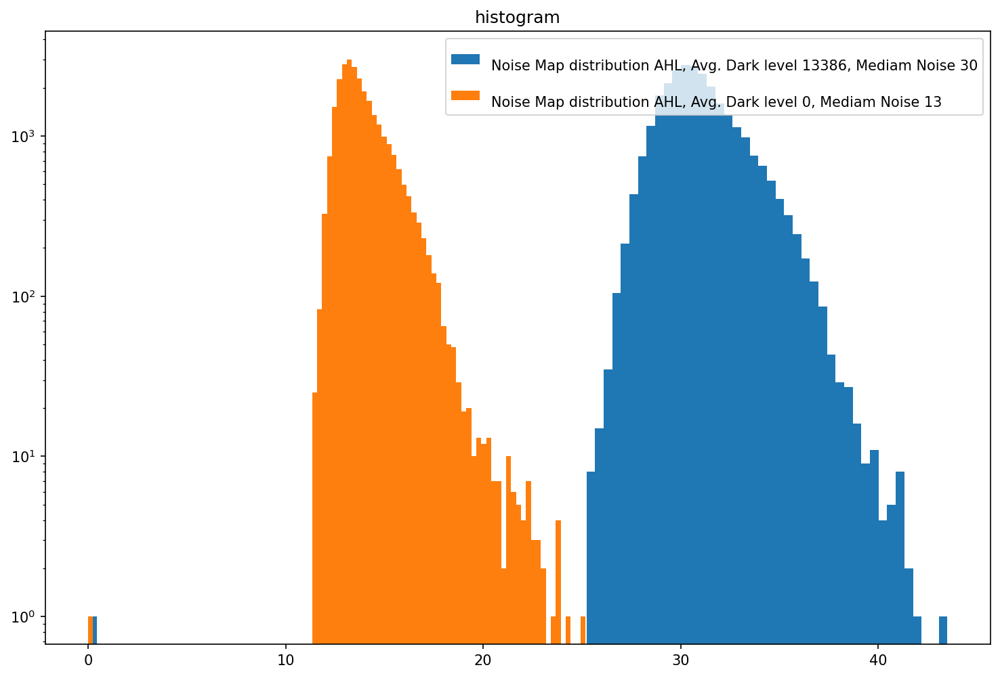

(2000, 144, 384)
(2000, 144, 192)
(2000, 144, 384)
(2000, 144, 192)


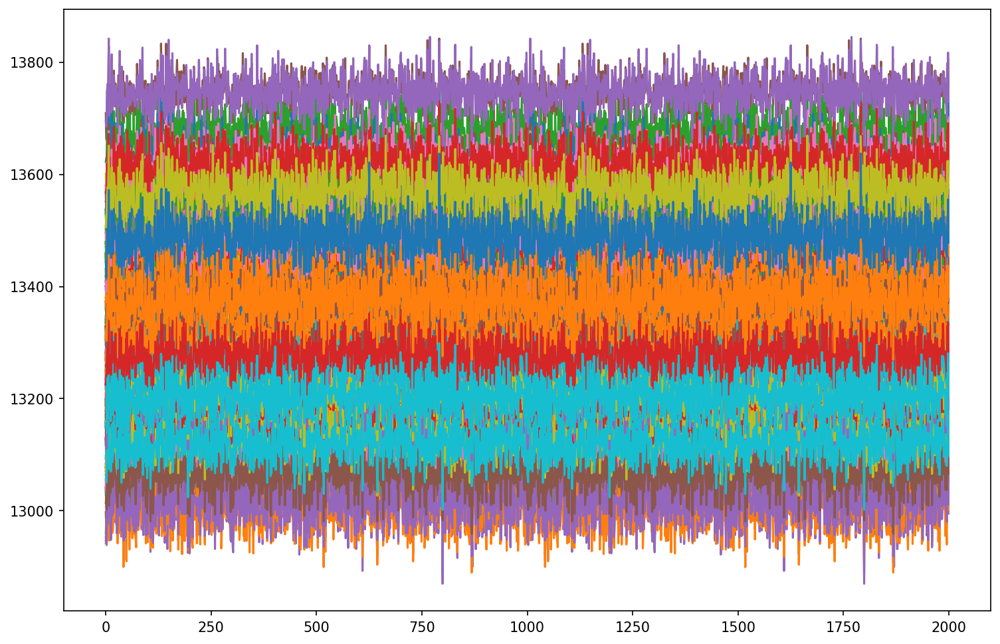

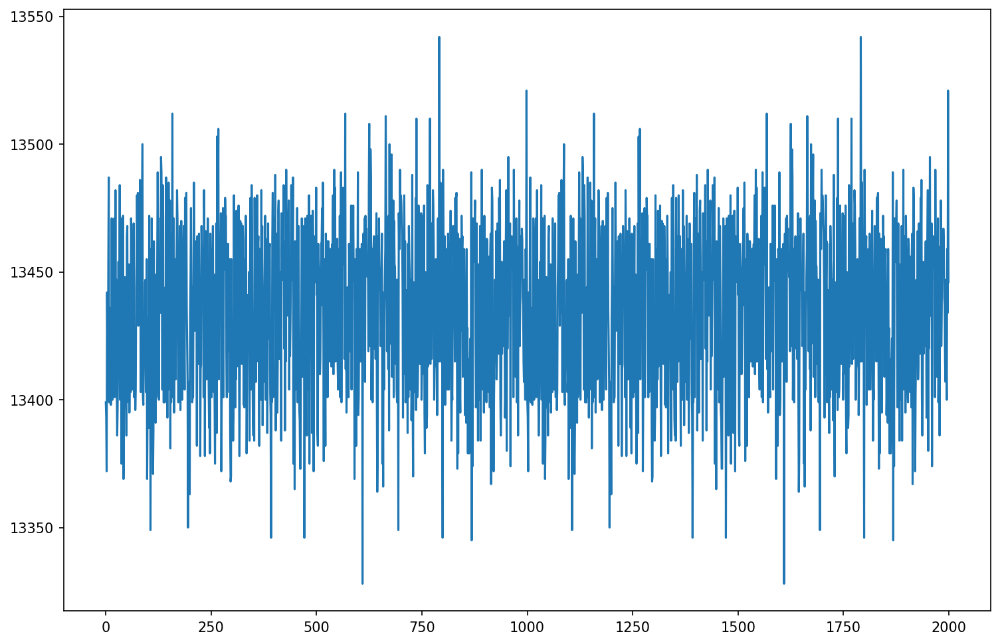

In [13]:
#Makes sure triggers are off
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.2)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(True)
time.sleep(0.2)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.2)

PreampList = [7]#,6,5,4,3,2,1,0]
Vld1_b = 1
Pixel_CB= 7
Filter_DAC= 17
VRef_DAC = 58

for Preamp in PreampList:
    setPixel (Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC)

    ######################################################################################################################
    # Remove previous dataset
    filename = (f'/u2/ddoering/ASIC_V3_ASIC2_SB_SET_4/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_%d_Vld1b_%d_PixelCB_%d_Filter_DAC_%d_VRrefdac_%d_run1.dat' % (Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC))
    ########################################################################################################################
    imgDesc = run_asic_test()
    ########################################################################################################################
    [noiseMap, darkAvg] = noise_print()

Preamp 7
Vld1_b 1
Pixel_CB 7
Filter_DAC 17
VRef_DAC 58
/u2/ddoering/ASIC_V3_ASIC2_SB_SET_4/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_7_Vld1b_1_PixelCB_7_Filter_DAC_17_VRrefdac_58_AcqDAndAcqW15000run1.dat
Aquisition Counter 853180
Number of frames received: 5001
Number of frames received: 6002
Number of frames received: 7003
Number of frames received: 8003
Number of frames received: 9005
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56088)
(144, 384)


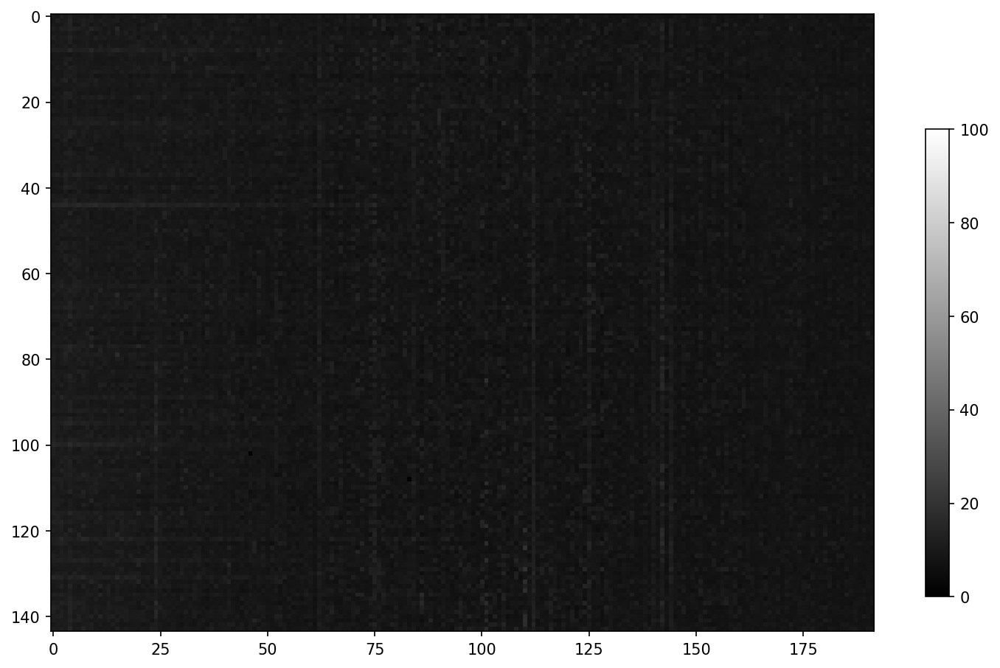

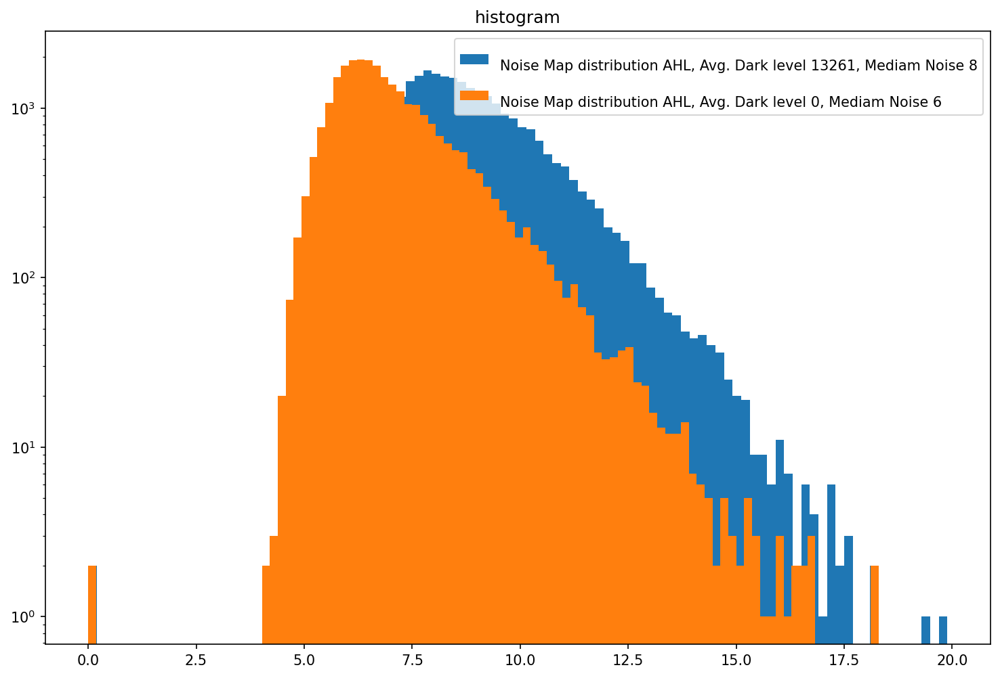

(2000, 144, 384)
(2000, 144, 192)
(2000, 144, 384)
(2000, 144, 192)
Preamp 6
Vld1_b 1
Pixel_CB 7
Filter_DAC 17
VRef_DAC 58
/u2/ddoering/ASIC_V3_ASIC2_SB_SET_4/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_6_Vld1b_1_PixelCB_7_Filter_DAC_17_VRrefdac_58_AcqDAndAcqW15000run1.dat
Aquisition Counter 862185
Number of frames received: 5003
Number of frames received: 6004
Number of frames received: 7005
Number of frames received: 8006
Number of frames received: 9008
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56088)
(144, 384)


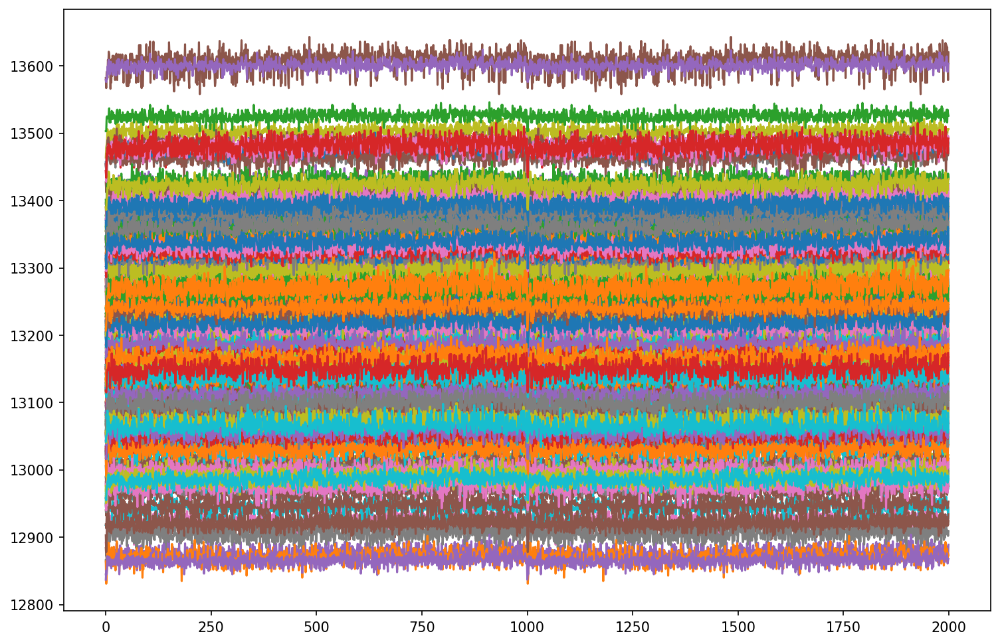

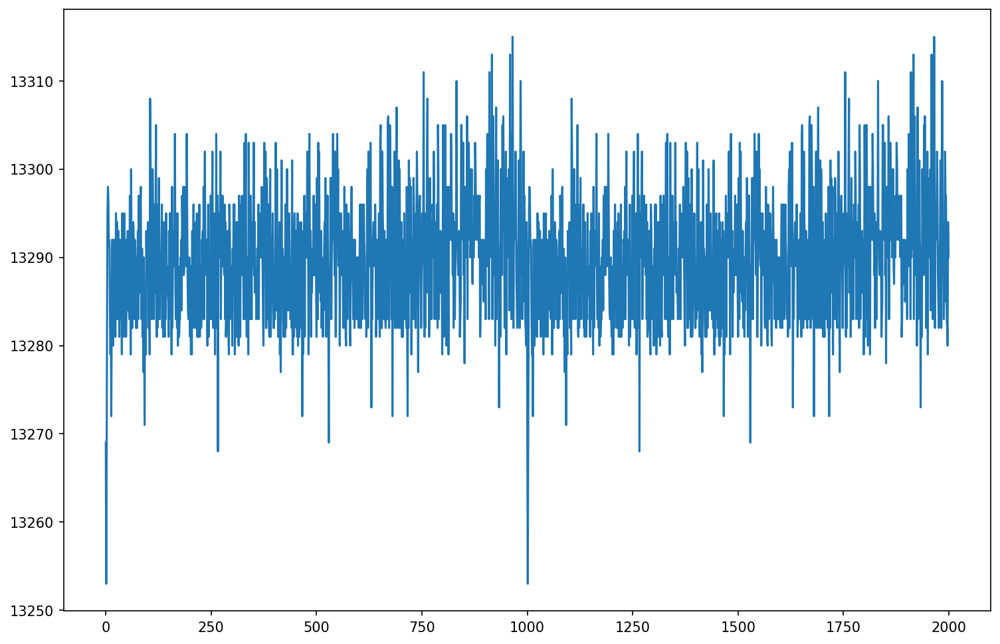

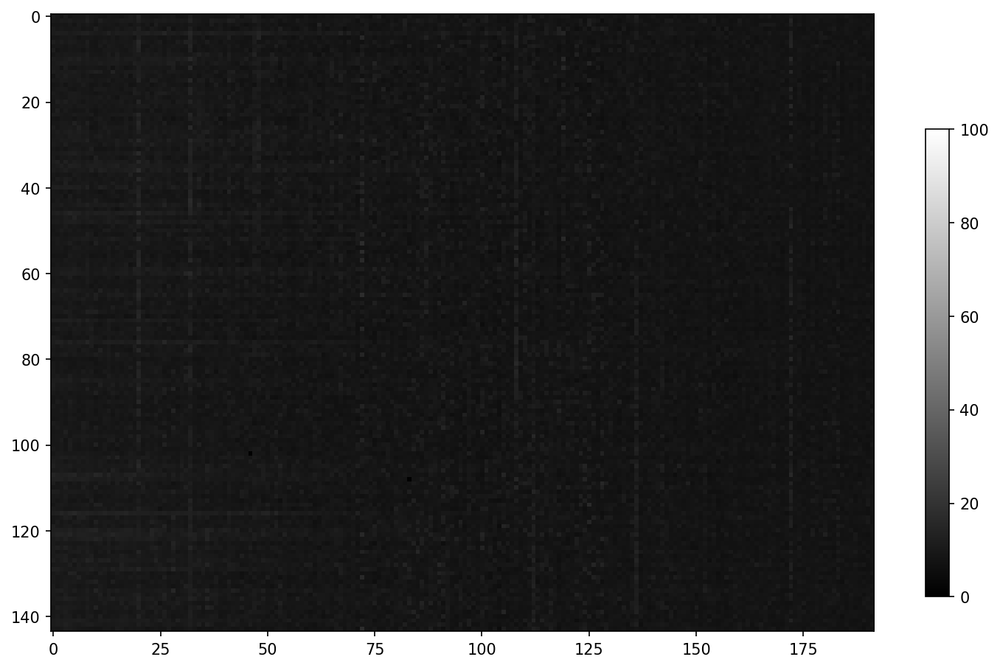

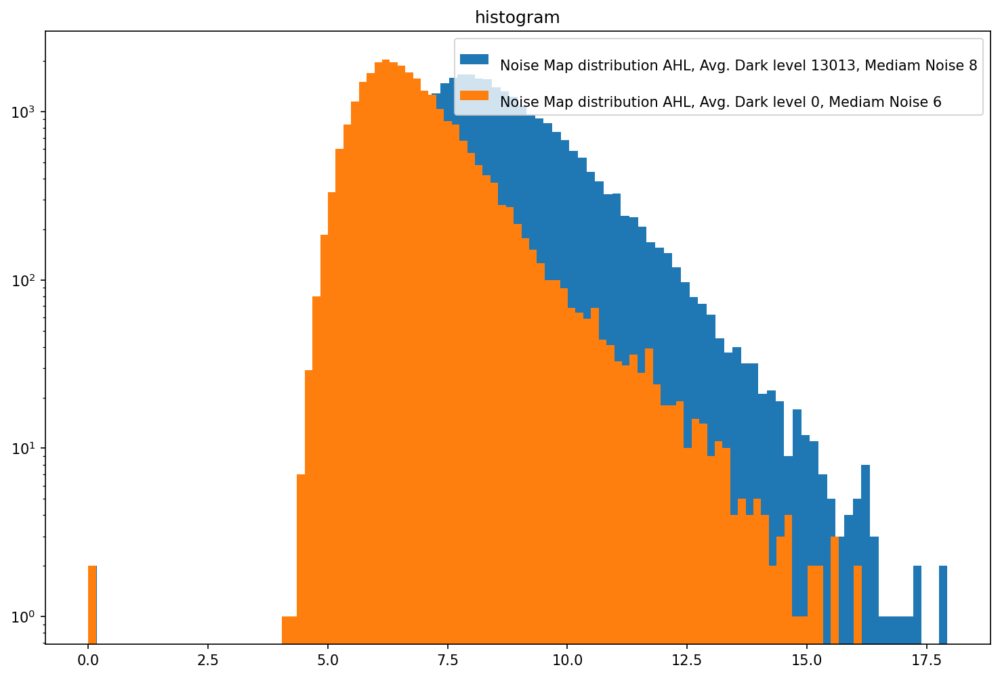

(2000, 144, 384)
(2000, 144, 192)
(2000, 144, 384)
(2000, 144, 192)
Preamp 5
Vld1_b 1
Pixel_CB 7
Filter_DAC 17
VRef_DAC 58
/u2/ddoering/ASIC_V3_ASIC2_SB_SET_4/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_5_Vld1b_1_PixelCB_7_Filter_DAC_17_VRrefdac_58_AcqDAndAcqW15000run1.dat
Aquisition Counter 871193
Number of frames received: 1003
Number of frames received: 1003
Number of frames received: 1003
Number of frames received: 1003
Number of frames received: 1003
Number of frames received: 1003
Number of frames received: 1003
Number of frames received: 1003
Number of frames received: 1003
Number of frames received: 1003
Number of frames received: 1003
Number of frames received: 1003
Number of frames received: 1003
Number of frames received: 1003
Number of frames received: 1003
Number of frames received: 1003
Number of frames received: 1003
Number of frames received: 1003
Number of frames received: 1003
Number of frames received: 1003
Number of frames received: 1003
Number of frames

KeyboardInterrupt: 

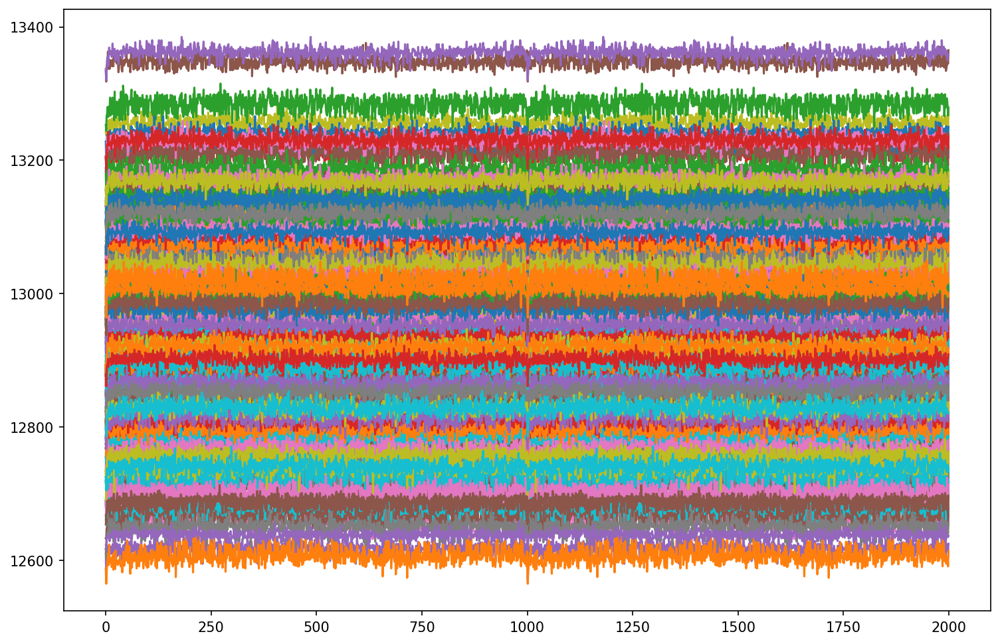

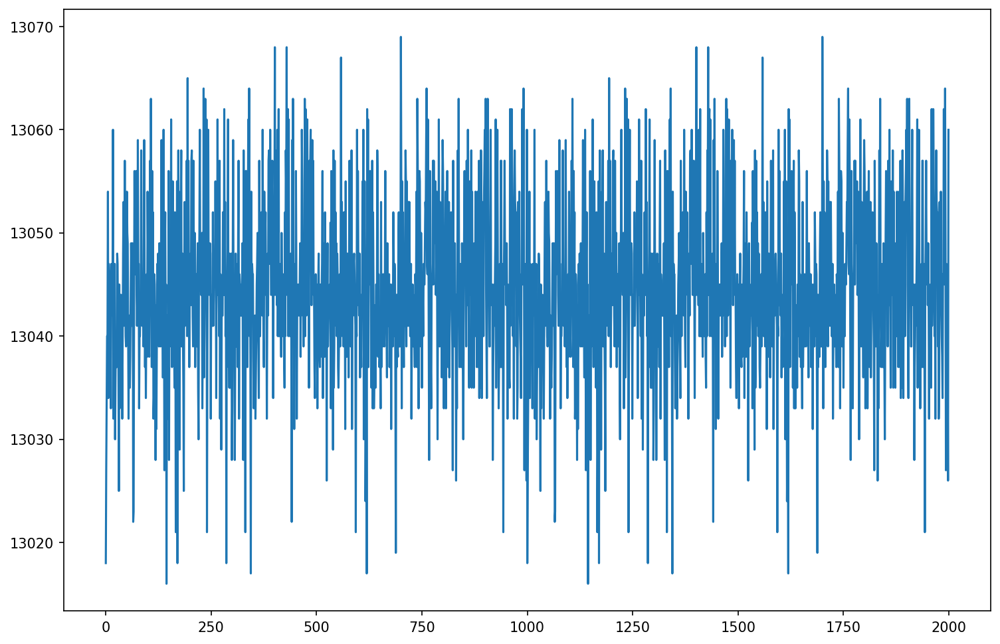

In [18]:
#set manually ACQ delay to 15000, to make the same value as ACQ width
root.EpixHR.RegisterControl.AcqDelay1.set(15000)
root.EpixHR.RegisterControl.R0Width.set(64800+15000-2400)
#Makes sure triggers are off
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.2)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(True)
time.sleep(0.2)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.2)

PreampList = [7,6,5,4,3,2,1,0]
Vld1_b = 1
Pixel_CB= 7
Filter_DAC= 17
VRef_DAC = 58

for Preamp in PreampList:
    setPixel (Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC)

    ######################################################################################################################
    # Remove previous dataset
    filename = (f'/u2/ddoering/ASIC_V3_ASIC2_SB_SET_4/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_%d_Vld1b_%d_PixelCB_%d_Filter_DAC_%d_VRrefdac_%d_AcqDAndAcqW15000run1.dat' % (Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC))
    ########################################################################################################################
    imgDesc = run_asic_test()
    ########################################################################################################################
    [noiseMap, darkAvg] = noise_print()

/u2/ddoering/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_7_Vld1b_1_PixelCB_7_Filter_DAC_17_VRrefdac_58_AcqWidth_1_us_run1.dat
Aquisition Counter 2762746
Number of frames received: 5003
Number of frames received: 6004
Number of frames received: 7005
Number of frames received: 8006
Number of frames received: 9007
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56088)
(144, 384)


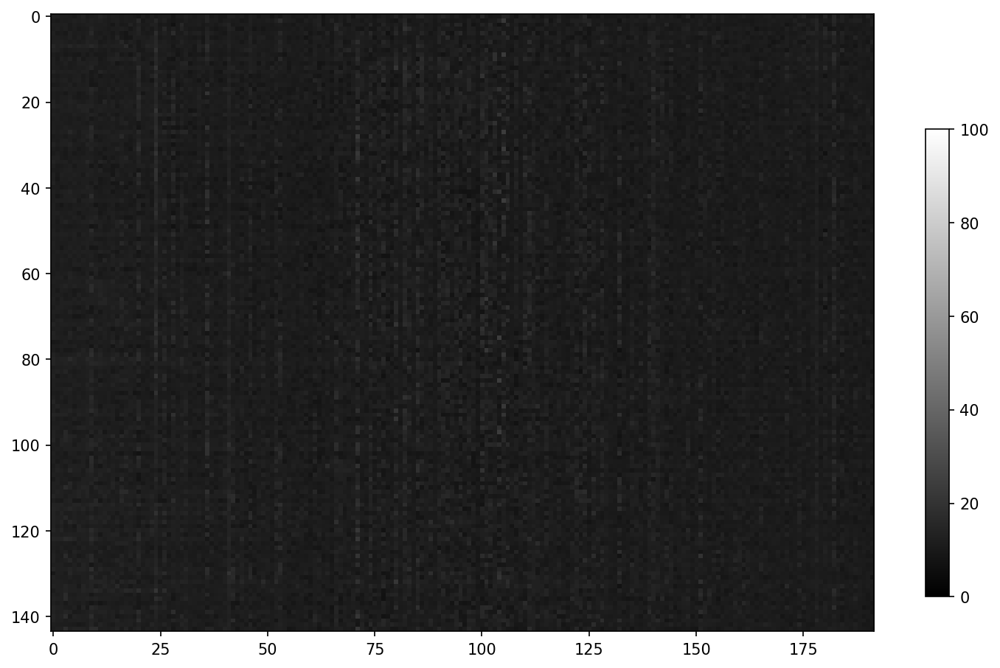

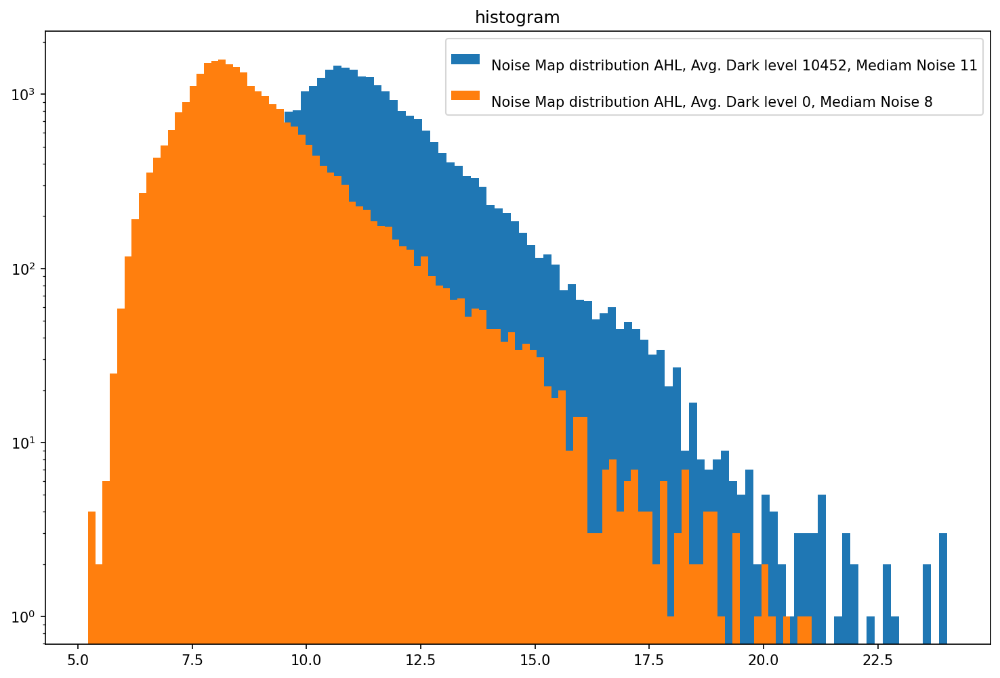

(2000, 144, 384)
(2000, 144, 192)
(2000, 144, 384)
(2000, 144, 192)
/u2/ddoering/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_7_Vld1b_1_PixelCB_7_Filter_DAC_17_VRrefdac_58_AcqWidth_2_us_run1.dat
Aquisition Counter 2771753
Number of frames received: 5003
Number of frames received: 6004
Number of frames received: 7005
Number of frames received: 8006
Number of frames received: 9008
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56088)
(144, 384)


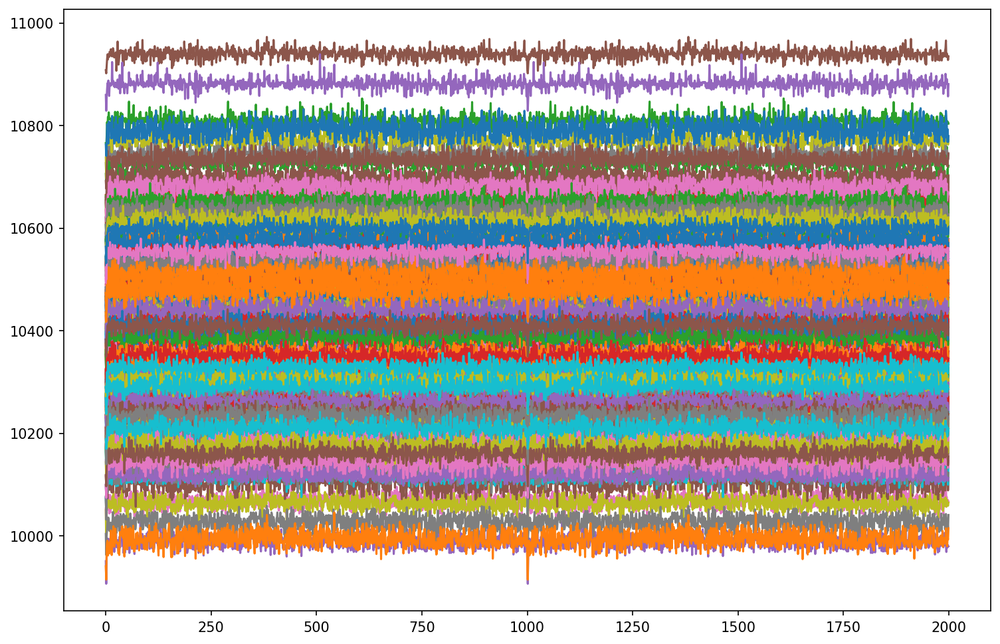

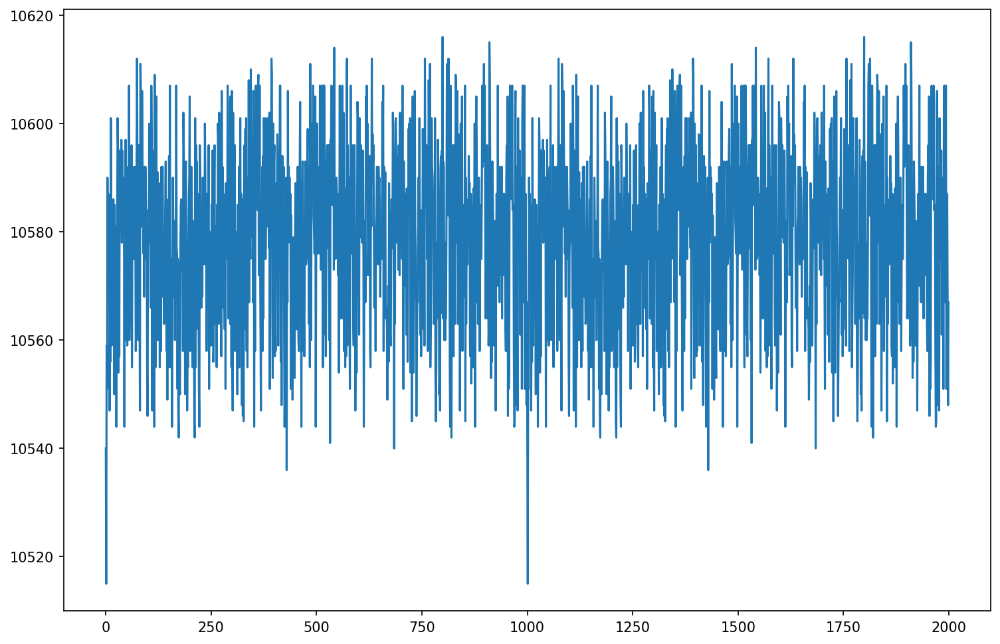

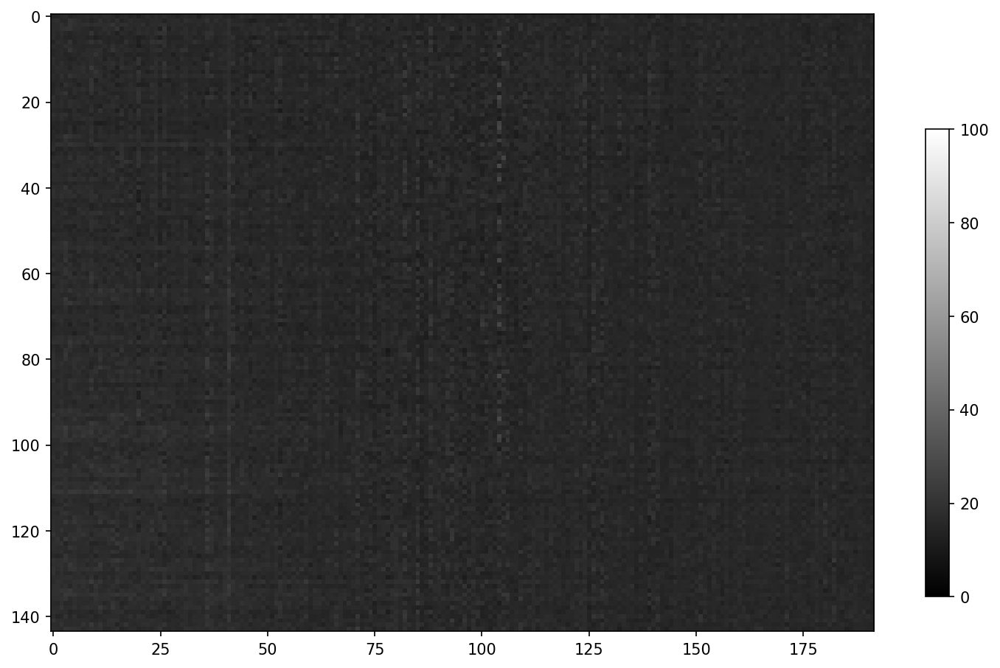

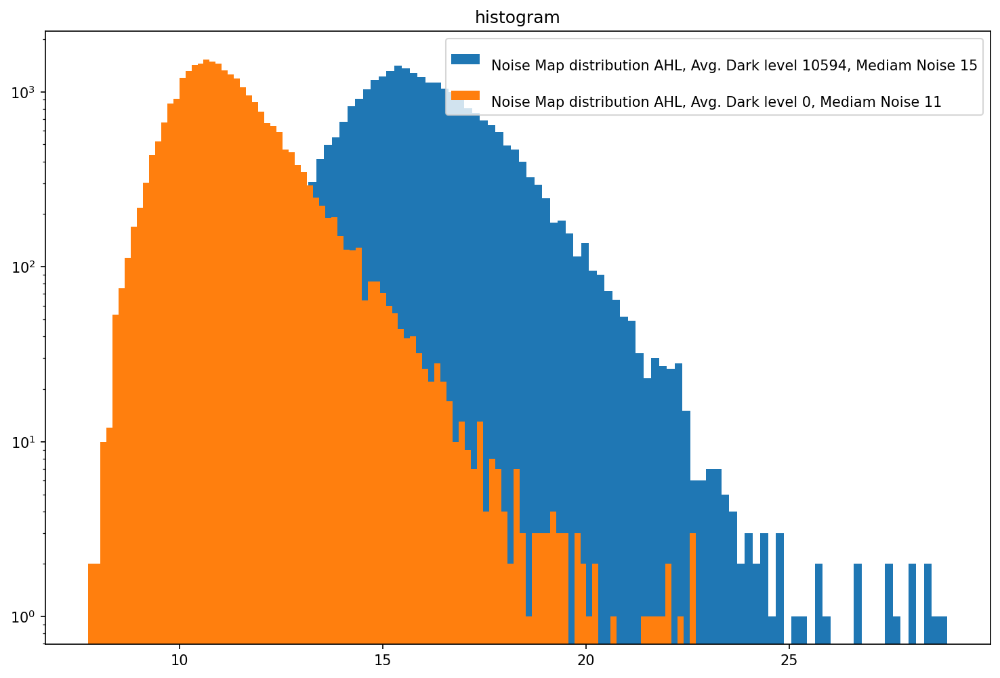

(2000, 144, 384)
(2000, 144, 192)
(2000, 144, 384)
(2000, 144, 192)
/u2/ddoering/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_7_Vld1b_1_PixelCB_7_Filter_DAC_17_VRrefdac_58_AcqWidth_4_us_run1.dat
Aquisition Counter 2780761
Number of frames received: 5003
Number of frames received: 6004
Number of frames received: 7006
Number of frames received: 8007
Number of frames received: 9008
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56088)
(144, 384)


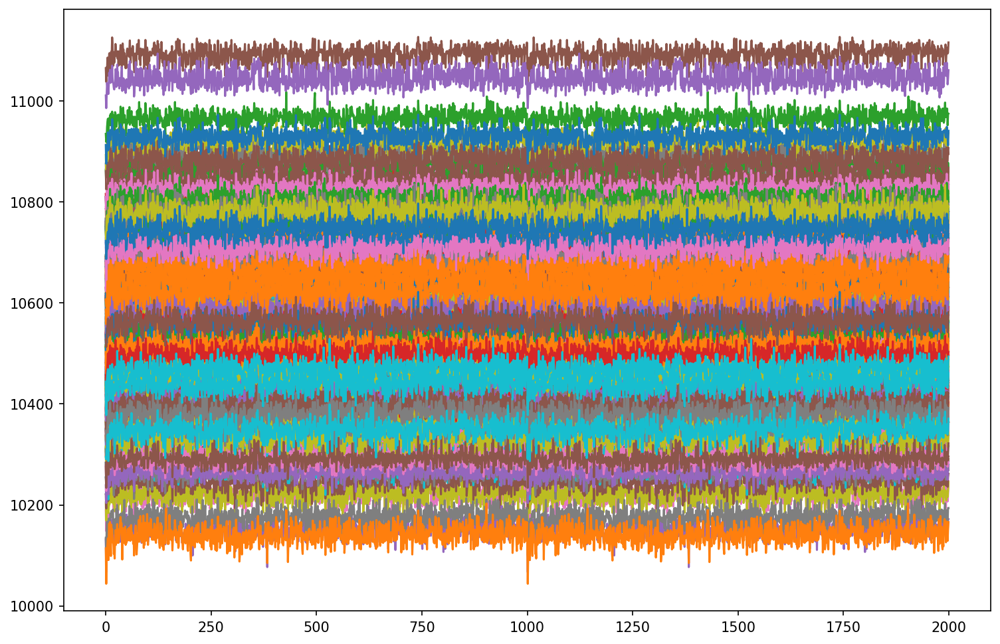

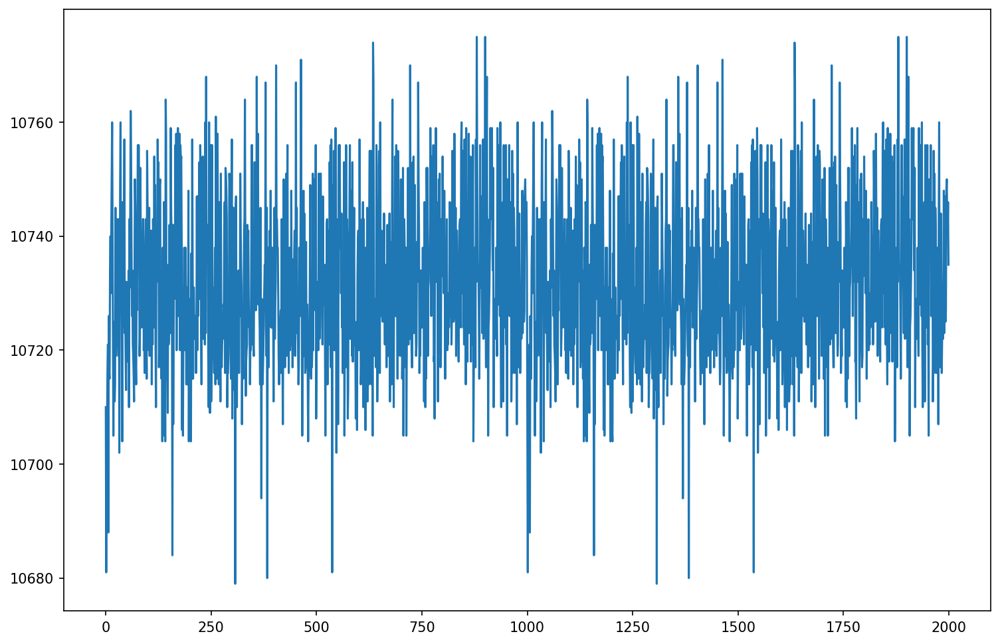

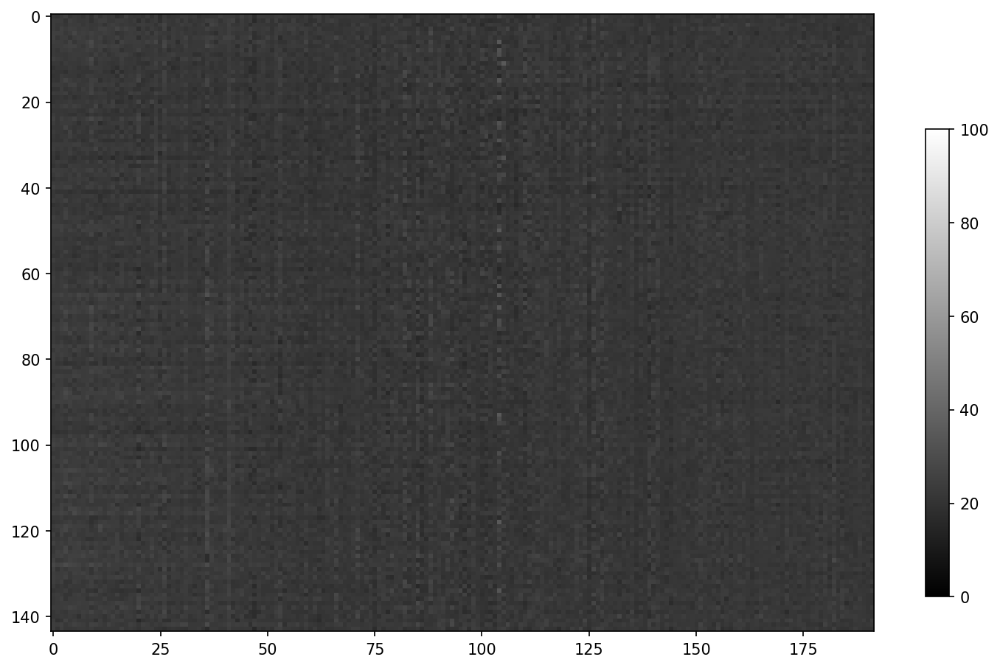

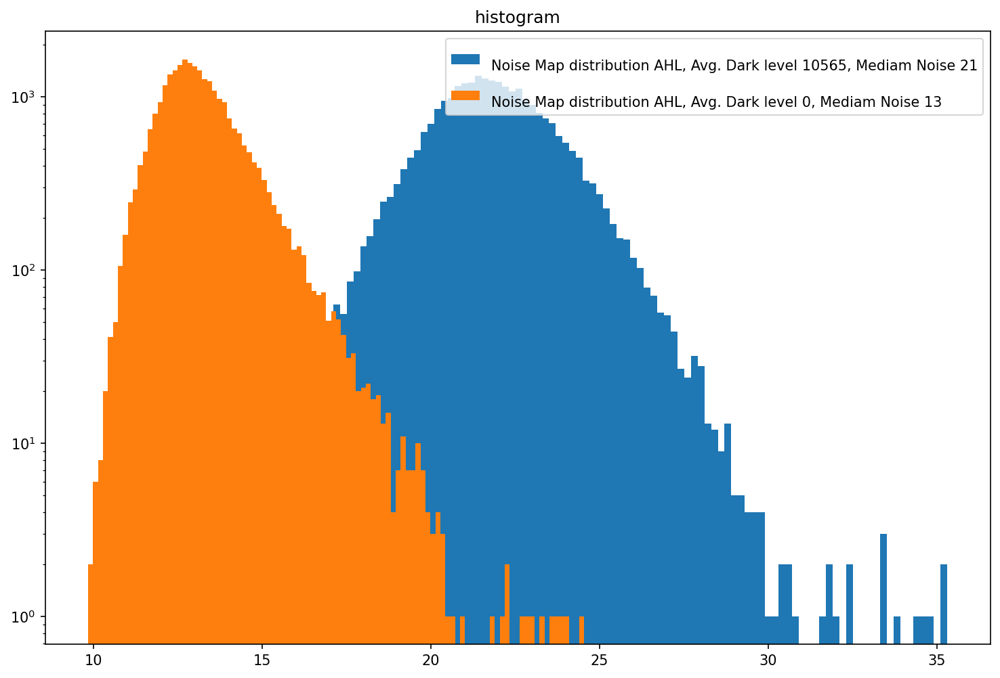

(2000, 144, 384)
(2000, 144, 192)
(2000, 144, 384)
(2000, 144, 192)
/u2/ddoering/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_7_Vld1b_1_PixelCB_7_Filter_DAC_17_VRrefdac_58_AcqWidth_8_us_run1.dat
Aquisition Counter 2789769
Number of frames received: 5003
Number of frames received: 6005
Number of frames received: 7006
Number of frames received: 8007
Number of frames received: 9008
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56088)
(144, 384)


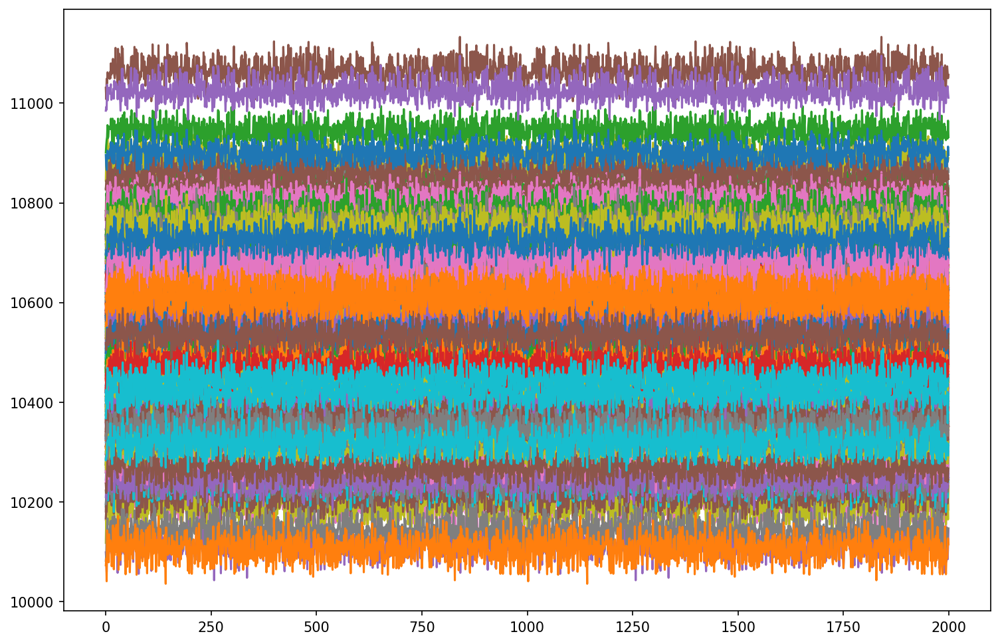

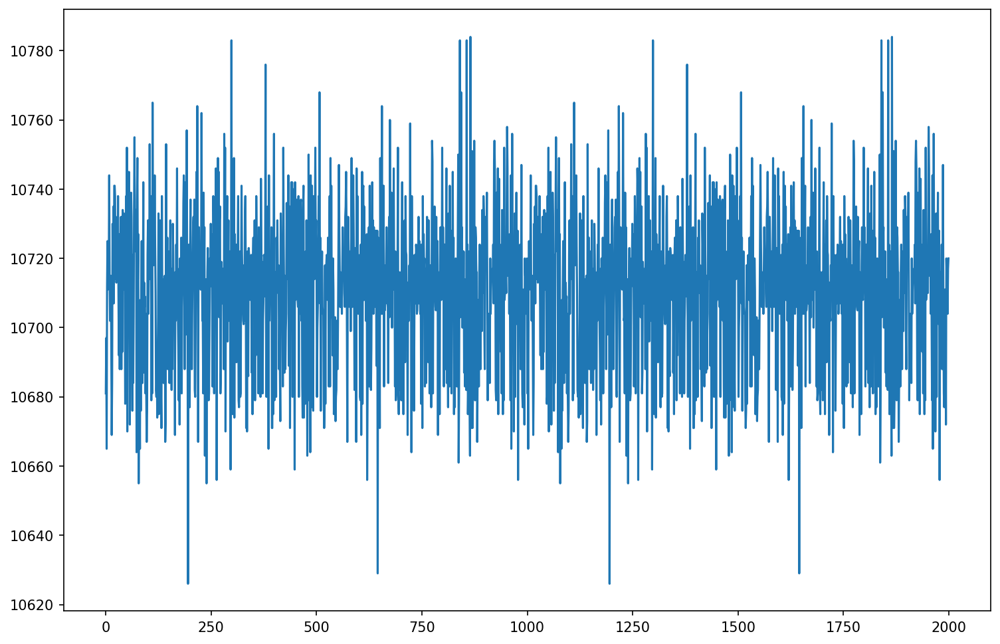

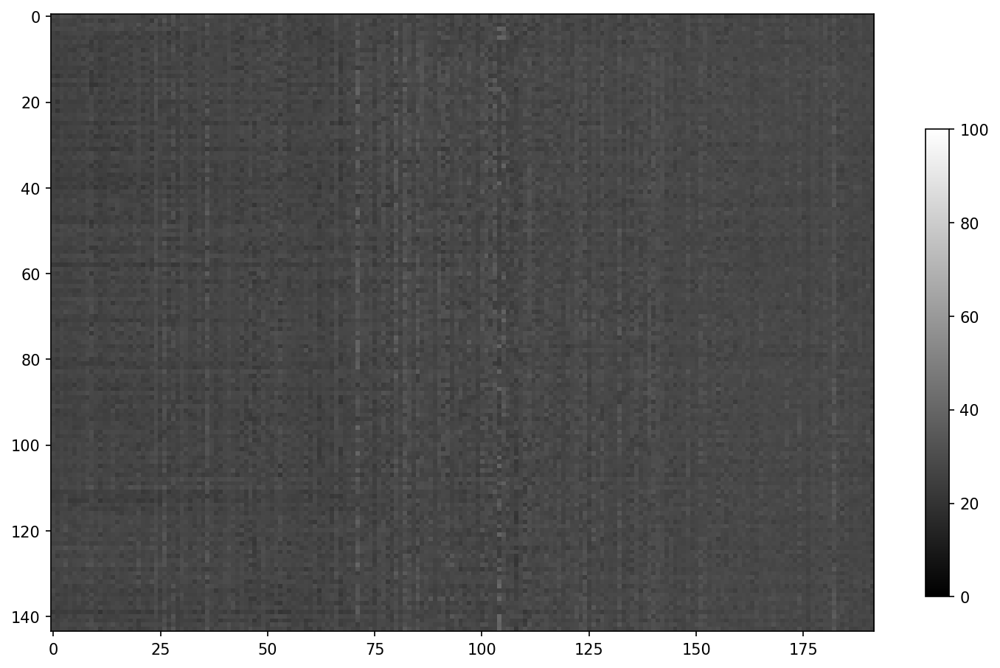

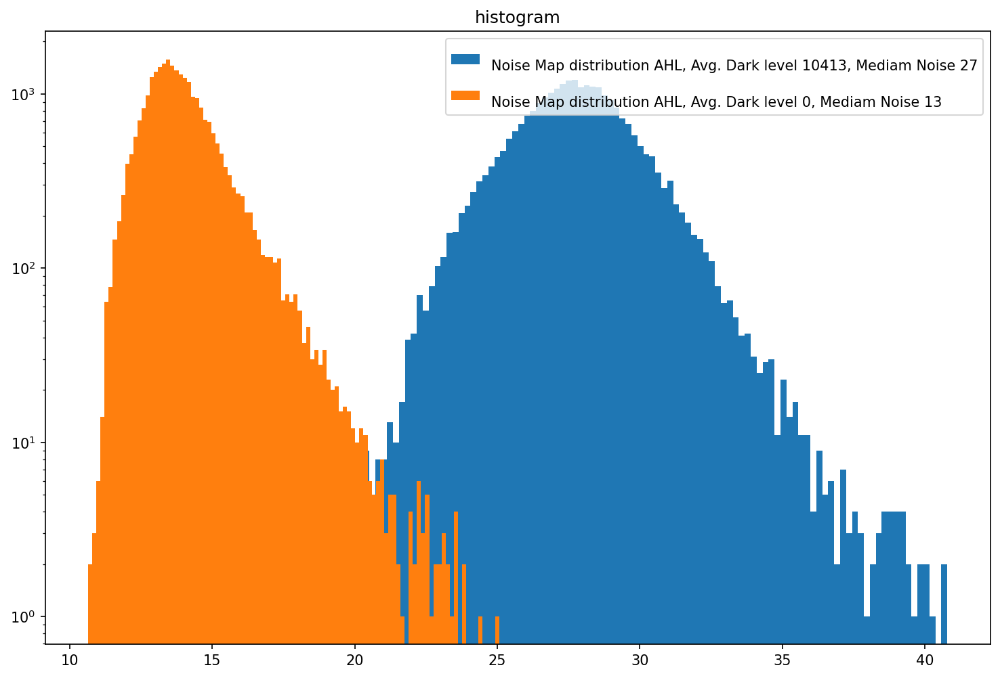

(2000, 144, 384)
(2000, 144, 192)
(2000, 144, 384)
(2000, 144, 192)
/u2/ddoering/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_7_Vld1b_1_PixelCB_7_Filter_DAC_17_VRrefdac_58_AcqWidth_16_us_run1.dat
Aquisition Counter 2798777
Number of frames received: 5004
Number of frames received: 6005
Number of frames received: 7006
Number of frames received: 8007
Number of frames received: 9008
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56088)
(144, 384)


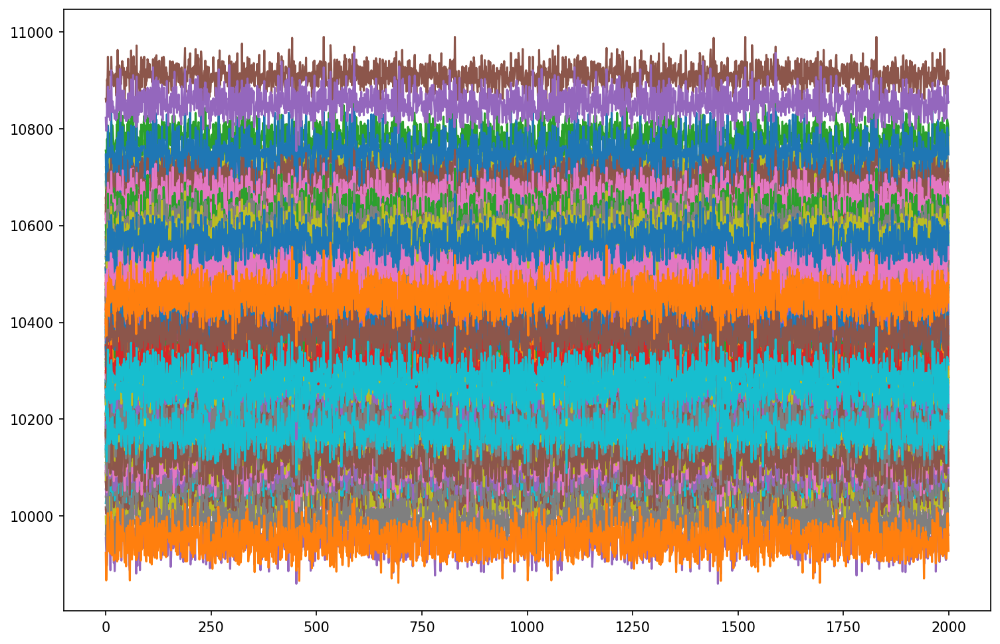

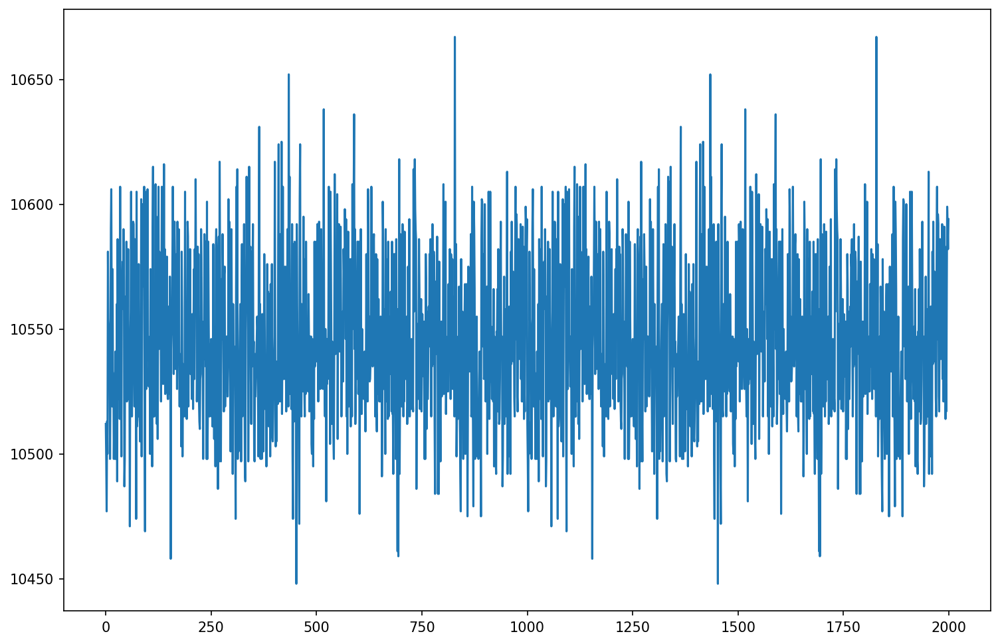

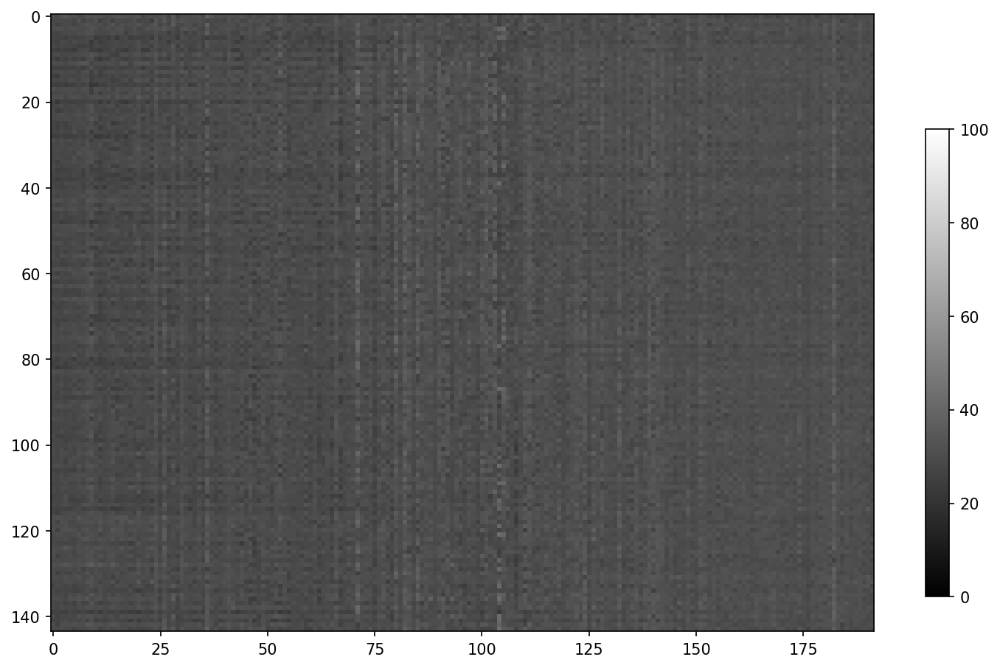

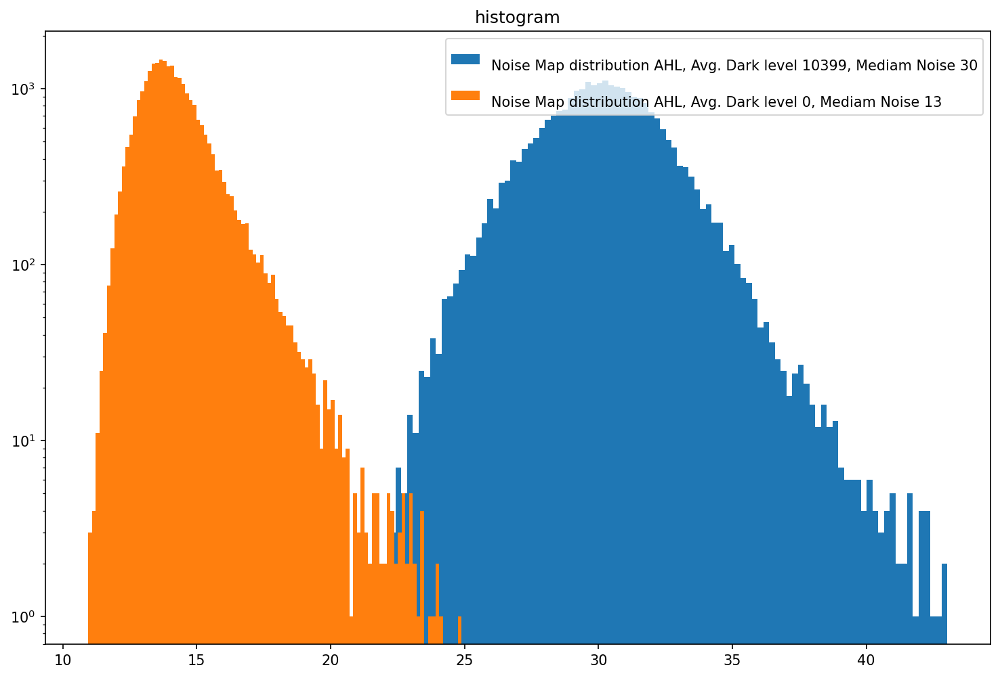

(2000, 144, 384)
(2000, 144, 192)
(2000, 144, 384)
(2000, 144, 192)
/u2/ddoering/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_7_Vld1b_1_PixelCB_7_Filter_DAC_17_VRrefdac_58_AcqWidth_32_us_run1.dat
Aquisition Counter 2807785
Number of frames received: 5004
Number of frames received: 6005
Number of frames received: 7006
Number of frames received: 8007
Number of frames received: 9009
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56088)
(144, 384)


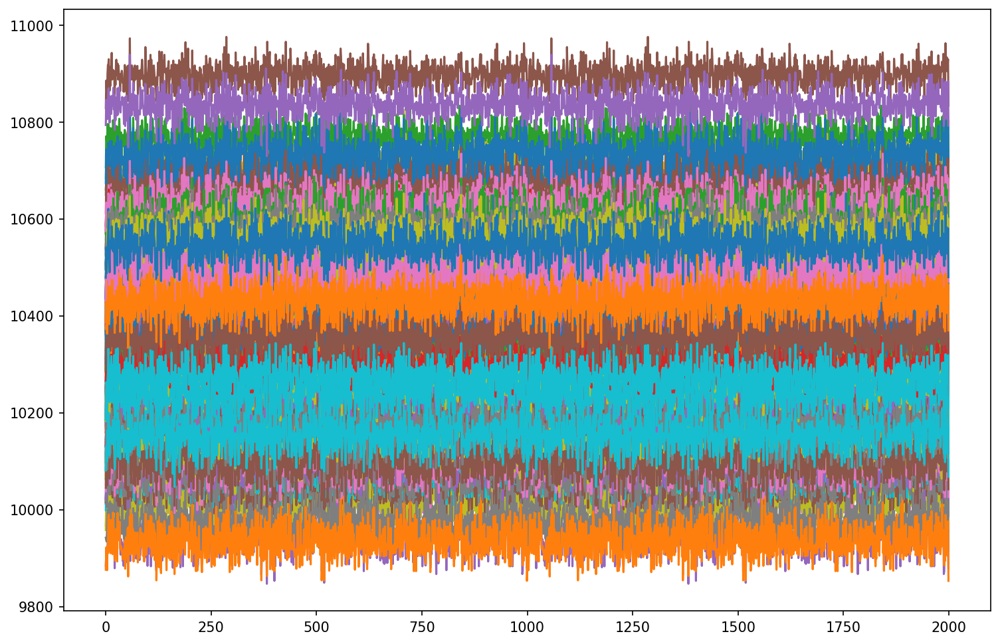

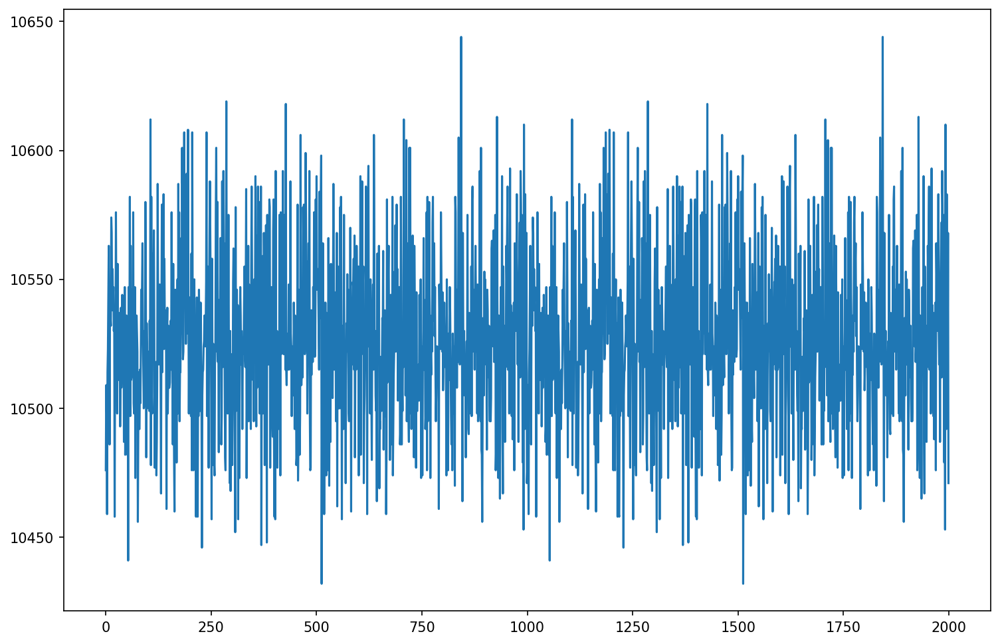

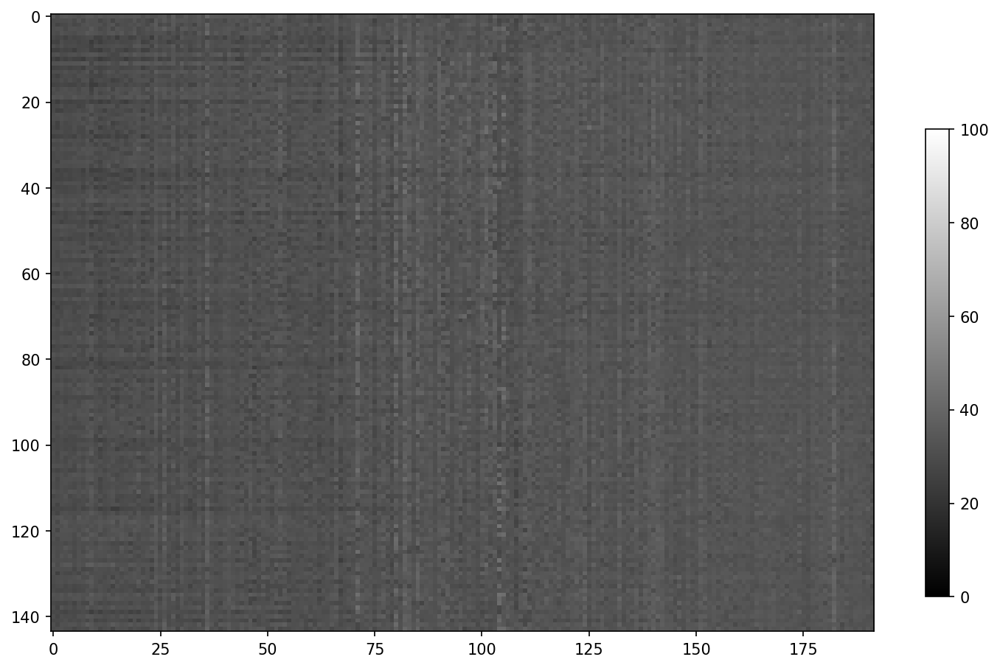

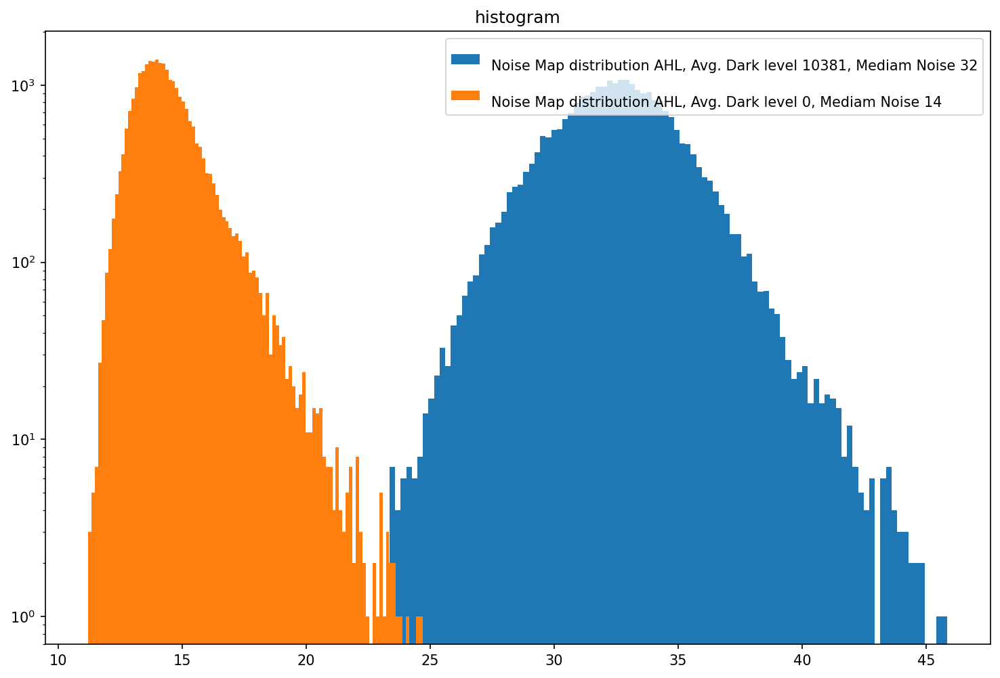

(2000, 144, 384)
(2000, 144, 192)
(2000, 144, 384)
(2000, 144, 192)
/u2/ddoering/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_7_Vld1b_1_PixelCB_7_Filter_DAC_17_VRrefdac_58_AcqWidth_64_us_run1.dat
Aquisition Counter 2816794
Number of frames received: 5003
Number of frames received: 6004
Number of frames received: 7005
Number of frames received: 8006
Number of frames received: 9008
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56088)
(144, 384)


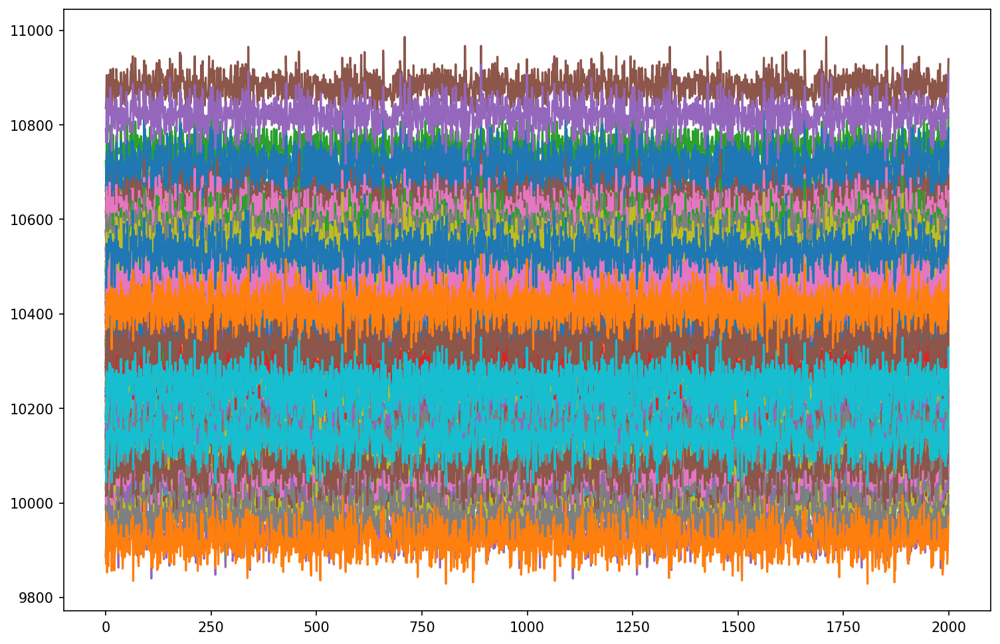

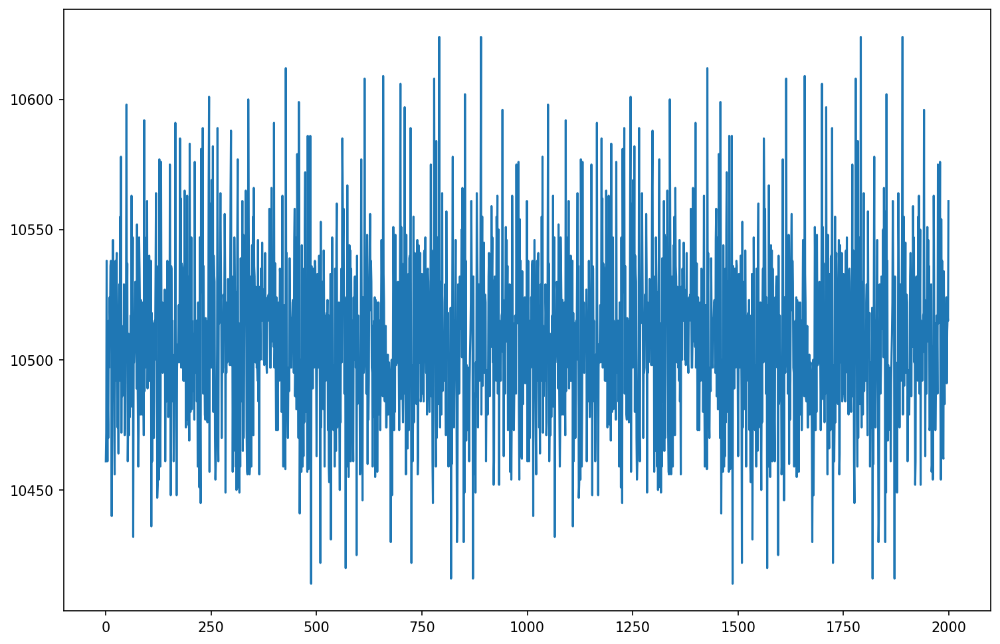

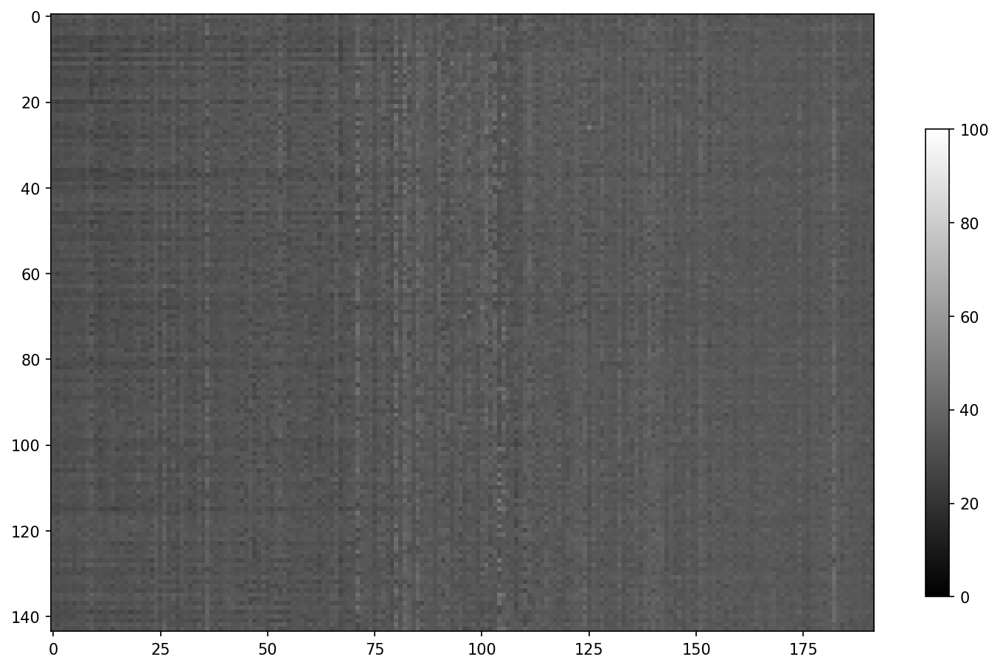

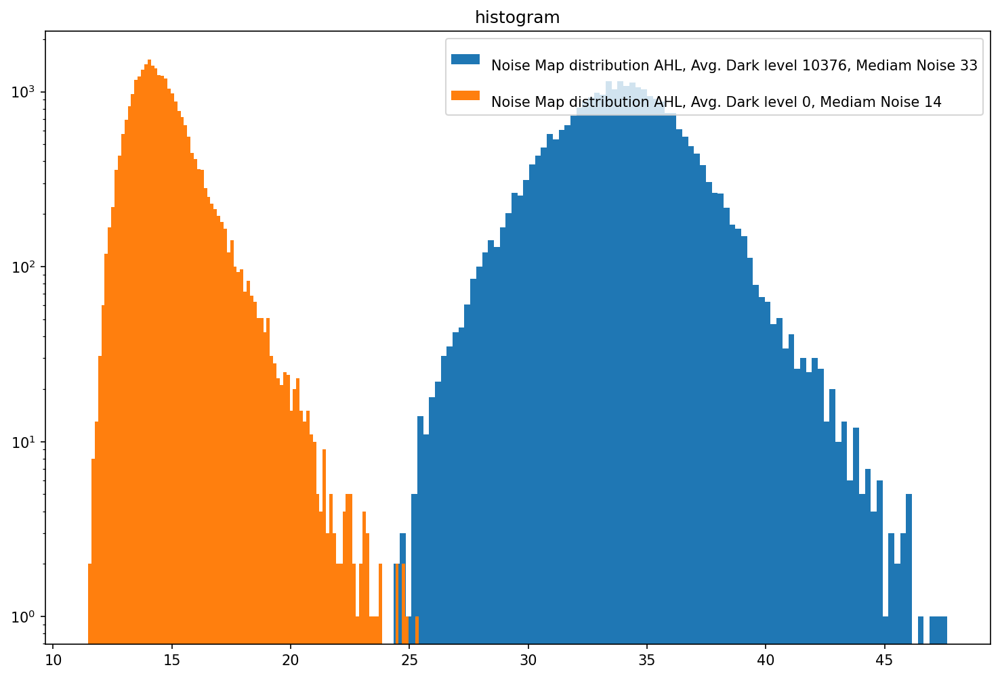

(2000, 144, 384)
(2000, 144, 192)
(2000, 144, 384)
(2000, 144, 192)
/u2/ddoering/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_7_Vld1b_1_PixelCB_7_Filter_DAC_17_VRrefdac_58_AcqWidth_128_us_run1.dat
Aquisition Counter 2825802
Number of frames received: 5003
Number of frames received: 6004
Number of frames received: 7005
Number of frames received: 8006
Number of frames received: 9008
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56088)
(144, 384)


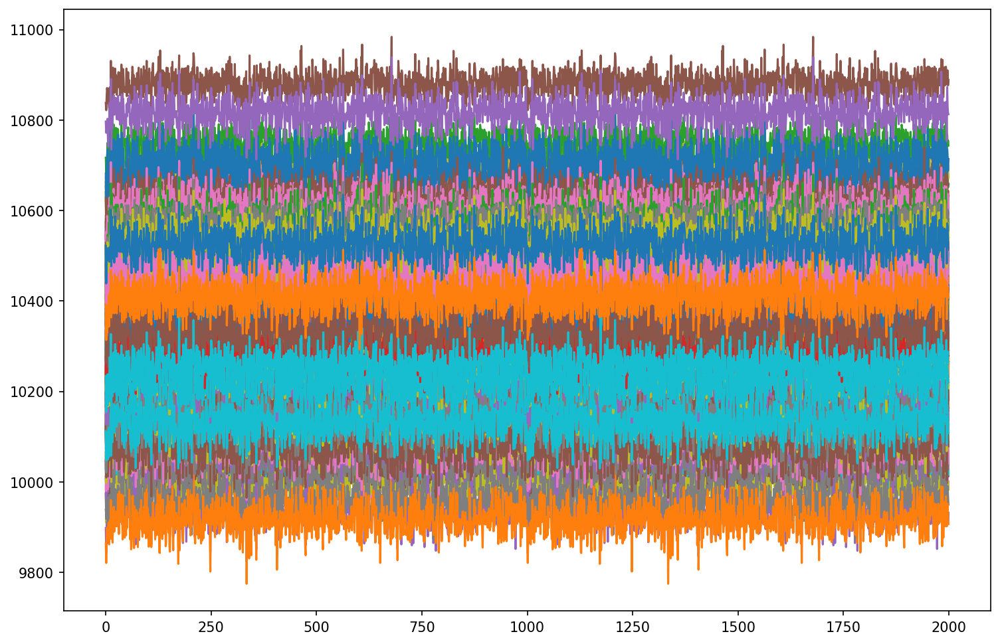

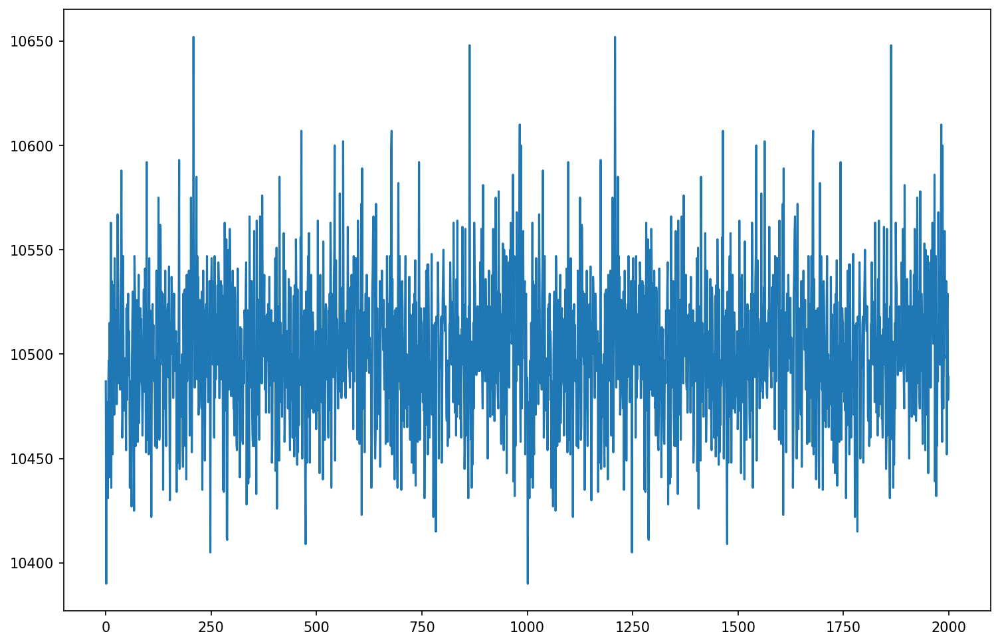

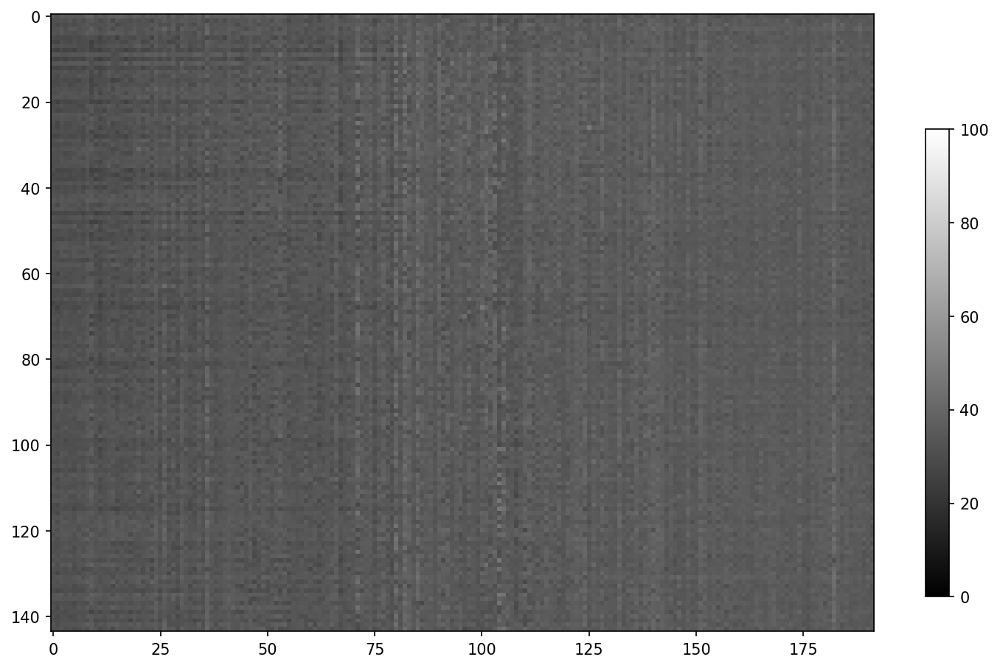

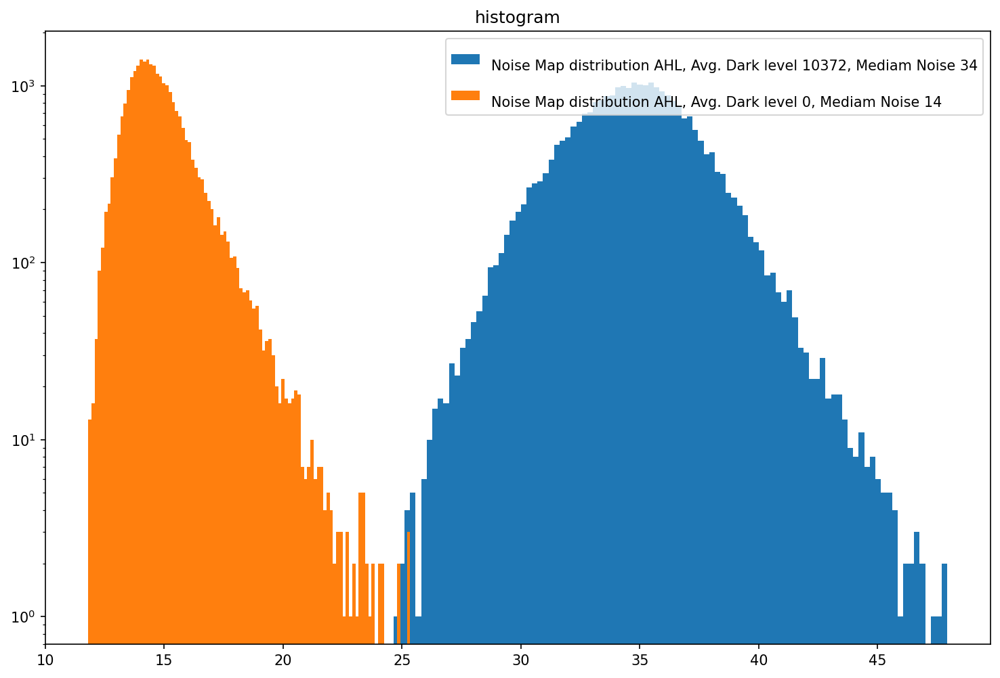

(2000, 144, 384)
(2000, 144, 192)
(2000, 144, 384)
(2000, 144, 192)


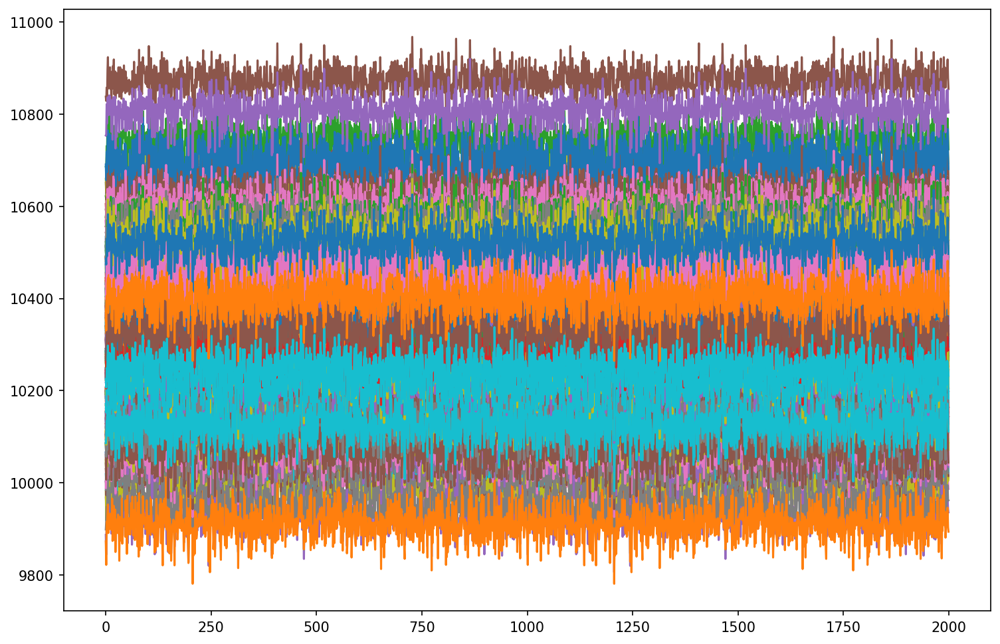

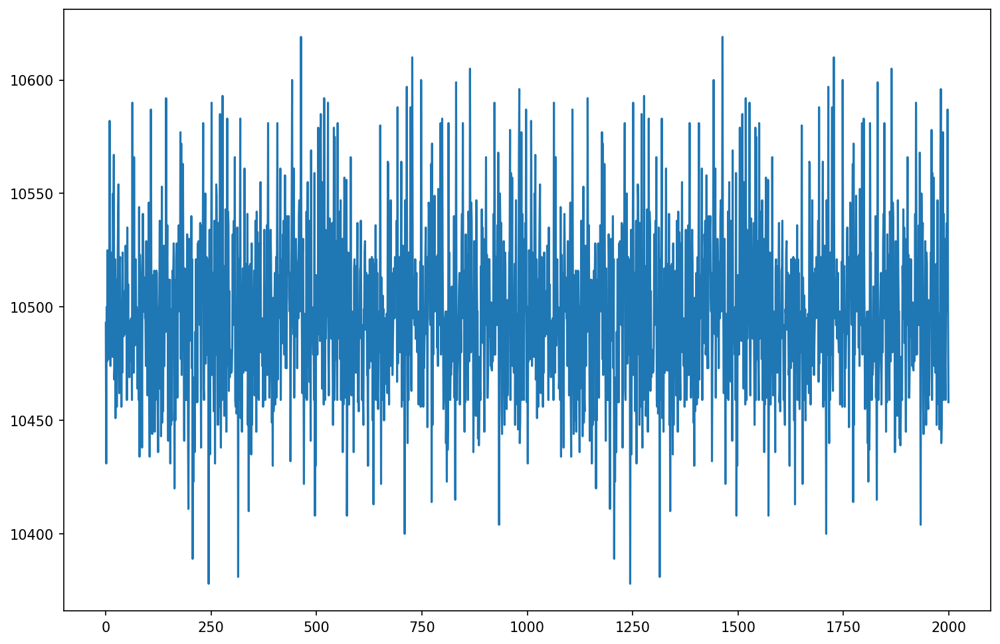

UnicodeDecodeError: 'utf-8' codec can't decode byte 0x82 in position 0: invalid start byte


In [16]:
#set manually ACQ delay to 15000, to make the same value as ACQ width
acqWidthList = [1,2,4,8,16,32,64,128]
#root.EpixHR.RegisterControl.R0Width.set(64800+15000-2400)

#Makes sure triggers are off
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.2)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(True)
time.sleep(0.2)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.2)

Preamp = 7
Vld1_b = 1
Pixel_CB= 7
Filter_DAC= 17
VRef_DAC = 58

for acqWidth in acqWidthList:
    #etPixel (Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC)
    root.EpixHR.RegisterControl.AcqWidth1.set(acqWidth*160)
    ######################################################################################################################
    # Remove previous dataset
    filename = (f'/u2/ddoering/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_%d_Vld1b_%d_PixelCB_%d_Filter_DAC_%d_VRrefdac_%d_AcqWidth_%d_us_run1.dat' % (Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC,acqWidth))
    ########################################################################################################################
    imgDesc = run_asic_test()
    ########################################################################################################################
    [noiseMap, darkAvg] = noise_print()

In [15]:
#Makes sure triggers are off
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.1)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(True)
time.sleep(0.1)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.1)

Preamp = 7
Vld1_bList = [0, 1, 2, 3]
Pixel_CB= 7
Filter_DAC= 17
VRef_DAC = 58

for Vld1_b in Vld1_bList:
    setPixel (Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC)

    ######################################################################################################################
    # Remove previous dataset
    filename = (f'/u2/ddoering/ASIC_V3_ASIC2_SB_SET_3/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_250MHz_Preamp_%d_Vld1b_%d_PixelCB_%d_Filter_DAC_%d_VRrefdac_%d_run1.dat' % (Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC))
    ########################################################################################################################
    imgDesc = run_asic_test()
    ########################################################################################################################
    [noiseMap, darkAvg] = noise_print()

Preamp 7
Vld1_b 0
Pixel_CB 7
Filter_DAC 17
VRef_DAC 58
/u2/ddoering/ASIC_V3_ASIC2_SB_SET_3/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_250MHz_Preamp_7_Vld1b_0_PixelCB_7_Filter_DAC_17_VRrefdac_58_run1.dat
Aquisition Counter 628881
Number of frames received: 1
Number of frames received: 1
Number of frames received: 1
Number of frames received: 1


KeyboardInterrupt: 

In [ ]:
#Makes sure triggers are off
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.1)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(True)
time.sleep(0.1)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.1)

Preamp = 7
Vld1_b = 0
Pixel_CBList= [7,6,5,4,3,2,1,0]
Filter_DAC= 17
VRef_DAC = 58

for Pixel_CB in Pixel_CBList:
    setPixel (Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC)

    ######################################################################################################################
    # Remove previous dataset
    filename = (f'/u2/ddoering/ASIC_V3_ASIC2_SB_SET_4//ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_%d_Vld1b_%d_PixelCB_%d_Filter_DAC_%d_VRrefdac_%d_run1.dat' % (Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC))
    ########################################################################################################################
    imgDesc = run_asic_test()
    ########################################################################################################################
    [noiseMap, darkAvg] = noise_print()

In [ ]:
#Makes sure triggers are off
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.1)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(True)
time.sleep(0.1)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.1)

Preamp = 7
Vld1_b = 1
Pixel_CB= 7
Filter_DACList=[7, 13, 15, 17, 19, 21, 27, 37, 47, 57]
VRef_DAC = 58

for Filter_DAC in Filter_DACList:
    setPixel (Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC)

    ######################################################################################################################
    # Remove previous dataset
    filename = (f'/u2/ddoering/ASIC_V3_ASIC2_SB_SET_4/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_%d_Vld1b_%d_PixelCB_%d_Filter_DAC_%d_VRrefdac_%d_run1.dat' % (Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC))
    ########################################################################################################################
    imgDesc = run_asic_test()
    ########################################################################################################################
    [noiseMap, darkAvg] = noise_print()

In [ ]:
#Makes sure triggers are off
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.1)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(True)
time.sleep(0.1)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.1)

Preamp = 7
Vld1_b = 1
Pixel_CB= 7
Filter_DAC= 17
VRef_DACList =[3, 13, 23, 33, 43, 48, 53, 58, 63]

for VRef_DAC in VRef_DACList:
    setPixel (Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC)

    ######################################################################################################################
    # Remove previous dataset
    filename = (f'/u2/ddoering/ASIC_V3_ASIC2_SB_SET_4/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_noise_320MHz_Preamp_%d_Vld1b_%d_PixelCB_%d_Filter_DAC_%d_VRrefdac_%d_run1.dat' % (Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC))
    ########################################################################################################################
    imgDesc = run_asic_test()
    ########################################################################################################################
    [noiseMap, darkAvg] = noise_print()

In [ ]:
ASIC.SetPixelBitmap('/u1/ddoering/localGitAtrdsrv304/epix-hr-single-10k/software/pixelBitMaps/allTwos.csv')

#Makes sure triggers are off
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.1)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(True)
time.sleep(0.1)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.1)

Preamp = 7
Vld1_b = 1
Pixel_CB= 7
Filter_DAC= 17
VRef_DACList =[3, 13, 23, 33, 43, 48, 53, 58, 63]

for VRef_DAC in VRef_DACList:
    setPixel (Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC)

    ######################################################################################################################
    # Remove previous dataset
    filename = (f'/u2/ddoering/ASIC_V3_ASIC2_SB_SET_4/ePixHR10kTLCLSIITiming_ASICV3_ASIC2_ADCnoise_320MHz_Preamp_%d_Vld1b_%d_PixelCB_%d_Filter_DAC_%d_VRrefdac_%d_run1.dat' % (Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC))
    ########################################################################################################################
    imgDesc = run_asic_test()
    ########################################################################################################################
    [noiseMap, darkAvg] = noise_print()

# ADC Optimizaion

In [ ]:
#Set pixels back to default value
ASIC.Preamp.set(4)
ASIC.Vld1_b.set(1)
ASIC.Pixel_CB.set(4)
ASIC.Filter_DAC.set(38)
ASIC.VRef_DAC.set(53)

print('Preamp', ASIC.Preamp.get())
print('Vld1_b',ASIC.Vld1_b.get())
print('Pixel_CB',ASIC.Pixel_CB.get())
print('Filter_DAC',ASIC.Filter_DAC.get())
print('VRef_DAC',ASIC.VRef_DAC.get())

In [ ]:
def setADC (RefGenB = 3, RefGenC = 2, S2D_1_b = 0, shvc_DAC = 23, S2dDacBias = 3):
    ASIC.RefGenB.set(RefGenB) #2 bits
    ASIC.RefGenC.set(RefGenC) #2 bits
    ASIC.S2D_1_b.set(S2D_1_b) #3 bits
    ASIC.shvc_DAC.set(shvc_DAC) #6 bits
    ASIC.S2dDacBias.set(S2dDacBias)
    
    print('RefGenB', ASIC.RefGenB.get())
    print('RefGenC',ASIC.RefGenC.get())
    print('S2D_1_b',ASIC.S2D_1_b.get())
    print('shvc_DAC',ASIC.shvc_DAC.get())
    print('S2dDacBias',ASIC.S2dDacBias.get())

In [ ]:
RefGenBList = [0, 1, 2, 3]
RefGenC = 2
S2D_1_b = 0
shvc_DAC = 23
S2dDacBias = 3
for RefGenB in RefGenBList:
    setADC (RefGenB, RefGenC, S2D_1_b, shvc_DAC, S2dDacBias)

    ######################################################################################################################
    # Remove previous dataset
    filename = (f'/u1/ddoering/ePixHR10kTLCLSIITiming_ASICV3_noise_320MHz_RefGenB_%d_All_run1.dat' % RefGenB)
    ########################################################################################################################
    imgDesc = run_asic_test()
    ########################################################################################################################
    [noiseMap, darkAvg] = noise_print()



In [ ]:
RefGenB = 3
RefGenCList = [0, 1, 2, 3]
S2D_1_b = 0
shvc_DAC = 23
S2dDacBias = 3
for RefGenC in RefGenCList:
    setADC (RefGenB, RefGenC, S2D_1_b, shvc_DAC, S2dDacBias)

    ######################################################################################################################
    # Remove previous dataset
    filename = (f'/u1/ddoering/ePixHR10kTLCLSIITiming_ASICV3_noise_320MHz_RefGenC_%d_All_run1.dat' % RefGenC)
    ########################################################################################################################
    imgDesc = run_asic_test()
    ########################################################################################################################
    [noiseMap, darkAvg] = noise_print()


In [ ]:
RefGenB = 3
RefGenC = 2
S2D_1_bList = [0, 1, 2, 3, 4, 5, 6, 7]
shvc_DAC = 23
S2dDacBias = 3
for S2D_1_b in S2D_1_bList:
    setADC (RefGenB, RefGenC, S2D_1_b, shvc_DAC, S2dDacBias)

    ######################################################################################################################
    # Remove previous dataset
    filename = (f'/u1/ddoering/ePixHR10kTLCLSIITiming_ASICV3_noise_320MHz_S2D_1_b_%d_All_run1.dat' % S2D_1_b)
    ########################################################################################################################
    imgDesc = run_asic_test()
    ########################################################################################################################
    [noiseMap, darkAvg] = noise_print()

In [ ]:
RefGenB = 3
RefGenC = 2
S2D_1_b = 0
shvc_DACList = [3, 13, 23, 33, 43, 53, 63]
S2dDacBias = 3
for shvc_DAC in shvc_DACList:
    setADC (RefGenB, RefGenC, S2D_1_b, shvc_DAC, S2dDacBias)

    ######################################################################################################################
    # Remove previous dataset
    filename = (f'/u1/ddoering/ePixHR10kTLCLSIITiming_ASICV3_noise_320MHz_shvc_DAC_%d_All_run1.dat' % shvc_DAC)
    ########################################################################################################################
    imgDesc = run_asic_test()
    ########################################################################################################################
    [noiseMap, darkAvg] = noise_print()

In [ ]:
RefGenB = 3
RefGenC = 2
S2D_1_b = 0
shvc_DAC = 23
S2dDacBiasList = [0, 1, 2, 3, 4, 5, 6, 7]
for S2dDacBias in S2dDacBiasList:
    setADC (RefGenB, RefGenC, S2D_1_b, shvc_DAC, S2dDacBias)

    ######################################################################################################################
    # Remove previous dataset
    filename = (f'/u1/ddoering/ePixHR10kTLCLSIITiming_ASICV3_noise_320MHz_S2dDacBias_%d_All_run1.dat' % S2dDacBias)
    ########################################################################################################################
    imgDesc = run_asic_test()
    ########################################################################################################################
    [noiseMap, darkAvg] = noise_print()

# Custom settings, repeat latest 10kA

In [ ]:
Preamp = 4
Vld1_b = 1
Pixel_CB= 4
Filter_DAC=17
VRef_DAC =19


setPixel (Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC)

######################################################################################################################
# Remove previous dataset
filename = (f'/u1/ddoering/ePixHR10kTLCLSIITiming_ASICV3_noise_320MHz_10ka_settings_All_run1.dat')
########################################################################################################################
imgDesc = run_asic_test()
########################################################################################################################
[noiseMap, darkAvg] = noise_print()


In [ ]:
Preamp = 6
Vld1_b = 1
Pixel_CB= 4
Filter_DAC=17
VRef_DAC =53


setPixel (Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC)

######################################################################################################################
# Remove previous dataset
filename = (f'/u1/ddoering/ePixHR10kTLCLSIITiming_ASICV3_noise_320MHz_10ka_settings_Preamp_%d_VrefDAC_%d_All_run1.dat' % (Preamp , VRef_DAC))
########################################################################################################################
imgDesc = run_asic_test()
########################################################################################################################
[noiseMap, darkAvg] = noise_print()